Librerias que se utilizaran en las etapas de : Compresion de Datos y Preparacion de datos

In [2]:
#Librerias que se usaran
import pandas as pd  # Libreria para administrar tablas, y realizar trabajos con distintas formas de tablas o dataframes
import numpy as np   # Libreria para poder hacer operaciones matematicas y matriciales
import matplotlib.pyplot as plt # Libreria para realizar graficos 
from tabulate import tabulate   # Permite formatear y mostrar de mejor manera los datos tabulares
import seaborn as sns  # Libreria para realizar graficos y vizualizaciones
import psycopg2        # Libreria que permite la conexion con PostgresSQL
from matplotlib.backends.backend_pdf import PdfPages # Libreria que permite exportar graficos en pdf

Establecemos la conexion con el servidor de Azure, y extraemos datos de Posgresql, que utilizaremos en el analisis

In [3]:
# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Establecer la conexión a la base de datos
try:
    connection = psycopg2.connect(
        host=host,
        database=database,
        user=user,
        password=password
    )

    # Crear un cursor para ejecutar comandos SQL
    cursor = connection.cursor()

    # Establecer la zona horaria antes de ejecutar la consulta
    time_zone_query = "SET TIME ZONE 'America/Lima';"
    cursor.execute(time_zone_query)

    # Tu consulta SQL
    tu_query_sql = '''
select z.* from (select distinct a.id id_ciclo_acarreo, a.id_cargadescarga, a.id_palas, a.id_equipo id_equipo_camion,  
m.id_ciclo_carguio,	m.id_equipo_carguio , m.id_trabajador id_trabajador_pala, m.id_crew id_guardia_realiza_carga_al_camion,
m.id_locacion id_locacion, 
m.id_poligono id_poligono_se_obtiene_material, m.tiempo_inicio_carga_carguio, m.tiempo_esperando_carguio, 
m.tiempo_ready_cargando tiempo_ready_cargando_pala, m.tiempo_ready_esperando tiempo_ready_esperando_pala,
m.previous_esperando_pala, m.isspot termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio, m.bool_estado cambio_estado_operatividad_carguio,
m.bool_equipo_next tiene_camion_cuadrado_al_termino_carga_pala, m.cola cantidad_equipos_espera_al_termino_carga_pala,
s.id_estados id_estados_camion, s.id_equipo id_equipo_table_estados_camion, s.id_detal_estado id_detal_estado_camion, s.tiempo_inicio_cambio_estado tiempo_inicio_cambio_estado_camion,
s.tiempo_estimado_duracion_estado tiempo_estimado_duracion_estado_camion,
s.en_campo_o_taller_mantenimiento en_campo_o_taller_mantenimiento_camion, s.tipoubicacionsupervisor tipoubicacionsupervisor_camion,
s.id_tipo_estad id_tipo_estad_camion, s.estado_detalle estado_detalle_camion, s.estado_secundario estado_secundario_camion, 				 
s.estado_primario estado_primario_camion,
ss.id_estados id_estados_pala, ss.id_equipo id_equipo_table_estados_pala, ss.id_detal_estado id_detal_estado_pala, 
ss.tiempo_inicio_cambio_estado tiempo_inicio_cambio_estado_pala, ss.tiempo_estimado_duracion_estado tiempo_estimado_duracion_estado_pala,
ss.en_campo_o_taller_mantenimiento en_campo_o_taller_mantenimiento_pala, ss.tipoubicacionsupervisor tipoubicacionsupervisor_pala, 
ss.id_tipo_estad id_tipo_estad_pala, ss.estado_detalle estado_detalle_pala, ss.estado_secundario estado_secundario_pala, 				 
ss.estado_primario estado_primario_pala,
a.id_descarga, a.id_factor, m.id_poligono, a.tiem_llegada tiem_llegada_global, a.tiem_esperando, a.tiem_cuadra, a.tiem_cuadrado,
a.tiem_carga, a.tiem_acarreo, a.tiem_cola, a.tiem_retro, a.tiem_listo,a.tiem_descarga, a.tiem_viajando, 
getreadytime(a.id_equipo, a.tiem_llegada, a.tiem_esperando) tiempo_ready_llegada_esperando,
getreadytime(a.id_equipo, a.tiem_esperando, a.tiem_cuadra) tiempo_ready_esperando_cuadra,
getreadytime(a.id_equipo, a.tiem_cuadra, a.tiem_cuadrado) tiempo_ready_cuadra_cuadrado,
getreadytime(a.id_equipo, a.tiem_cuadrado, a.tiem_carga) tiempo_ready_cuadrado_cargado,
getreadytime(a.id_equipo, a.tiem_carga, a.tiem_acarreo) tiempo_ready_carga_acarreo,
getreadytime(a.id_equipo, a.tiem_acarreo, a.tiem_cola) tiempo_ready_acarreo_cola,
getreadytime(a.id_equipo, a.tiem_cola, a.tiem_retro) tiempo_ready_cola_retro,
getreadytime(a.id_equipo, a.tiem_retro, a.tiem_listo) tiempo_ready_retro_listo,
getreadytime(a.id_equipo, a.tiem_listo, a.tiem_descarga) tiempo_ready_listo_descarga,
getreadytime(a.id_equipo, a.tiem_descarga, a.tiem_viajando) tiempo_ready_descarga_viajandovacio,
a.id_trabajador id_trabajador_camion, a.id_palanext, a.tonelaje, a.tonelajevims, 
a.id_mezcla, a.yn_estado, a.yn_operador, a.id_crewcarga id_guardia_hizocarga, a.id_crewdescarga id_guardia_hizodescarga,  
b.id_zona id_zona_aplicafactor, o.id_zona id_zona_pertenece_poligono, b.factor,
(a.tonelajevims/10) * (b.factor/1000) toneladas_secas,
(a.tonelajevims / 10.0) / NULLIF(((getreadytime(a.id_equipo, a.tiem_llegada, a.tiem_esperando) + 
		getreadytime(a.id_equipo, a.tiem_esperando, a.tiem_cuadra) +
        getreadytime(a.id_equipo, a.tiem_cuadra, a.tiem_cuadrado) +
        getreadytime(a.id_equipo, a.tiem_cuadrado, a.tiem_carga) +
        getreadytime(a.id_equipo, a.tiem_carga, a.tiem_acarreo) +
        getreadytime(a.id_equipo, a.tiem_acarreo, a.tiem_cola) +
        getreadytime(a.id_equipo, a.tiem_cola, a.tiem_retro) +
        getreadytime(a.id_equipo, a.tiem_retro, a.tiem_listo) +
        getreadytime(a.id_equipo, a.tiem_listo, a.tiem_descarga) +
        getreadytime(a.id_equipo, a.tiem_descarga, a.tiem_viajando)) / 3600), 0)  productividad_operativa_acarreo_tn_h,
(a.tonelajevims / 10.0) / NULLIF(((m.tiempo_ready_cargando + m.tiempo_ready_esperando) / 3600), 0)  productividad_operativa_carguio_tn_h,			 		 
a.efhcargado, a.efhvacio, a.distrealcargado, a.distrealvacio, a.coorxdesc, a.coorydesc, a.coorzdesc, 
a.tipodescargaidentifier, a.tonelajevvanterior, a.tonelajevvposterior, a.dumpreal, a.loadreal, a.velocidadvimscargado,
a.velocidadvimsvacio, a.velocidadgpscargado, a.velocidadgpsvacio, a.tonelajevimsretain, a.nivelcombuscargado, a.nivelcombusdescargado,
a.volumen, a.aplicafactor_vol, a.coorzniveldescarga,
a.efh_factor_loaded, a.efh_factor_empty,f.nombre_equipo, f.id_secundario, f.secundario flota_secundaria, f.id_principal, f.principal flota_principal,
f.capacidad_vol capacidad_vol_equipo, f.capacidad_pes capacidad_pes_equipo, f.capacidadtanque capacidadtanque_equipo, 
f.fcorrec_efhod fcorrec_efhod_equipo, f.fcorrec_efhdo fcorrec_efhdo_equipo, f.pesobruto peso_bruto_equipo, f.ishp ishp_equipo,
f.ancho ancho_equipo, f.largo largo_equipo, f.numeroejes numeroejes_equipo, f.tipoespecial tipoespecial_equipo, 
f.radiohexagonoequipo radiohexagonoequipo_equipo, f.radiohexagonocuchara radiohexagonocuchara_equipo, 
ff.nombre_equipo nombre_equipo_carguio,
ff.capacidad_vol capacidad_vol_equipo_carguio, ff.capacidad_pes capacidad_pes_equipo_carguio, ff.capacidadtanque capacidadtanque_equipo_carguio, 
ff.radiohexagonoequipo radiohexagonoequipo_carguio, ff.radiohexagonocuchara radiohexagonocuchara_equipo_carguio, 
g.id_turnos id_turnos_turnocarga, g.nombre nombre_turnocarga, g.horaini horaini_turnocarga, g.horafin horafin_turnocarga,
h.id_turnos id_turnos_turnodescarga, h.nombre nombre_turnodescarga, h.horaini horaini_turnodescarga, h.horafin horafin_turnodescarga,
j.id_tajo id_zona_encuentra_descarga, n.id_nodo id_nodo_carga, p.nombre_nodo nombre_nodo_carga, p.idzona id_zona_nodo_carga,
j.id_nodo id_nodo_descarga, q.nombre_nodo nombre_nodo_descarga, q.idzona id_zona_nodo_descarga, j.nivel elevacion_descarga, 
j.nombre nombre_descarga, n.nombre nombre_carga_locacion, n.nivel nivel_elevacion_locacion_mts, n.radio radio_locacion, 
n.poligono_ids ids_poligonos_en_locacion, o.id_material, o.nombre nombre_poligono, o.nivel elevacion_poligono_mts, o.ley_in, 
o.densidad densidad_poligono, o.tonelaje_inicial tonelaje_inicial_poligono,
t.id id_pases, 	t.id_palas id_palas_pases, 	t.id_cargadescarga id_cargadescarga_pases, t.coord_x 	coord_x_pases,
t.coord_y coord_y_pases, t.coord_z coord_z_pases, t.angulo_giro angulo_giro_pases, t.tonelaje tonelaje_pases, 
t.duracion_excavacion duracion_excavacion_pases, t.angulo_giro_promedio angulo_giro_promedio_pases, t.has_block, has_block_pases,
w.id id_guardia_acarreocarga, w.id_guardias id_guardias_acarreocarga, w.nombre nombre_guardia_acarreocarga,
x.id id_guardia_acarreodescarga, x.id_guardias id_guardias_acarreodescarga, x.nombre nombre_guardia_acarreodescarga, 
y.id id_guardia_carguio, y.id_guardias id_guardias_carguio, y.nombre nombre_guardia_carguio, 
ROW_NUMBER() OVER (PARTITION BY a.id ORDER BY a.id DESC) AS RowNum
from public.tp_cargadescarga a
left join public.ta_factortonelaje b
on a.id_factor = b.id
left join (select d.id_principal, d.principal, d.id_secundario, d.secundario, c.id id_equipo, c.nombre nombre_equipo, c.capacidad_vol,
c.capacidad_pes, c.capacidadtanque, c.fcorrec_efhod, c.fcorrec_efhdo, c.pesobruto, c.ishp, c.ancho, c.largo,
c.numeroejes, c.anho, c.tipoespecial, c.radiohexagonoequipo, c.radiohexagonocuchara
from public.ts_equipos c
inner join (select b.id id_principal , b.nombre principal, a.id id_secundario , a.nombre secundario from public.ts_equipos a
inner join (select id, nombre from public.ts_equipos where id_flota = 0 and tiem_elimin is null) b
on b.id = a.id_flota
where a.tiem_elimin is null) d
on d.id_secundario = c.id_flota
where c.id_flota <> 0 and c.isflota = false and c.tiem_elimin is null
order by d.id_principal) f
on a.id_equipo = f.id_equipo
left join (select id, id_turnos, nombre, horaini, horafin from public.ts_turnos
where tiem_elimin is null) g
on a.id_turnocarga = g.id
left join (select id, id_turnos, nombre, horaini, horafin from public.ts_turnos
where tiem_elimin is null) h
on a.id_turnodescarga = h.id
left join public.ts_descarga j 
on a.id_descarga = j.id
left join (
SELECT tp.id id_ciclo_carguio, tp.id_palas, tp.id_equipo as id_equipo_carguio, 
tp.id_locacion, 
tp.id_poligono, tp.id_trabajador, tp.id_crew, tp.isspot, tp.bool_estado, tp.bool_equipo_next, tp.cola, 
tcd1.tiem_carga as tiempo_inicio_carga_carguio,
tcd1.tiem_acarreo as tiempo_esperando_carguio,
getreadytime( tp.id_equipo, tcd1.tiem_carga, tcd1.tiem_acarreo) tiempo_ready_cargando,
getreadytime( tp.id_equipo, 
			 lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga), 
			 tcd1.tiem_carga) tiempo_ready_esperando,
lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga) AS previous_esperando_pala,
tcd1.tiem_acarreo,
tcd1.tiem_carga
--tcd1.*
FROM tp_cargadescarga tcd1
LEFT JOIN tp_palas tp ON tp.id = (SELECT id 
						  FROM tp_palas 
						 	WHERE id_palas = tcd1.id_palas
						 	ORDER BY ID DESC LIMIT 1)
WHERE tcd1.tiem_elimin IS NULL
AND tcd1.tiem_viajando IS NOT NULL
and tp.tiem_elimin IS NULL and tcd1.tiem_carga > CAST('2022-01-01' AS DATE)) m
on a.id_palas = m.id_palas
left join public.ts_locacion n
on m.id_locacion = n.id
left join public.ts_poligono o
on m.id_poligono = o.id
left join (select * from public.tp_nodos
where loc_carga = 'true' and tiem_elimin is null) p
on n.id_nodo = p.id --id_nodo
left join (select * from public.tp_nodos
where loc_descarga = 'true' and tiem_elimin is null) q
on j.id_nodo = q.id				 
left join (select d.id_principal, d.principal, d.id_secundario, d.secundario, c.id id_equipo, c.nombre nombre_equipo, c.capacidad_vol,
c.capacidad_pes, c.capacidadtanque, c.fcorrec_efhod, c.fcorrec_efhdo, c.pesobruto, c.ishp, c.ancho, c.largo,
c.numeroejes, c.anho, c.tipoespecial, c.radiohexagonoequipo, c.radiohexagonocuchara
from public.ts_equipos c
inner join (select b.id id_principal , b.nombre principal, a.id id_secundario , a.nombre secundario from public.ts_equipos a
inner join (select id, nombre from public.ts_equipos where id_flota = 0 and tiem_elimin is null) b
on b.id = a.id_flota
where a.tiem_elimin is null) d
on d.id_secundario = c.id_flota
where c.id_flota <> 0 and c.isflota = false and c.tiem_elimin is null
order by d.id_principal) ff
on m.id_equipo_carguio = ff.id_equipo		 
left join (select z.* from
    (select A.id, A.id_estados, A.id_equipo, A.id_detal_estado, A.tiempo_inicio tiempo_inicio_cambio_estado,
    A.tiempo_estimado tiempo_estimado_duracion_estado, A.idenestado en_campo_o_taller_mantenimiento,
    A.tipoubicacionsupervisor,
    B.id_tipo_estad, B.nombre as estado_detalle,
    (select nombre from public.ts_detal_estado where id=B.id_tipo_estad limit 1) as estado_secundario, 
    (select nombre from public.ts_detal_estado where id = (select id_tipo_estad from public.ts_detal_estado where id=B.id_tipo_estad limit 1) limit 1) as estado_primario,
    ROW_NUMBER() OVER (PARTITION BY A.id_equipo ORDER BY A.id_equipo) AS row_num
    from public.tp_estados A
    left join public.ts_detal_estado B on A.id_detal_estado = B.id_detal_estado
    --left join (select * from public.ts_detal_estado where id=B.id_tipo_estad limit 1) C on true
    where A.tiem_elimin is null) z
    WHERE
    z.row_num = 1) s
on a.id_equipo = s.id_equipo
left join (select z.* from
    (select A.id, A.id_estados, A.id_equipo, A.id_detal_estado, A.tiempo_inicio tiempo_inicio_cambio_estado,
    A.tiempo_estimado tiempo_estimado_duracion_estado, A.idenestado en_campo_o_taller_mantenimiento,
    A.tipoubicacionsupervisor,
    B.id_tipo_estad, B.nombre as estado_detalle,
    (select nombre from public.ts_detal_estado where id=B.id_tipo_estad limit 1) as estado_secundario, 
    (select nombre from public.ts_detal_estado where id = (select id_tipo_estad from public.ts_detal_estado where id=B.id_tipo_estad limit 1) limit 1) as estado_primario,
    ROW_NUMBER() OVER (PARTITION BY A.id_equipo ORDER BY A.id_equipo) AS row_num
    from public.tp_estados A
    left join public.ts_detal_estado B on A.id_detal_estado = B.id_detal_estado
    --left join (select * from public.ts_detal_estado where id=B.id_tipo_estad limit 1) C on true
    where A.tiem_elimin is null) z
    WHERE
    z.row_num = 1) ss
on m.id_equipo_carguio = ss.id_equipo
left join (select * from public.ta_datacarga_sensores 
where tiem_elimin is NULL) t
on a.id_cargadescarga = t.id_cargadescarga
left join (select * from public.ta_guardias) w
on a.id_crewcarga = w.id
left join (select * from public.ta_guardias) x
on a.id_crewdescarga = x.id
left join (select * from public.ta_guardias) y
on m.id_crew = y.id
where a.tiem_elimin is null and a.tiem_llegada > CAST('2022-01-01' AS DATE) and b.factor is not null and g.id_turnos= 1 and h.id_turnos = 1) z
where z.RowNum = 1
    '''

    # Ejecutar la consulta
    cursor.execute(tu_query_sql)

    # Obtener los resultados en un DataFrame de pandas
    resultados_df = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

    # Cerrar el cursor y la conexión
    cursor.close()
    connection.close()

    # Hacer lo que necesites con los resultados
    print(resultados_df.head())

except psycopg2.Error as e:
    print("Error al conectar a la base de datos PostgreSQL:", e)

   id_ciclo_acarreo  id_cargadescarga  id_palas  id_equipo_camion  \
0            960922            960922   1087946                42   
1            960923            960923   1087947                39   
2            960924            960924   1087948                56   
3            960925            960925   1087949                39   
4            960926            960926   1087950                42   

   id_ciclo_carguio  id_equipo_carguio  id_trabajador_pala  \
0         1087946.0               74.0                 0.0   
1         1087947.0               73.0               209.0   
2         1087948.0               74.0                 0.0   
3         1087949.0               73.0               209.0   
4         1087950.0               74.0                 0.0   

   id_guardia_realiza_carga_al_camion  id_locacion  \
0                                13.0      14622.0   
1                                13.0      14661.0   
2                                13.0      14622.0

Una vez que se hayan extraido los datos del BD Postgresql, se considera una buena practica guardar los datos 
en un archivo plano con un .csv para que la carga se mas rapida posteriormente

In [6]:
#Se guardaron los datos que fueron traidos de AZURE POSTGRESS
#resultados_df.to_csv('datos_turno1_vf.csv', index=False)

In [1]:
import psycopg2
import pandas as pd

# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Definir las consultas SQL para cada turno
consultas_sql = [
    '''
    -- Consulta para el turno 1
    select z.* from (select distinct a.id id_ciclo_acarreo, a.id_cargadescarga, a.id_palas, a.id_equipo id_equipo_camion,  
m.id_ciclo_carguio,	m.id_equipo_carguio , m.id_trabajador id_trabajador_pala, m.id_crew id_guardia_realiza_carga_al_camion,
m.id_locacion id_locacion, 
m.id_poligono id_poligono_se_obtiene_material, m.tiempo_inicio_carga_carguio, m.tiempo_esperando_carguio, 
m.tiempo_ready_cargando tiempo_ready_cargando_pala, m.tiempo_ready_esperando tiempo_ready_esperando_pala,
m.previous_esperando_pala, m.isspot termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio, m.bool_estado cambio_estado_operatividad_carguio,
m.bool_equipo_next tiene_camion_cuadrado_al_termino_carga_pala, m.cola cantidad_equipos_espera_al_termino_carga_pala,
s.id_estados id_estados_camion, s.id_equipo id_equipo_table_estados_camion, s.id_detal_estado id_detal_estado_camion, s.tiempo_inicio_cambio_estado tiempo_inicio_cambio_estado_camion,
s.tiempo_estimado_duracion_estado tiempo_estimado_duracion_estado_camion,
s.en_campo_o_taller_mantenimiento en_campo_o_taller_mantenimiento_camion, s.tipoubicacionsupervisor tipoubicacionsupervisor_camion,
s.id_tipo_estad id_tipo_estad_camion, s.estado_detalle estado_detalle_camion, s.estado_secundario estado_secundario_camion, 				 
s.estado_primario estado_primario_camion,
ss.id_estados id_estados_pala, ss.id_equipo id_equipo_table_estados_pala, ss.id_detal_estado id_detal_estado_pala, 
ss.tiempo_inicio_cambio_estado tiempo_inicio_cambio_estado_pala, ss.tiempo_estimado_duracion_estado tiempo_estimado_duracion_estado_pala,
ss.en_campo_o_taller_mantenimiento en_campo_o_taller_mantenimiento_pala, ss.tipoubicacionsupervisor tipoubicacionsupervisor_pala, 
ss.id_tipo_estad id_tipo_estad_pala, ss.estado_detalle estado_detalle_pala, ss.estado_secundario estado_secundario_pala, 				 
ss.estado_primario estado_primario_pala,
a.id_descarga, a.id_factor, m.id_poligono, a.tiem_llegada, a.tiem_esperando, a.tiem_cuadra, a.tiem_cuadrado,
a.tiem_carga, a.tiem_acarreo, a.tiem_cola, a.tiem_retro, a.tiem_listo,a.tiem_descarga, a.tiem_viajando, 
getreadytime(a.id_equipo, a.tiem_llegada, a.tiem_esperando) tiempo_ready_llegada_esperando,
getreadytime(a.id_equipo, a.tiem_esperando, a.tiem_cuadra) tiempo_ready_esperando_cuadra,
getreadytime(a.id_equipo, a.tiem_cuadra, a.tiem_cuadrado) tiempo_ready_cuadra_cuadrado,
getreadytime(a.id_equipo, a.tiem_cuadrado, a.tiem_carga) tiempo_ready_cuadrado_cargado,
getreadytime(a.id_equipo, a.tiem_carga, a.tiem_acarreo) tiempo_ready_carga_acarreo,
getreadytime(a.id_equipo, a.tiem_acarreo, a.tiem_cola) tiempo_ready_acarreo_cola,
getreadytime(a.id_equipo, a.tiem_cola, a.tiem_retro) tiempo_ready_cola_retro,
getreadytime(a.id_equipo, a.tiem_retro, a.tiem_listo) tiempo_ready_retro_listo,
getreadytime(a.id_equipo, a.tiem_listo, a.tiem_descarga) tiempo_ready_listo_descarga,
getreadytime(a.id_equipo, a.tiem_descarga, a.tiem_viajando) tiempo_ready_descarga_viajandovacio,
a.id_trabajador id_trabajador_camion, a.id_palanext, a.tonelaje, a.tonelajevims, 
a.id_mezcla, a.yn_estado, a.yn_operador, a.id_crewcarga id_guardia_hizocarga, a.id_crewdescarga id_guardia_hizodescarga,  
b.id_zona id_zona_aplicafactor, o.id_zona id_zona_pertenece_poligono, b.factor,
(a.tonelajevims/10) * (b.factor/1000) toneladas_secas,
(a.tonelajevims / 10.0) / NULLIF(((getreadytime(a.id_equipo, a.tiem_llegada, a.tiem_esperando) + 
		getreadytime(a.id_equipo, a.tiem_esperando, a.tiem_cuadra) +
        getreadytime(a.id_equipo, a.tiem_cuadra, a.tiem_cuadrado) +
        getreadytime(a.id_equipo, a.tiem_cuadrado, a.tiem_carga) +
        getreadytime(a.id_equipo, a.tiem_carga, a.tiem_acarreo) +
        getreadytime(a.id_equipo, a.tiem_acarreo, a.tiem_cola) +
        getreadytime(a.id_equipo, a.tiem_cola, a.tiem_retro) +
        getreadytime(a.id_equipo, a.tiem_retro, a.tiem_listo) +
        getreadytime(a.id_equipo, a.tiem_listo, a.tiem_descarga) +
        getreadytime(a.id_equipo, a.tiem_descarga, a.tiem_viajando)) / 3600), 0)  productividad_operativa_acarreo_tn_h,
(a.tonelajevims / 10.0) / NULLIF(((m.tiempo_ready_cargando + m.tiempo_ready_esperando) / 3600), 0)  productividad_operativa_carguio_tn_h,			 		 
a.efhcargado, a.efhvacio, a.distrealcargado, a.distrealvacio, a.coorxdesc, a.coorydesc, a.coorzdesc, 
a.tipodescargaidentifier, a.tonelajevvanterior, a.tonelajevvposterior, a.dumpreal, a.loadreal, a.velocidadvimscargado,
a.velocidadvimsvacio, a.velocidadgpscargado, a.velocidadgpsvacio, a.tonelajevimsretain, a.nivelcombuscargado, a.nivelcombusdescargado,
a.volumen, a.aplicafactor_vol, a.coorzniveldescarga, --a.id_turnocarga, a.id_turnodescarga, 
a.efh_factor_loaded, a.efh_factor_empty,f.nombre_equipo, f.id_secundario, f.secundario flota_secundaria, f.id_principal, f.principal flota_principal,--f.id_equipo id_equipo_seguntabla
f.capacidad_vol capacidad_vol_equipo, f.capacidad_pes capacidad_pes_equipo, f.capacidadtanque capacidadtanque_equipo, 
f.fcorrec_efhod fcorrec_efhod_equipo, f.fcorrec_efhdo fcorrec_efhdo_equipo, f.pesobruto peso_bruto_equipo, f.ishp ishp_equipo,
f.ancho ancho_equipo, f.largo largo_equipo, f.numeroejes numeroejes_equipo, f.tipoespecial tipoespecial_equipo, 
f.radiohexagonoequipo radiohexagonoequipo_equipo, f.radiohexagonocuchara radiohexagonocuchara_equipo, 
ff.id_equipo id_equipo_carguio, ff.nombre_equipo nombre_equipo_carguio,
ff.capacidad_vol capacidad_vol_equipo_carguio, ff.capacidad_pes capacidad_pes_equipo_carguio, ff.capacidadtanque capacidadtanque_equipo_carguio, 
ff.radiohexagonoequipo radiohexagonoequipo_carguio, ff.radiohexagonocuchara radiohexagonocuchara_equipo_carguio, 
g.id_turnos id_turnos_turnocarga, g.nombre nombre_turnocarga, g.horaini horaini_turnocarga, g.horafin horafin_turnocarga,
h.id_turnos id_turnos_turnodescarga, h.nombre nombre_turnodescarga, h.horaini horaini_turnodescarga, h.horafin horafin_turnodescarga,
j.id_descarga, j.id_tajo id_zona_encuentra_descarga, n.id_nodo id_nodo_carga, p.nombre_nodo nombre_nodo_carga, p.idzona id_zona_nodo_carga,
j.id_nodo id_nodo_descarga, q.nombre_nodo nombre_nodo_descarga, q.idzona id_zona_nodo_descarga, j.id_mezcla, j.nivel elevacion_descarga, 
j.nombre nombre_descarga, n.nombre nombre_carga_locacion, n.nivel nivel_elevacion_locacion_mts, n.radio radio_locacion, 
n.poligono_ids ids_poligonos_en_locacion, o.id_material, o.nombre nombre_poligono, o.nivel elevacion_poligono_mts, o.ley_in, 
o.densidad densidad_poligono, o.tonelaje_inicial tonelaje_inicial_poligono,
t.id id_pases, 	t.id_palas id_palas_pases, 	t.id_cargadescarga id_cargadescarga_pases, t.coord_x 	coord_x_pases,
t.coord_y coord_y_pases, t.coord_z coord_z_pases, t.angulo_giro angulo_giro_pases, t.tonelaje tonelaje_pases, 
t.duracion_excavacion duracion_excavacion_pases, t.angulo_giro_promedio angulo_giro_promedio_pases, t.has_block has_block_pases,
w.id id_guardia_acarreocarga, w.id_guardias id_guardias_acarreocarga, w.nombre nombre_guardia_acarreocarga,
x.id id_guardia_acarreodescarga, x.id_guardias id_guardias_acarreodescarga, x.nombre nombre_guardia_acarreodescarga, 
y.id id_guardia_carguio, y.id_guardias id_guardias_carguio, y.nombre nombre_guardia_carguio, 
ROW_NUMBER() OVER (PARTITION BY a.id ORDER BY a.id DESC) AS RowNum
from public.tp_cargadescarga a
left join public.ta_factortonelaje b
on a.id_factor = b.id
left join (select d.id_principal, d.principal, d.id_secundario, d.secundario, c.id id_equipo, c.nombre nombre_equipo, c.capacidad_vol,
c.capacidad_pes, c.capacidadtanque, c.fcorrec_efhod, c.fcorrec_efhdo, c.pesobruto, c.ishp, c.ancho, c.largo,
c.numeroejes, c.anho, c.tipoespecial, c.radiohexagonoequipo, c.radiohexagonocuchara
from public.ts_equipos c
inner join (select b.id id_principal , b.nombre principal, a.id id_secundario , a.nombre secundario from public.ts_equipos a
inner join (select id, nombre from public.ts_equipos where id_flota = 0 and tiem_elimin is null) b
on b.id = a.id_flota
where a.tiem_elimin is null) d
on d.id_secundario = c.id_flota
where c.id_flota <> 0 and c.isflota = false and c.tiem_elimin is null
order by d.id_principal) f
on a.id_equipo = f.id_equipo
left join (select id, id_turnos, nombre, horaini, horafin from public.ts_turnos
where tiem_elimin is null) g
on a.id_turnocarga = g.id
left join (select id, id_turnos, nombre, horaini, horafin from public.ts_turnos
where tiem_elimin is null) h
on a.id_turnodescarga = h.id
left join public.ts_descarga j 
on a.id_descarga = j.id
left join (
SELECT tp.id id_ciclo_carguio, tp.id_palas, tp.id_equipo as id_equipo_carguio, 
tp.id_locacion, 
tp.id_poligono, tp.id_trabajador, tp.id_crew, tp.isspot, tp.bool_estado, tp.bool_equipo_next, tp.cola, 
tcd1.tiem_carga as tiempo_inicio_carga_carguio,
tcd1.tiem_acarreo as tiempo_esperando_carguio,
getreadytime( tp.id_equipo, tcd1.tiem_carga, tcd1.tiem_acarreo) tiempo_ready_cargando,
getreadytime( tp.id_equipo, 
			 lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga), 
			 tcd1.tiem_carga) tiempo_ready_esperando,
lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga) AS previous_esperando_pala,
tcd1.tiem_acarreo,
tcd1.tiem_carga
--tcd1.*
FROM tp_cargadescarga tcd1
LEFT JOIN tp_palas tp ON tp.id = (SELECT id 
						  FROM tp_palas 
						 	WHERE id_palas = tcd1.id_palas
						 	ORDER BY ID DESC LIMIT 1)
WHERE tcd1.tiem_elimin IS NULL
AND tcd1.tiem_viajando IS NOT NULL
and tp.tiem_elimin IS NULL and tcd1.tiem_carga > CAST('2022-01-01' AS DATE)) m
on a.id_palas = m.id_palas
left join public.ts_locacion n
on m.id_locacion = n.id
left join public.ts_poligono o
on m.id_poligono = o.id
left join (select * from public.tp_nodos
where loc_carga = 'true' and tiem_elimin is null) p
on n.id_nodo = p.id --id_nodo
left join (select * from public.tp_nodos
where loc_descarga = 'true' and tiem_elimin is null) q
on j.id_nodo = q.id				 
left join (select d.id_principal, d.principal, d.id_secundario, d.secundario, c.id id_equipo, c.nombre nombre_equipo, c.capacidad_vol,
c.capacidad_pes, c.capacidadtanque, c.fcorrec_efhod, c.fcorrec_efhdo, c.pesobruto, c.ishp, c.ancho, c.largo,
c.numeroejes, c.anho, c.tipoespecial, c.radiohexagonoequipo, c.radiohexagonocuchara
from public.ts_equipos c
inner join (select b.id id_principal , b.nombre principal, a.id id_secundario , a.nombre secundario from public.ts_equipos a
inner join (select id, nombre from public.ts_equipos where id_flota = 0 and tiem_elimin is null) b
on b.id = a.id_flota
where a.tiem_elimin is null) d
on d.id_secundario = c.id_flota
where c.id_flota <> 0 and c.isflota = false and c.tiem_elimin is null
order by d.id_principal) ff
on m.id_equipo_carguio = ff.id_equipo		 
left join (select z.* from
    (select A.id, A.id_estados, A.id_equipo, A.id_detal_estado, A.tiempo_inicio tiempo_inicio_cambio_estado,
    A.tiempo_estimado tiempo_estimado_duracion_estado, A.idenestado en_campo_o_taller_mantenimiento,
    A.tipoubicacionsupervisor,
    B.id_tipo_estad, B.nombre as estado_detalle,
    (select nombre from public.ts_detal_estado where id=B.id_tipo_estad limit 1) as estado_secundario, 
    (select nombre from public.ts_detal_estado where id = (select id_tipo_estad from public.ts_detal_estado where id=B.id_tipo_estad limit 1) limit 1) as estado_primario,
    ROW_NUMBER() OVER (PARTITION BY A.id_equipo ORDER BY A.id_equipo) AS row_num
    from public.tp_estados A
    left join public.ts_detal_estado B on A.id_detal_estado = B.id_detal_estado
    --left join (select * from public.ts_detal_estado where id=B.id_tipo_estad limit 1) C on true
    where A.tiem_elimin is null) z
    WHERE
    z.row_num = 1) s
on a.id_equipo = s.id_equipo
left join (select z.* from
    (select A.id, A.id_estados, A.id_equipo, A.id_detal_estado, A.tiempo_inicio tiempo_inicio_cambio_estado,
    A.tiempo_estimado tiempo_estimado_duracion_estado, A.idenestado en_campo_o_taller_mantenimiento,
    A.tipoubicacionsupervisor,
    B.id_tipo_estad, B.nombre as estado_detalle,
    (select nombre from public.ts_detal_estado where id=B.id_tipo_estad limit 1) as estado_secundario, 
    (select nombre from public.ts_detal_estado where id = (select id_tipo_estad from public.ts_detal_estado where id=B.id_tipo_estad limit 1) limit 1) as estado_primario,
    ROW_NUMBER() OVER (PARTITION BY A.id_equipo ORDER BY A.id_equipo) AS row_num
    from public.tp_estados A
    left join public.ts_detal_estado B on A.id_detal_estado = B.id_detal_estado
    --left join (select * from public.ts_detal_estado where id=B.id_tipo_estad limit 1) C on true
    where A.tiem_elimin is null) z
    WHERE
    z.row_num = 1) ss
on m.id_equipo_carguio = ss.id_equipo
left join (select * from public.ta_datacarga_sensores 
where tiem_elimin is NULL) t
on a.id_cargadescarga = t.id_cargadescarga
left join (select * from public.ta_guardias) w
on a.id_crewcarga = w.id
left join (select * from public.ta_guardias) x
on a.id_crewdescarga = x.id
left join (select * from public.ta_guardias) y
on m.id_crew = y.id
where a.tiem_elimin is null and a.tiem_llegada > CAST('2022-01-01' AS DATE) and b.factor is not null and g.id_turnos= 1 and h.id_turnos = 1) z
where z.RowNum = 1
    ''',

    '''
    -- Consulta para el turno 2
select z.* from (select distinct a.id id_ciclo_acarreo, a.id_cargadescarga, a.id_palas, a.id_equipo id_equipo_camion,  
m.id_ciclo_carguio,	m.id_equipo_carguio , m.id_trabajador id_trabajador_pala, m.id_crew id_guardia_realiza_carga_al_camion,
m.id_locacion id_locacion, 
m.id_poligono id_poligono_se_obtiene_material, m.tiempo_inicio_carga_carguio, m.tiempo_esperando_carguio, 
m.tiempo_ready_cargando tiempo_ready_cargando_pala, m.tiempo_ready_esperando tiempo_ready_esperando_pala,
m.previous_esperando_pala, m.isspot termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio, m.bool_estado cambio_estado_operatividad_carguio,
m.bool_equipo_next tiene_camion_cuadrado_al_termino_carga_pala, m.cola cantidad_equipos_espera_al_termino_carga_pala,
s.id_estados id_estados_camion, s.id_equipo id_equipo_table_estados_camion, s.id_detal_estado id_detal_estado_camion, s.tiempo_inicio_cambio_estado tiempo_inicio_cambio_estado_camion,
s.tiempo_estimado_duracion_estado tiempo_estimado_duracion_estado_camion,
s.en_campo_o_taller_mantenimiento en_campo_o_taller_mantenimiento_camion, s.tipoubicacionsupervisor tipoubicacionsupervisor_camion,
s.id_tipo_estad id_tipo_estad_camion, s.estado_detalle estado_detalle_camion, s.estado_secundario estado_secundario_camion, 				 
s.estado_primario estado_primario_camion,
ss.id_estados id_estados_pala, ss.id_equipo id_equipo_table_estados_pala, ss.id_detal_estado id_detal_estado_pala, 
ss.tiempo_inicio_cambio_estado tiempo_inicio_cambio_estado_pala, ss.tiempo_estimado_duracion_estado tiempo_estimado_duracion_estado_pala,
ss.en_campo_o_taller_mantenimiento en_campo_o_taller_mantenimiento_pala, ss.tipoubicacionsupervisor tipoubicacionsupervisor_pala, 
ss.id_tipo_estad id_tipo_estad_pala, ss.estado_detalle estado_detalle_pala, ss.estado_secundario estado_secundario_pala, 				 
ss.estado_primario estado_primario_pala,
a.id_descarga, a.id_factor, m.id_poligono, a.tiem_llegada, a.tiem_esperando, a.tiem_cuadra, a.tiem_cuadrado,
a.tiem_carga, a.tiem_acarreo, a.tiem_cola, a.tiem_retro, a.tiem_listo,a.tiem_descarga, a.tiem_viajando, 
getreadytime(a.id_equipo, a.tiem_llegada, a.tiem_esperando) tiempo_ready_llegada_esperando,
getreadytime(a.id_equipo, a.tiem_esperando, a.tiem_cuadra) tiempo_ready_esperando_cuadra,
getreadytime(a.id_equipo, a.tiem_cuadra, a.tiem_cuadrado) tiempo_ready_cuadra_cuadrado,
getreadytime(a.id_equipo, a.tiem_cuadrado, a.tiem_carga) tiempo_ready_cuadrado_cargado,
getreadytime(a.id_equipo, a.tiem_carga, a.tiem_acarreo) tiempo_ready_carga_acarreo,
getreadytime(a.id_equipo, a.tiem_acarreo, a.tiem_cola) tiempo_ready_acarreo_cola,
getreadytime(a.id_equipo, a.tiem_cola, a.tiem_retro) tiempo_ready_cola_retro,
getreadytime(a.id_equipo, a.tiem_retro, a.tiem_listo) tiempo_ready_retro_listo,
getreadytime(a.id_equipo, a.tiem_listo, a.tiem_descarga) tiempo_ready_listo_descarga,
getreadytime(a.id_equipo, a.tiem_descarga, a.tiem_viajando) tiempo_ready_descarga_viajandovacio,
a.id_trabajador id_trabajador_camion, a.id_palanext, a.tonelaje, a.tonelajevims, 
a.id_mezcla, a.yn_estado, a.yn_operador, a.id_crewcarga id_guardia_hizocarga, a.id_crewdescarga id_guardia_hizodescarga,  
b.id_zona id_zona_aplicafactor, o.id_zona id_zona_pertenece_poligono, b.factor,
(a.tonelajevims/10) * (b.factor/1000) toneladas_secas,
(a.tonelajevims / 10.0) / NULLIF(((getreadytime(a.id_equipo, a.tiem_llegada, a.tiem_esperando) + 
		getreadytime(a.id_equipo, a.tiem_esperando, a.tiem_cuadra) +
        getreadytime(a.id_equipo, a.tiem_cuadra, a.tiem_cuadrado) +
        getreadytime(a.id_equipo, a.tiem_cuadrado, a.tiem_carga) +
        getreadytime(a.id_equipo, a.tiem_carga, a.tiem_acarreo) +
        getreadytime(a.id_equipo, a.tiem_acarreo, a.tiem_cola) +
        getreadytime(a.id_equipo, a.tiem_cola, a.tiem_retro) +
        getreadytime(a.id_equipo, a.tiem_retro, a.tiem_listo) +
        getreadytime(a.id_equipo, a.tiem_listo, a.tiem_descarga) +
        getreadytime(a.id_equipo, a.tiem_descarga, a.tiem_viajando)) / 3600), 0)  productividad_operativa_acarreo_tn_h,
(a.tonelajevims / 10.0) / NULLIF(((m.tiempo_ready_cargando + m.tiempo_ready_esperando) / 3600), 0)  productividad_operativa_carguio_tn_h,			 		 
a.efhcargado, a.efhvacio, a.distrealcargado, a.distrealvacio, a.coorxdesc, a.coorydesc, a.coorzdesc, 
a.tipodescargaidentifier, a.tonelajevvanterior, a.tonelajevvposterior, a.dumpreal, a.loadreal, a.velocidadvimscargado,
a.velocidadvimsvacio, a.velocidadgpscargado, a.velocidadgpsvacio, a.tonelajevimsretain, a.nivelcombuscargado, a.nivelcombusdescargado,
a.volumen, a.aplicafactor_vol, a.coorzniveldescarga, --a.id_turnocarga, a.id_turnodescarga, 
a.efh_factor_loaded, a.efh_factor_empty,f.nombre_equipo, f.id_secundario, f.secundario flota_secundaria, f.id_principal, f.principal flota_principal,--f.id_equipo id_equipo_seguntabla
f.capacidad_vol capacidad_vol_equipo, f.capacidad_pes capacidad_pes_equipo, f.capacidadtanque capacidadtanque_equipo, 
f.fcorrec_efhod fcorrec_efhod_equipo, f.fcorrec_efhdo fcorrec_efhdo_equipo, f.pesobruto peso_bruto_equipo, f.ishp ishp_equipo,
f.ancho ancho_equipo, f.largo largo_equipo, f.numeroejes numeroejes_equipo, f.tipoespecial tipoespecial_equipo, 
f.radiohexagonoequipo radiohexagonoequipo_equipo, f.radiohexagonocuchara radiohexagonocuchara_equipo, 
ff.id_equipo id_equipo_carguio, ff.nombre_equipo nombre_equipo_carguio,
ff.capacidad_vol capacidad_vol_equipo_carguio, ff.capacidad_pes capacidad_pes_equipo_carguio, ff.capacidadtanque capacidadtanque_equipo_carguio, 
ff.radiohexagonoequipo radiohexagonoequipo_carguio, ff.radiohexagonocuchara radiohexagonocuchara_equipo_carguio, 
g.id_turnos id_turnos_turnocarga, g.nombre nombre_turnocarga, g.horaini horaini_turnocarga, g.horafin horafin_turnocarga,
h.id_turnos id_turnos_turnodescarga, h.nombre nombre_turnodescarga, h.horaini horaini_turnodescarga, h.horafin horafin_turnodescarga,
j.id_descarga, j.id_tajo id_zona_encuentra_descarga, n.id_nodo id_nodo_carga, p.nombre_nodo nombre_nodo_carga, p.idzona id_zona_nodo_carga,
j.id_nodo id_nodo_descarga, q.nombre_nodo nombre_nodo_descarga, q.idzona id_zona_nodo_descarga, j.id_mezcla, j.nivel elevacion_descarga, 
j.nombre nombre_descarga, n.nombre nombre_carga_locacion, n.nivel nivel_elevacion_locacion_mts, n.radio radio_locacion, 
n.poligono_ids ids_poligonos_en_locacion, o.id_material, o.nombre nombre_poligono, o.nivel elevacion_poligono_mts, o.ley_in, 
o.densidad densidad_poligono, o.tonelaje_inicial tonelaje_inicial_poligono,
t.id id_pases, 	t.id_palas id_palas_pases, 	t.id_cargadescarga id_cargadescarga_pases, t.coord_x 	coord_x_pases,
t.coord_y coord_y_pases, t.coord_z coord_z_pases, t.angulo_giro angulo_giro_pases, t.tonelaje tonelaje_pases, 
t.duracion_excavacion duracion_excavacion_pases, t.angulo_giro_promedio angulo_giro_promedio_pases, t.has_block has_block_pases,
w.id id_guardia_acarreocarga, w.id_guardias id_guardias_acarreocarga, w.nombre nombre_guardia_acarreocarga,
x.id id_guardia_acarreodescarga, x.id_guardias id_guardias_acarreodescarga, x.nombre nombre_guardia_acarreodescarga, 
y.id id_guardia_carguio, y.id_guardias id_guardias_carguio, y.nombre nombre_guardia_carguio, 
ROW_NUMBER() OVER (PARTITION BY a.id ORDER BY a.id DESC) AS RowNum
from public.tp_cargadescarga a
left join public.ta_factortonelaje b
on a.id_factor = b.id
left join (select d.id_principal, d.principal, d.id_secundario, d.secundario, c.id id_equipo, c.nombre nombre_equipo, c.capacidad_vol,
c.capacidad_pes, c.capacidadtanque, c.fcorrec_efhod, c.fcorrec_efhdo, c.pesobruto, c.ishp, c.ancho, c.largo,
c.numeroejes, c.anho, c.tipoespecial, c.radiohexagonoequipo, c.radiohexagonocuchara
from public.ts_equipos c
inner join (select b.id id_principal , b.nombre principal, a.id id_secundario , a.nombre secundario from public.ts_equipos a
inner join (select id, nombre from public.ts_equipos where id_flota = 0 and tiem_elimin is null) b
on b.id = a.id_flota
where a.tiem_elimin is null) d
on d.id_secundario = c.id_flota
where c.id_flota <> 0 and c.isflota = false and c.tiem_elimin is null
order by d.id_principal) f
on a.id_equipo = f.id_equipo
left join (select id, id_turnos, nombre, horaini, horafin from public.ts_turnos
where tiem_elimin is null) g
on a.id_turnocarga = g.id
left join (select id, id_turnos, nombre, horaini, horafin from public.ts_turnos
where tiem_elimin is null) h
on a.id_turnodescarga = h.id
left join public.ts_descarga j 
on a.id_descarga = j.id
left join (
SELECT tp.id id_ciclo_carguio, tp.id_palas, tp.id_equipo as id_equipo_carguio, 
tp.id_locacion, 
tp.id_poligono, tp.id_trabajador, tp.id_crew, tp.isspot, tp.bool_estado, tp.bool_equipo_next, tp.cola, 
tcd1.tiem_carga as tiempo_inicio_carga_carguio,
tcd1.tiem_acarreo as tiempo_esperando_carguio,
getreadytime( tp.id_equipo, tcd1.tiem_carga, tcd1.tiem_acarreo) tiempo_ready_cargando,
getreadytime( tp.id_equipo, 
			 lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga), 
			 tcd1.tiem_carga) tiempo_ready_esperando,
lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga) AS previous_esperando_pala,
tcd1.tiem_acarreo,
tcd1.tiem_carga
--tcd1.*
FROM tp_cargadescarga tcd1
LEFT JOIN tp_palas tp ON tp.id = (SELECT id 
						  FROM tp_palas 
						 	WHERE id_palas = tcd1.id_palas
						 	ORDER BY ID DESC LIMIT 1)
WHERE tcd1.tiem_elimin IS NULL
AND tcd1.tiem_viajando IS NOT NULL
and tp.tiem_elimin IS NULL and tcd1.tiem_carga > CAST('2022-01-01' AS DATE)) m
on a.id_palas = m.id_palas
left join public.ts_locacion n
on m.id_locacion = n.id
left join public.ts_poligono o
on m.id_poligono = o.id
left join (select * from public.tp_nodos
where loc_carga = 'true' and tiem_elimin is null) p
on n.id_nodo = p.id --id_nodo
left join (select * from public.tp_nodos
where loc_descarga = 'true' and tiem_elimin is null) q
on j.id_nodo = q.id				 
left join (select d.id_principal, d.principal, d.id_secundario, d.secundario, c.id id_equipo, c.nombre nombre_equipo, c.capacidad_vol,
c.capacidad_pes, c.capacidadtanque, c.fcorrec_efhod, c.fcorrec_efhdo, c.pesobruto, c.ishp, c.ancho, c.largo,
c.numeroejes, c.anho, c.tipoespecial, c.radiohexagonoequipo, c.radiohexagonocuchara
from public.ts_equipos c
inner join (select b.id id_principal , b.nombre principal, a.id id_secundario , a.nombre secundario from public.ts_equipos a
inner join (select id, nombre from public.ts_equipos where id_flota = 0 and tiem_elimin is null) b
on b.id = a.id_flota
where a.tiem_elimin is null) d
on d.id_secundario = c.id_flota
where c.id_flota <> 0 and c.isflota = false and c.tiem_elimin is null
order by d.id_principal) ff
on m.id_equipo_carguio = ff.id_equipo		 
left join (select z.* from
    (select A.id, A.id_estados, A.id_equipo, A.id_detal_estado, A.tiempo_inicio tiempo_inicio_cambio_estado,
    A.tiempo_estimado tiempo_estimado_duracion_estado, A.idenestado en_campo_o_taller_mantenimiento,
    A.tipoubicacionsupervisor,
    B.id_tipo_estad, B.nombre as estado_detalle,
    (select nombre from public.ts_detal_estado where id=B.id_tipo_estad limit 1) as estado_secundario, 
    (select nombre from public.ts_detal_estado where id = (select id_tipo_estad from public.ts_detal_estado where id=B.id_tipo_estad limit 1) limit 1) as estado_primario,
    ROW_NUMBER() OVER (PARTITION BY A.id_equipo ORDER BY A.id_equipo) AS row_num
    from public.tp_estados A
    left join public.ts_detal_estado B on A.id_detal_estado = B.id_detal_estado
    --left join (select * from public.ts_detal_estado where id=B.id_tipo_estad limit 1) C on true
    where A.tiem_elimin is null) z
    WHERE
    z.row_num = 1) s
on a.id_equipo = s.id_equipo
left join (select z.* from
    (select A.id, A.id_estados, A.id_equipo, A.id_detal_estado, A.tiempo_inicio tiempo_inicio_cambio_estado,
    A.tiempo_estimado tiempo_estimado_duracion_estado, A.idenestado en_campo_o_taller_mantenimiento,
    A.tipoubicacionsupervisor,
    B.id_tipo_estad, B.nombre as estado_detalle,
    (select nombre from public.ts_detal_estado where id=B.id_tipo_estad limit 1) as estado_secundario, 
    (select nombre from public.ts_detal_estado where id = (select id_tipo_estad from public.ts_detal_estado where id=B.id_tipo_estad limit 1) limit 1) as estado_primario,
    ROW_NUMBER() OVER (PARTITION BY A.id_equipo ORDER BY A.id_equipo) AS row_num
    from public.tp_estados A
    left join public.ts_detal_estado B on A.id_detal_estado = B.id_detal_estado
    --left join (select * from public.ts_detal_estado where id=B.id_tipo_estad limit 1) C on true
    where A.tiem_elimin is null) z
    WHERE
    z.row_num = 1) ss
on m.id_equipo_carguio = ss.id_equipo
left join (select * from public.ta_datacarga_sensores 
where tiem_elimin is NULL) t
on a.id_cargadescarga = t.id_cargadescarga
left join (select * from public.ta_guardias) w
on a.id_crewcarga = w.id
left join (select * from public.ta_guardias) x
on a.id_crewdescarga = x.id
left join (select * from public.ta_guardias) y
on m.id_crew = y.id
where a.tiem_elimin is null and a.tiem_llegada > CAST('2022-01-01' AS DATE) and b.factor is not null and g.id_turnos= 2 and h.id_turnos = 2) z
where z.RowNum = 1

    '''
]

# Lista para almacenar los DataFrames de cada turno
dfs_turnos = []

# Ejecutar las consultas para cada turno
for consulta_sql in consultas_sql:
    try:
        # Establecer la conexión a la base de datos
        connection = psycopg2.connect(
            host=host,
            database=database,
            user=user,
            password=password
        )

        # Crear un cursor para ejecutar comandos SQL
        cursor = connection.cursor()

        # Establecer la zona horaria antes de ejecutar la consulta
        time_zone_query = "SET TIME ZONE 'America/Lima';"
        cursor.execute(time_zone_query)

        # Ejecutar la consulta
        cursor.execute(consulta_sql)

        # Obtener los resultados en un DataFrame de pandas
        resultados_df = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

        # Almacenar el DataFrame del turno actual en la lista
        dfs_turnos.append(resultados_df)

    except psycopg2.Error as e:
        print("Error al conectar a la base de datos PostgreSQL:", e)

    finally:
        # Cerrar el cursor y la conexión
        cursor.close()
        connection.close()

# Concatenar los DataFrames de cada turno
df_final = pd.concat(dfs_turnos, axis=0, ignore_index=True)

# Imprimir el DataFrame final
print("DataFrame final con datos de ambos turnos:")
print(df_final.head())

Error al conectar a la base de datos PostgreSQL: could not translate host name "controlsenesedb.postgres.database.azure.com" to address: No such host is known. 



NameError: name 'cursor' is not defined

Tabla de Carguio - Palas

In [2]:
# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Establecer la conexión a la base de datos
try:
    connection = psycopg2.connect(
        host=host,
        database=database,
        user=user,
        password=password
    )

    # Crear un cursor para ejecutar comandos SQL
    cursor = connection.cursor()

    # Establecer la zona horaria antes de ejecutar la consulta
    time_zone_query = "SET TIME ZONE 'America/Lima';"
    cursor.execute(time_zone_query)

    # Tu consulta SQL
    tu_query_sql = '''
    SELECT tp.id id_ciclo_carguio, tp.id_palas, tp.id_equipo as id_equipo_carguio, 
tp.id_locacion, 
tp.id_poligono, tp.id_trabajador, tp.id_crew, tp.isspot, tp.bool_estado, tp.bool_equipo_next, tp.cola, 
tcd1.tiem_carga as tiempo_inicio_carga_carguio,
tcd1.tiem_acarreo as tiempo_esperando_carguio,
getreadytime( tp.id_equipo, tcd1.tiem_carga, tcd1.tiem_acarreo) tiempo_ready_cargando,
getreadytime( tp.id_equipo, 
			 lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga), 
			 tcd1.tiem_carga) tiempo_ready_esperando,
lag(tcd1.tiem_acarreo) OVER (PARTITION BY (COALESCE(null, true)), tp.id_equipo ORDER BY tcd1.tiem_carga) AS previous_esperando_pala,
tcd1.tiem_acarreo,
tcd1.tiem_carga
--tcd1.*
FROM tp_cargadescarga tcd1
LEFT JOIN tp_palas tp ON tp.id = (SELECT id 
						  FROM tp_palas 
						 	WHERE id_palas = tcd1.id_palas
						 	ORDER BY ID DESC LIMIT 1)
WHERE tcd1.tiem_elimin IS NULL
AND tcd1.tiem_viajando IS NOT NULL
and tp.tiem_elimin IS NULL and tcd1.tiem_carga > CAST('2022-01-01' AS DATE)
    '''

    # Ejecutar la consulta
    cursor.execute(tu_query_sql)

    # Obtener los resultados en un DataFrame de pandas
    resultados_2 = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

    # Cerrar el cursor y la conexión
    cursor.close()
    connection.close()

    # Hacer lo que necesites con los resultados
    print(resultados_2.head())

except psycopg2.Error as e:
    print("Error al conectar a la base de datos PostgreSQL:", e)

   id_ciclo_carguio   id_palas  id_equipo_carguio  id_locacion  id_poligono  \
0         1087656.0  1087656.0               69.0      14682.0      27212.0   
1         1087661.0  1087661.0               69.0      14682.0      27212.0   
2         1087664.0  1087664.0               69.0      14682.0      27212.0   
3         1087669.0  1087669.0               69.0      14682.0      27212.0   
4         1087676.0  1087676.0               69.0      14682.0      27212.0   

   id_trabajador  id_crew isspot bool_estado bool_equipo_next  cola  \
0          170.0     16.0  False       False             None   0.0   
1          170.0     16.0   True       False             None   2.0   
2          170.0     16.0   True       False             None   1.0   
3          170.0     16.0  False       False             None   0.0   
4          170.0     16.0  False       False             None   0.0   

       tiempo_inicio_carga_carguio         tiempo_esperando_carguio  \
0 2022-01-01 01:27:46.18700

In [3]:
#resultados_2.to_csv('datos_tabla_carguio.csv', index=False)

Tabla Estados - Camion y Palas

In [67]:
# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Establecer la conexión a la base de datos
try:
    connection = psycopg2.connect(
        host=host,
        database=database,
        user=user,
        password=password
    )

    # Crear un cursor para ejecutar comandos SQL
    cursor = connection.cursor()

    # Establecer la zona horaria antes de ejecutar la consulta
    time_zone_query = "SET TIME ZONE 'America/Lima';"
    cursor.execute(time_zone_query)

    # Tu consulta SQL
    tu_query_sql = '''
    select z.* from
    (select A.id, A.id_estados, A.id_equipo, A.id_detal_estado, A.tiempo_inicio tiempo_inicio_cambio_estado,
    A.tiempo_estimado tiempo_estimado_duracion_estado, A.idenestado en_campo_o_taller_mantenimiento,
    A.tipoubicacionsupervisor,
    B.id_tipo_estad, B.nombre as estado_detalle,
    (select nombre from public.ts_detal_estado where id=B.id_tipo_estad limit 1) as estado_secundario, 
    (select nombre from public.ts_detal_estado where id = (select id_tipo_estad from public.ts_detal_estado where id=B.id_tipo_estad limit 1) limit 1) as estado_primario,
    ROW_NUMBER() OVER (PARTITION BY A.id_equipo ORDER BY A.id_equipo) AS row_num
    from public.tp_estados A
    left join public.ts_detal_estado B on A.id_detal_estado = B.id_detal_estado
    --left join (select * from public.ts_detal_estado where id=B.id_tipo_estad limit 1) C on true
    where A.tiem_elimin is null) z
    WHERE
    z.row_num = 1
    '''

    # Ejecutar la consulta
    cursor.execute(tu_query_sql)

    # Obtener los resultados en un DataFrame de pandas
    resultados_3 = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

    # Cerrar el cursor y la conexión
    cursor.close()
    connection.close()

    # Hacer lo que necesites con los resultados
    print(resultados_3.head())

except psycopg2.Error as e:
    print("Error al conectar a la base de datos PostgreSQL:", e)

      id  id_estados  id_equipo  id_detal_estado      tiempo_inicio_cambio_estado  tiempo_estimado_duracion_estado  en_campo_o_taller_mantenimiento  tipoubicacionsupervisor  id_tipo_estad                  estado_detalle estado_secundario estado_primario  row_num
0  10302       10302         32              111 2018-12-12 11:49:08.408000-05:00                         0.000000                                1                      NaN             12         Falta Equipo de Carguio          Recursos         STANDBY        1
1  10298       10298         33              522 2018-12-12 10:42:25.361668-05:00                         0.000000                                1                      NaN            414                      NP-MAQUINA     No Programado           MANT.        1
2  10305       10305         34               96 2018-12-12 13:08:11.755000-05:00                         0.000000                                0                      NaN              8             Refrigerio/

In [68]:
#resultados_3.to_csv('datos_tabla_estados.csv', index=False)

Tabla Pases - DataCarga

In [6]:
# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Establecer la conexión a la base de datos
try:
    connection = psycopg2.connect(
        host=host,
        database=database,
        user=user,
        password=password
    )

    # Crear un cursor para ejecutar comandos SQL
    cursor = connection.cursor()

    # Establecer la zona horaria antes de ejecutar la consulta
    time_zone_query = "SET TIME ZONE 'America/Lima';"
    cursor.execute(time_zone_query)

    # Tu consulta SQL
    tu_query_sql = '''
    select id id_pases, id_palas id_palas_pases, id_cargadescarga id_cargadescarga_pases, coord_x coord_x_pases,
    coord_y coord_y_pases, coord_z coord_z_pases, angulo_giro angulo_giro_pases, tonelaje tonelaje_pases, 
    duracion_excavacion duracion_excavacion_pases, angulo_giro_promedio angulo_giro_promedio_pases, has_block has_block_pases from public.ta_datacarga_sensores 
    where tiem_elimin is NULL
    '''

    # Ejecutar la consulta
    cursor.execute(tu_query_sql)

    # Obtener los resultados en un DataFrame de pandas
    resultados_4 = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

    # Cerrar el cursor y la conexión
    cursor.close()
    connection.close()

    # Hacer lo que necesites con los resultados
    print(resultados_4.head())

except psycopg2.Error as e:
    print("Error al conectar a la base de datos PostgreSQL:", e)

   id_pases  id_palas_pases  id_cargadescarga_pases  \
0    723484        785503.0                680904.0   
1    723485        785500.0                680903.0   
2    723486        785498.0                680901.0   
3    723487        785501.0                680900.0   
4    723488        785495.0                680899.0   

                                       coord_x_pases  \
0  [49377397, 49377342, 49376829, 49377221, 49377...   
1  [49333251, 49333798, 49333811, 49333809, 49333...   
2  [49376950, 49376481, 49377937, 49378353, 49377...   
3  [49354056, 49354468, 49354704, 49354149, 49354...   
4  [49333735, 49333749, 49333619, 49333629, 49333...   

                                       coord_y_pases  \
0  [832367921, 832367894, 832367843, 832367796, 8...   
1  [832391712, 832391885, 832391773, 832391744, 8...   
2  [832368761, 832368122, 832368312, 832368503, 8...   
3  [832388901, 832388393, 832388326, 832388481, 8...   
4  [832392079, 832392080, 832392197, 832392260, 8...

In [7]:
#resultados_4.to_csv('datos_tabla_pases.csv', index=False)

Tabla Guardias

In [127]:
# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Establecer la conexión a la base de datos
try:
    connection = psycopg2.connect(
        host=host,
        database=database,
        user=user,
        password=password
    )

    # Crear un cursor para ejecutar comandos SQL
    cursor = connection.cursor()

    # Establecer la zona horaria antes de ejecutar la consulta
    time_zone_query = "SET TIME ZONE 'America/Lima';"
    cursor.execute(time_zone_query)

    # Tu consulta SQL
    tu_query_sql = '''
    select * from public.ta_guardias
    '''

    # Ejecutar la consulta
    cursor.execute(tu_query_sql)

    # Obtener los resultados en un DataFrame de pandas
    resultados_8 = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

    # Cerrar el cursor y la conexión
    cursor.close()
    connection.close()

    # Hacer lo que necesites con los resultados
    print(resultados_8.head())

except psycopg2.Error as e:
    print("Error al conectar a la base de datos PostgreSQL:", e)

   id  id_guardias     nombre  id_responsable                       tiem_creac                      tiem_elimin  ismain  id2rotationpattern                    starting_date                      time_update  id_user_creation  id_user_eliminate
0   1            1  Guardia A               0        2014-11-02 07:00:00-05:00 2019-05-14 10:22:31.052645-05:00    True                   0 2019-05-14 10:16:32.198515-05:00 2019-05-14 10:22:31.052645-05:00                 0           7.000000
1   2            2  Guardia B               0        2014-11-02 07:00:00-05:00 2019-05-14 10:22:34.359103-05:00    True                   0 2019-05-14 10:16:32.198515-05:00 2019-05-14 10:22:34.359103-05:00                 0           7.000000
2   3            3  Guardia C               0        2014-11-02 07:00:00-05:00 2019-05-14 10:22:37.630393-05:00    True                   0 2019-05-14 10:16:32.198515-05:00 2019-05-14 10:22:37.630393-05:00                 0           7.000000
3   4            1  Guardia 

In [10]:
#resultados_5.to_csv('datos_tabla_guardias.csv', index=False)

<span style="color:yellow">Tabla Cicloespecial</span>

In [7]:
# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Establecer la conexión a la base de datos
try:
    connection = psycopg2.connect(
        host=host,
        database=database,
        user=user,
        password=password
    )

    # Crear un cursor para ejecutar comandos SQL
    cursor = connection.cursor()

    # Establecer la zona horaria antes de ejecutar la consulta
    time_zone_query = "SET TIME ZONE 'America/Lima';"
    cursor.execute(time_zone_query)

    # Tu consulta SQL
    tu_query_sql = '''
    select z.* from (select distinct id_cargadescarga id_cargadescarga_cicloespecial, id_cicloespecial, id_equipo id_equipo_cicloespecial,
    id_nodoespecial, isload isload_cicloespecial, tiem_asignacion, tiem_llegada, tiem_salida, id_rutaida, id_rutavuelta,
    ROW_NUMBER() OVER (PARTITION BY id_cargadescarga ORDER BY id_cargadescarga DESC) AS RowNum
    from public.ta_cicloespecial
    where tiem_elimin is null and tiem_llegada > CAST('2022-01-01' AS DATE)) z
    where z.RowNum = 1
    '''

    # Ejecutar la consulta
    cursor.execute(tu_query_sql)

    # Obtener los resultados en un DataFrame de pandas
    resultados_6 = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

    # Cerrar el cursor y la conexión
    cursor.close()
    connection.close()

    # Hacer lo que necesites con los resultados
    print(resultados_6.head())

except psycopg2.Error as e:
    print("Error al conectar a la base de datos PostgreSQL:", e)

   id_cargadescarga_cicloespecial  id_cicloespecial  id_equipo_cicloespecial  id_nodoespecial  isload_cicloespecial                  tiem_asignacion                     tiem_llegada                      tiem_salida  id_rutaida  id_rutavuelta  rownum
0                          960609            115843                       36              995                 False 2022-01-01 01:24:42.482497-05:00 2022-01-01 01:48:30.608000-05:00 2022-01-01 01:49:10.613000-05:00           1              1       1
1                          960616            115842                       41              995                 False 2022-01-01 01:20:23.188256-05:00 2022-01-01 01:24:27.963000-05:00 2022-01-01 01:38:04.093000-05:00           1              1       1
2                          960661            115847                       32             3523                 False 2022-01-01 01:50:24.168085-05:00 2022-01-01 01:54:17.443000-05:00 2022-01-01 04:04:38.125000-05:00           1              1       1


In [10]:
#resultados_6.to_csv('datos_tablacicloespecial.csv', index=False)

Tabla de Equipos

In [9]:
# Información de la conexión a PostgreSQL
host = "controlsenesedb.postgres.database.azure.com"
database = "ControlSenseDB"
user = "postgres"
password = "Larc0mar"

# Establecer la conexión a la base de datos
try:
    connection = psycopg2.connect(
        host=host,
        database=database,
        user=user,
        password=password
    )

    # Crear un cursor para ejecutar comandos SQL
    cursor = connection.cursor()

    # Establecer la zona horaria antes de ejecutar la consulta
    time_zone_query = "SET TIME ZONE 'America/Lima';"
    cursor.execute(time_zone_query)

    # Tu consulta SQL
    tu_query_sql = '''
    select d.id_principal, d.principal, d.id_secundario, d.secundario, c.id id_equipo, c.nombre nombre_equipo, c.capacidad_vol,
    c.capacidad_pes, c.capacidadtanque, c.fcorrec_efhod, c.fcorrec_efhdo, c.pesobruto, c.ishp, c.ancho, c.largo,
    c.numeroejes, c.anho, c.tipoespecial, c.radiohexagonoequipo, c.radiohexagonocuchara
    from public.ts_equipos c
    inner join (select b.id id_principal , b.nombre principal, a.id id_secundario , a.nombre secundario from public.ts_equipos a
    inner join (select id, nombre from public.ts_equipos where id_flota = 0 and tiem_elimin is null) b
    on b.id = a.id_flota
    where a.tiem_elimin is null) d
    on d.id_secundario = c.id_flota
    where c.id_flota <> 0 and c.isflota = false and c.tiem_elimin is null
    order by d.id_principal
    '''

    # Ejecutar la consulta
    cursor.execute(tu_query_sql)

    # Obtener los resultados en un DataFrame de pandas
    resultados_7 = pd.DataFrame(cursor.fetchall(), columns=[desc[0] for desc in cursor.description])

    # Cerrar el cursor y la conexión
    cursor.close()
    connection.close()

    # Hacer lo que necesites con los resultados
    print(resultados_7.head())

except psycopg2.Error as e:
    print("Error al conectar a la base de datos PostgreSQL:", e)

   id_principal        principal  id_secundario secundario  id_equipo nombre_equipo  capacidad_vol  capacidad_pes  capacidadtanque  fcorrec_efhod  fcorrec_efhdo  pesobruto  ishp  ancho  largo  numeroejes  anho  tipoespecial radiohexagonoequipo  radiohexagonocuchara
0             1  Carguio en Mina             24    EX-5600         69          PH01      27.000000      45.000000             2985            NaN            NaN   0.000000  True   1000   1950           0     0           NaN                None            300.000000
1             1  Carguio en Mina             25       994K         73          CF02      23.000000      39.158333              910            NaN            NaN   0.000000  True   1000   1950           0     0      0.000000                None            680.000000
2             1  Carguio en Mina             25       994K         72          CF01      23.000000      39.158333              910            NaN            NaN   0.000000  True   1000   1950           

In [283]:
#resultados_7.to_csv('datos_tablaequipos.csv', index=False)

PROCESAMIENTO PARA CONSOLIDAR MIS DATOS FINALES (Datos concat Datos_Turno12  )

In [ ]:
datos = resultados_df
datos_1 = pd.read_csv('datos_turno1_turno2_vf.csv') # Volver a correr la query
datos_2 = pd.read_csv('datos_tablacicloespecial.csv') #resultados_6
# Concatenar dataframes verticalmente
df_resultado = pd.concat([datos, datos_1], ignore_index=True)

In [ ]:
# Realizar left join 
#ejemplo = pd.merge(datos, resultados_7[['id_equipo','hara']], left_on='id_equipo_carguio', right_on='id_equipo', how='left', suffixes=('_acarr', '_carguio'))
datos_resultadofinal = pd.merge(df_resultado,datos_2 , left_on='id_cargadescarga', right_on='id_cargadescarga_cicloespecial', how='left', suffixes=('_global', '_cicloespecial'))
datos_resultadofinal.to_csv('datos_turno1_vf.csv', index=False)

In [ ]:
#Se guardan los datos consolidados para realizar su Limpieza y Preprocesamiento
#datos_resultadofinal.to_csv('datos_turno1_vf.csv', index=False)

# **1. Comprensión de los Datos**

### *1.1 Cargamos los datos para realizar la comprension y preparacion de datos*

Configuramos pandas para que podamos vizualizar todas las columnas y filas la estadistica descriptiva de todas las variables

In [3]:
#Configuramos pandas para que podamos vizualizar todas las columnas y filas la estadistica descriptiva de todas las variables
pd.set_option('display.max_columns', None)
pd.set_option('display.expand_frame_repr', False)
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', None)
#Configuramos pandas para que lanze valores con una precision de hasta 6 decimales
pd.set_option('display.float_format', '{:.6f}'.format)
# Restaurar la configuración predeterminada
#pd.set_option('display.float_format', None) 

Comenzar el Analisis apartir de este dataset

In [4]:
datos = pd.read_csv('datos_turno1_vf.csv')
datos.head(1)

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_16588\2783747954.py:1: DtypeWarning: Columns (15,16,133,136,164,167,170) have mixed types. Specify dtype option on import or set low_memory=False.
  datos = pd.read_csv('datos_turno1_vf.csv')


,id_ciclo_acarreo,id_cargadescarga,id_palas,id_equipo_camion,id_ciclo_carguio,id_equipo_carguio,id_trabajador_pala,id_guardia_realiza_carga_al_camion,id_locacion,id_poligono_se_obtiene_material,tiempo_inicio_carga_carguio,tiempo_esperando_carguio,tiempo_ready_cargando_pala,tiempo_ready_esperando_pala,previous_esperando_pala,termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio,cambio_estado_operatividad_carguio,tiene_camion_cuadrado_al_termino_carga_pala,cantidad_equipos_espera_al_termino_carga_pala,id_estados_camion,id_equipo_table_estados_camion,id_detal_estado_camion,tiempo_inicio_cambio_estado_camion,tiempo_estimado_duracion_estado_camion,en_campo_o_taller_mantenimiento_camion,tipoubicacionsupervisor_camion,id_tipo_estad_camion,estado_detalle_camion,estado_secundario_camion,estado_primario_camion,id_estados_pala,id_equipo_table_estados_pala,id_detal_estado_pala,tiempo_inicio_cambio_estado_pala,tiempo_estimado_duracion_estado_pala,en_campo_o_taller_mantenimiento_pala,tipoubicacionsupervisor_pala,id_tipo_estad_pala,estado_detalle_pala,estado_secundario_pala,estado_primario_pala,id_descarga,id_factor,id_poligono,tiem_llegada_global,tiem_esperando,tiem_cuadra,tiem_cuadrado,tiem_carga,tiem_acarreo,tiem_cola,tiem_retro,tiem_listo,tiem_descarga,tiem_viajando,tiempo_ready_llegada_esperando,tiempo_ready_esperando_cuadra,tiempo_ready_cuadra_cuadrado,tiempo_ready_cuadrado_cargado,tiempo_ready_carga_acarreo,tiempo_ready_acarreo_cola,tiempo_ready_cola_retro,tiempo_ready_retro_listo,tiempo_ready_listo_descarga,tiempo_ready_descarga_viajandovacio,id_trabajador_camion,id_palanext,tonelaje,tonelajevims,id_mezcla,yn_estado,yn_operador,id_guardia_hizocarga,id_guardia_hizodescarga,id_zona_aplicafactor,id_zona_pertenece_poligono,factor,toneladas_secas,productividad_operativa_acarreo_tn_h,productividad_operativa_carguio_tn_h,efhcargado,efhvacio,distrealcargado,distrealvacio,coorxdesc,coorydesc,coorzdesc,tipodescargaidentifier,tonelajevvanterior,tonelajevvposterior,dumpreal,loadreal,velocidadvimscargado,velocidadvimsvacio,velocidadgpscargado,velocidadgpsvacio,tonelajevimsretain,nivelcombuscargado,nivelcombusdescargado,volumen,aplicafactor_vol,coorzniveldescarga,efh_factor_loaded,efh_factor_empty,nombre_equipo_acarr,id_secundario,flota_secundaria,id_principal,flota_principal,capacidad_vol_equipo,capacidad_pes_equipo,capacidadtanque_equipo,fcorrec_efhod_equipo,fcorrec_efhdo_equipo,peso_bruto_equipo,ishp_equipo,ancho_equipo,largo_equipo,numeroejes_equipo,tipoespecial_equipo,radiohexagonoequipo_equipo,radiohexagonocuchara_equipo,id_turnos_turnocarga,nombre_turnocarga,horaini_turnocarga,horafin_turnocarga,id_turnos_turnodescarga,nombre_turnodescarga,horaini_turnodescarga,horafin_turnodescarga,id_descarga.1,id_zona_encuentra_descarga,id_nodo_carga,nombre_nodo_carga,id_zona_nodo_carga,id_nodo_descarga,nombre_nodo_descarga,id_zona_nodo_descarga,id_mezcla.1,elevacion_descarga,nombre_descarga,nombre_carga_locacion,nivel_elevacion_locacion_mts,radio_locacion,ids_poligonos_en_locacion,id_material,nombre_poligono,elevacion_poligono_mts,ley_in,densidad_poligono,tonelaje_inicial_poligono,id_pases,id_palas_pases,id_cargadescarga_pases,coord_x_pases,coord_y_pases,coord_z_pases,angulo_giro_pases,tonelaje_pases,duracion_excavacion_pases,angulo_giro_promedio_pases,has_block_pases,id_guardia_acarreocarga,id_guardias_acarreocarga,nombre_guardia_acarreocarga,id_guardia_acarreodescarga,id_guardias_acarreodescarga,nombre_guardia_acarreodescarga,id_guardia_carguio,id_guardias_carguio,nombre_guardia_carguio,rownum_global,id_cargadescarga_cicloespecial,id_cicloespecial,id_equipo_cicloespecial,id_nodoespecial,isload_cicloespecial,tiem_asignacion,tiem_llegada_cicloespecial,tiem_salida,id_rutaida,id_rutavuelta,rownum_cicloespecial,id_equipo,nombre_equipo_carguio,capacidad_vol,capacidad_pes,capacidadtanque,radiohexagonoequipo,radiohexagonocuchara
0,960922,960922,1087946,42,1087946.000000,74.000000,0.000000,13.000000,14622.000000,26392.000000,2022-01-01 07:03:02.095000-05

In [1]:
#datos[['termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio','tiene_camion_cuadrado_al_termino_carga_pala']].head(100)

### *1.2 Obtenemos la dimension de los datos*
- Identificaremos la cantidad de filas y columnas que tienen nuestros datos

In [19]:
import plotly.express as px

# Obtiene las dimensiones de tu conjunto de datos
num_filas, num_columnas = datos.shape

# Crea un DataFrame con los datos de las dimensiones
df_dimension = pd.DataFrame({'Dimensión': ['Filas', 'Columnas'], 'Valor': [num_filas, num_columnas]})

# Crea un gráfico de pastel interactivo con etiquetas
fig = px.pie(df_dimension, names='Dimensión', values='Valor', title='Dimensiones del Conjunto de Datos')

# Agrega etiquetas y porcentajes
fig.update_traces(textinfo='label+percent')

# Muestra el gráfico interactivo
fig.show()

Apartir de la grafica podemos ver que estaremos analizando 365 868 datos(registros), con un total de 129 variables(columnas). Estos datos corresponden a la fecha desde
01-01-2022  al 06-09-2023, y en espefico se analiza el turno 1 (7am - 19pm)

Fecha maxima, Fecha minima

In [20]:
print('Rango de Fechas:',datos['tiem_llegada_global'].min(), 'al',  datos['tiem_llegada_global'].max())

Rango de Fechas: 2022-01-01 07:01:58.086000-05:00 al 2023-09-06 15:36:25.012000-05:00


Hacemos un reporte de los datos y una descripcion de los que tenemos actualmente 

In [25]:
import pandas as pd
# Obtener equipos de camión únicos y sus nombres únicos
equipos_camion_unicos = datos.loc[datos["id_equipo_camion"].notnull(), ["id_equipo_camion", "nombre_equipo_acarr"]] \
    .drop_duplicates(subset="id_equipo_camion")

cantidad_equipos_camion_unicos = len(equipos_camion_unicos)

# Obtener equipos de pala únicos y sus nombres únicos
equipos_pala_unicos = datos.loc[datos["id_equipo_carguio"].notnull(), ["id_equipo_carguio", "nombre_equipo_carguio"]] \
    .drop_duplicates(subset="id_equipo_carguio")

cantidad_equipos_pala_unicos = len(equipos_pala_unicos)

#-------------------------------------------------------------------------------------------------------------------
trabajadores_unicos_acarreo = sorted(datos["id_trabajador_camion"].unique(), reverse=False)

trabajadores_unicos_carguio = sorted(datos["id_trabajador_pala"].unique(), reverse=False)

total_operaciones_acarreo = sorted(datos["id_ciclo_acarreo"].unique(), reverse=False)

# Imprimir resultados
print(f"Cantidad de Equipos de Acarreo: {cantidad_equipos_camion_unicos}")
print("Equipos de Acarreo y sus Nombres:")
print(equipos_camion_unicos)

print("\n")

print(f"Cantidad de Equipos de Carguio: {cantidad_equipos_pala_unicos}")
print("Equipos de Carguio y sus Nombres:")
print(equipos_pala_unicos)

#-----------------------------------------------------------------------------------------------------------------------

# Imprimir la lista ordenada de trabajadores de acarreo
print('Trabajadores_Acarreo:', trabajadores_unicos_acarreo)
# Imprimir el total de trabajadores acarreo
print('Total Trabajadores Acarreo:', len(trabajadores_unicos_acarreo))

# Imprimir la lista ordenada de trabajadores de carguio
print('Trabajadores_Acarreo:', trabajadores_unicos_carguio)
# Imprimir el total de trabajadores carguio
print('Total Trabajadores Carguio:', len(trabajadores_unicos_carguio))


# Imprimir el total de operaciones
print('Total ciclos:', len(total_operaciones_acarreo))

Cantidad de Equipos de Acarreo: 29
Equipos de Acarreo y sus Nombres:
        id_equipo_camion nombre_equipo_acarr
0                     42                CA11
1                     39                CA08
2                     56                CA25
19                    47                CA16
21                    50                CA19
22                    41                CA10
23                    34                CA03
24                    44                CA13
25                    36                CA05
26                    55                CA24
27                    33                CA02
29                    52                CA21
30                    57                CA26
31                    49                CA18
32                    32                CA01
34                    54                CA23
48                    53                CA22
49                    35                CA04
50                    45                CA14
52                    48       

### *1.3 Identificacion de Variables Categoricas y Numericas*
- Pasaremos a identificar cuantas variables de nuestros datos son numericas y cuantas categoricas

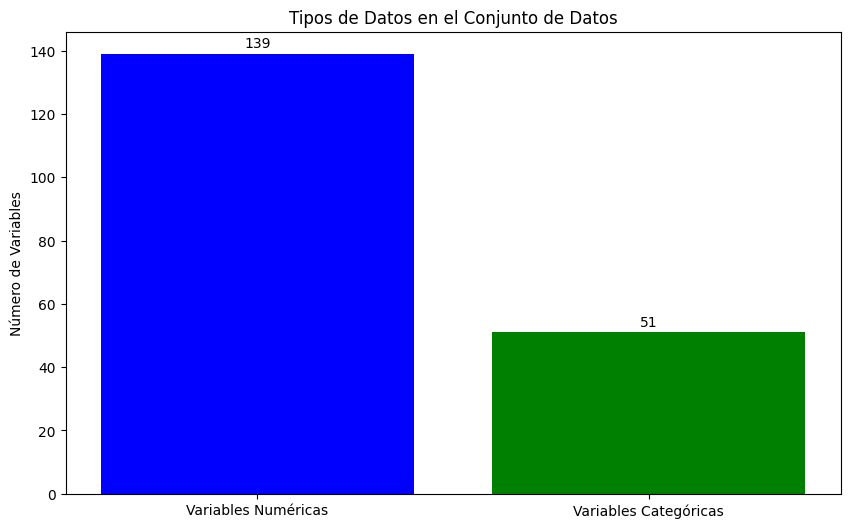

In [28]:
import matplotlib.pyplot as plt

# Verificamos que tipos de datos estaremos trabajando para el análisis
tipos_de_datos = datos.dtypes

variables_numericas = tipos_de_datos[tipos_de_datos != 'object']
variables_categoricas = tipos_de_datos[tipos_de_datos == 'object']

# Obtiene la cantidad de variables numéricas y categóricas
num_variables_numericas = len(variables_numericas)
num_variables_categoricas = len(variables_categoricas)

# Etiquetas para las categorías
categorias = ['Variables Numéricas', 'Variables Categóricas']

# Valores para las categorías
valores = [num_variables_numericas, num_variables_categoricas]

# Crea un gráfico de barras
plt.figure(figsize=(10, 6))
bars = plt.bar(categorias, valores, color=['blue', 'green'])

# Añade etiquetas en las barras
for bar, valor in zip(bars, valores):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1, str(valor), ha='center', va='bottom')

# Añade etiquetas y título
plt.ylabel('Número de Variables')
plt.title('Tipos de Datos en el Conjunto de Datos')

# Muestra el gráfico
plt.show()

Tambien identificamos cuales serian esas Variables Categoricas y numericas

In [29]:
import pandas as pd
import plotly.express as px

# Supongamos que tienes un DataFrame llamado 'datos'
tipos_de_datos = datos.dtypes

variables_numericas = tipos_de_datos[tipos_de_datos != 'object']
variables_categoricas = tipos_de_datos[tipos_de_datos == 'object']

# Crea un DataFrame con nombres de variables y tipos de datos
df = pd.DataFrame({'Variable': datos.columns, 'Tipo de Dato': ['Numérica' if col in variables_numericas else 'Categórica' for col in datos.columns]})

# Crea un gráfico interactivo
fig = px.bar(df, x='Variable', color='Tipo de Dato', title='Tipos de Variables')
fig.show()

### *1.4 Identificacion de Valores Nulos*
- Pasaremos a identificar si en nuestros datos tenemos valores Nulos, y si fuese el caso, cuanto porcentaje de valores Nulos tendrian cada variable del Dataset

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\100313410.py:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




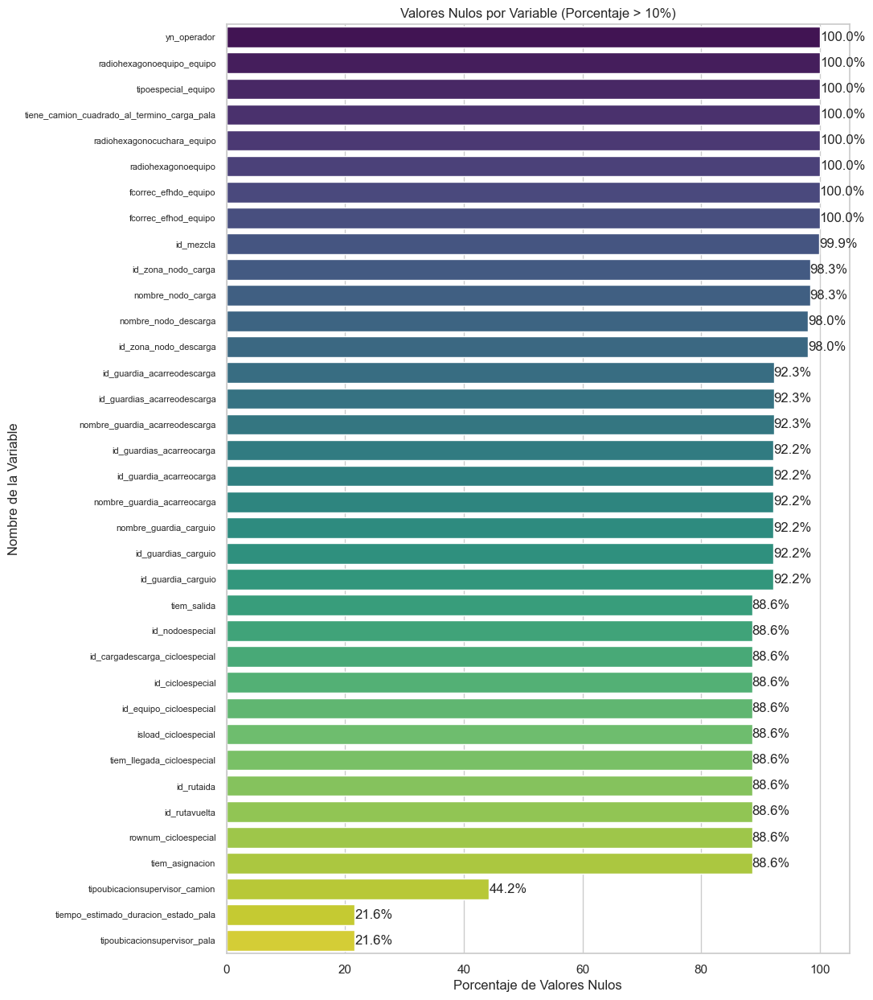

In [32]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado datos
valores_nulos = datos.isnull().sum()
valores_nulos_ordenados = valores_nulos.sort_values(ascending=False)
porcentaje_nulos = (valores_nulos_ordenados / len(datos)) * 100

# Crear un DataFrame con tres columnas: "Nombre de la Variable", "Valores Nulos", y "Porcentaje de Nulos"
df_valores_nulos = pd.DataFrame({'Nombre de la Variable': valores_nulos_ordenados.index,
                                 'Valores Nulos': valores_nulos_ordenados,
                                 'Porcentaje de Nulos': porcentaje_nulos})

# Filtrar variables con más del 10% de valores nulos
umbral_porcentaje_nulos = 10
df_valores_nulos_filtrado = df_valores_nulos[df_valores_nulos['Porcentaje de Nulos'] > umbral_porcentaje_nulos]


# Ordena el DataFrame por la cantidad de valores nulos
#df_valores_nulos = df_valores_nulos.sort_values(by='Valores Nulos', ascending=False)

# Ordena el DataFrame filtrado por la cantidad de valores nulos
df_valores_nulos_filtrado = df_valores_nulos_filtrado.sort_values(by='Valores Nulos', ascending=False)

# Ajusta el espacio entre los nombres de las variables
plt.figure(figsize=(10, 15))
sns.set(style="whitegrid")
ax = sns.barplot(x="Porcentaje de Nulos", y="Nombre de la Variable", data=df_valores_nulos_filtrado, palette="viridis", orient="h")

# Ajusta el espacio entre los nombres de las variables en el eje y
ax.tick_params(axis='y', which='major', labelsize=8)

plt.title(f"Valores Nulos por Variable (Porcentaje > {umbral_porcentaje_nulos}%)")
#plt.title("Valores Nulos por Variable")
plt.xlabel("Porcentaje de Valores Nulos")
plt.ylabel("Nombre de la Variable")

# Agrega etiquetas de porcentaje a las barras
for p in ax.patches:
    width = p.get_width()
    plt.text(width, p.get_y() + p.get_height() / 2, f'{width:.1f}%', ha='left', va='center')

plt.show()

# **2. PREPARACION DE DATOS**

### *2.1 TRATAMIENTO DE VALORES NULOS*
- Una vez que ya hemos identificado los valores Nulos pasaremos a tratarlos acontinuacion:

1. Se eliminan las columnas(variables) con mas del 80% de Nulos en sus datos. Esto debido a que con ese porcentaje 
de valores Nulos, no aportan informacion necesaria para hacer el analisis de datos.

In [33]:
columnas_a_eliminar = porcentaje_nulos[porcentaje_nulos > 80].index
datos = datos.drop(columnas_a_eliminar, axis=1)

Eliminando columnas especificas que no aportan informacion

In [102]:

datos = datos.drop(['tipoubicacionsupervisor_camion','tipoubicacionsupervisor_pala'], axis=1)

2. Tratamineto de Nulos para variables en especifico

In [103]:
#-------------------------------------------------------------------------------------------------------------------
# Calcula la moda de 'has_block_pases'
moda_has_block_pases = datos['has_block_pases'].mode()[0]

# Completa los valores nulos con la moda en la columna 'has_block_pases'
datos['has_block_pases'].fillna(moda_has_block_pases, inplace=True)

#-------------------------------------------------------------------------------------------------------------------------

# Calcula la moda de 'tipodescargaidentifier'
moda_tipodescargaidentifier = datos['tipodescargaidentifier'].mode()[0]

# Completa los valores nulos con la moda en la columna 'tipodescargaidentifier'
datos['tipodescargaidentifier'].fillna(moda_tipodescargaidentifier, inplace=True)

#-----------------------------------------------------------------------------------------------------------------------------

# Completa los valores nulos las columnas de id y nombre
datos['id'] = datos['id'].fillna(0)
datos['nombre'] = datos['nombre'].fillna(0)

#--------------------------------------------------------------------------------------------------------------------------------

3. En las variables donde tenemos un porcentaje de Valores Nulos, se completaran con 0s porque esto favorecera 
al momento de analizar los datos por vizualizacion, y al mismo tiempo no perderemos informacion, lo que si sucederia si 
eliminamos los valores nulos, y esto eliminaria los registros con los valores nulos, y esto haria que tuviesemos menos datos
para analizar

In [104]:
# Rellenar los valores nulos con ceros en todo el DataFrame
datos = datos.fillna(0)

Verificamos que ya hemos solucionado el problema de valores Nulos

In [149]:
#datos.isnull().sum()

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\3599425232.py:21: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




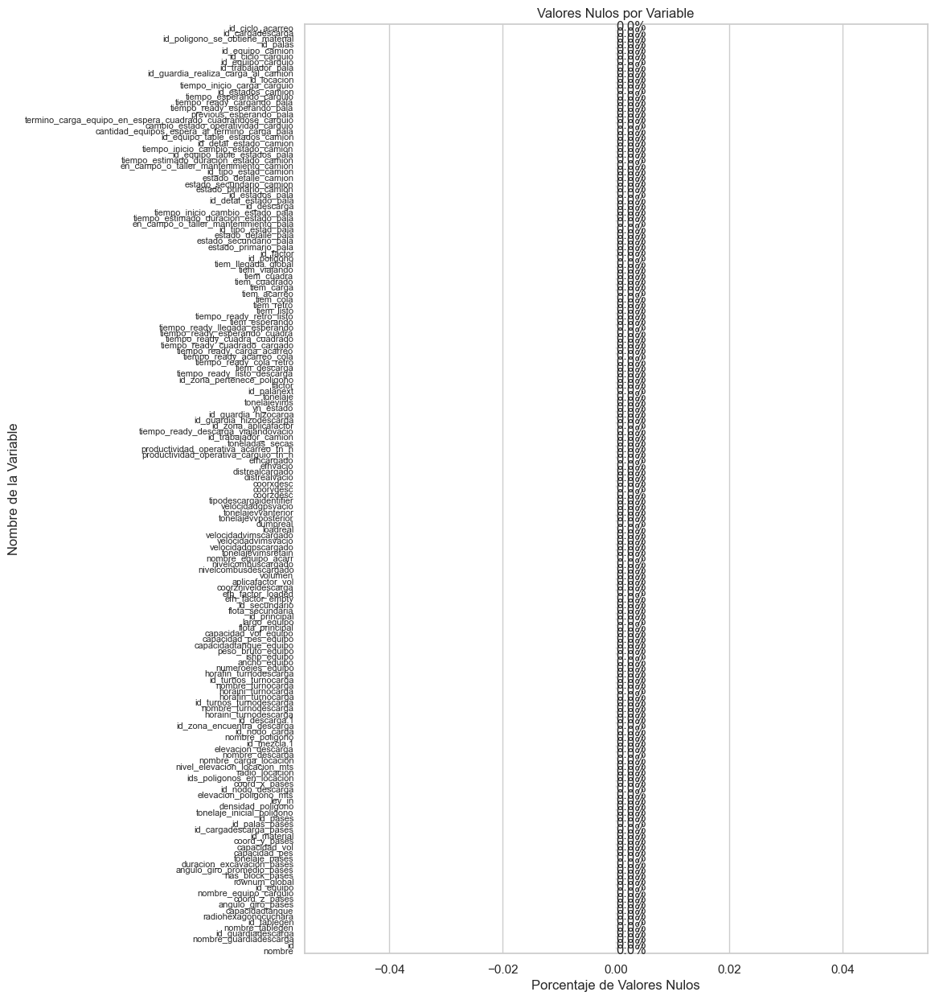

In [148]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado datos
valores_nulos = datos.isnull().sum()
valores_nulos_ordenados = valores_nulos.sort_values(ascending=False)
porcentaje_nulos = (valores_nulos_ordenados / len(datos)) * 100

# Crear un DataFrame con tres columnas: "Nombre de la Variable", "Valores Nulos", y "Porcentaje de Nulos"
df_valores_nulos = pd.DataFrame({'Nombre de la Variable': valores_nulos_ordenados.index,
                                 'Valores Nulos': valores_nulos_ordenados,
                                 'Porcentaje de Nulos': porcentaje_nulos})

# Ordena el DataFrame por la cantidad de valores nulos
df_valores_nulos = df_valores_nulos.sort_values(by='Valores Nulos', ascending=False)

# Ajusta el espacio entre los nombres de las variables
plt.figure(figsize=(10, 15))
sns.set(style="whitegrid")
ax = sns.barplot(x="Porcentaje de Nulos", y="Nombre de la Variable", data=df_valores_nulos, palette="viridis", orient="h")

# Ajusta el espacio entre los nombres de las variables en el eje y
ax.tick_params(axis='y', which='major', labelsize=8)

plt.title("Valores Nulos por Variable")
plt.xlabel("Porcentaje de Valores Nulos")
plt.ylabel("Nombre de la Variable")

# Agrega etiquetas de porcentaje a las barras
for p in ax.patches:
    width = p.get_width()
    plt.text(width, p.get_y() + p.get_height() / 2, f'{width:.1f}%', ha='left', va='center')

plt.show()

### *1.5 IDENTIFICACCION DE VALORES DUPLICADOS*

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\631618845.py:9: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\631618845.py:9: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\631618845.py:9: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) inste

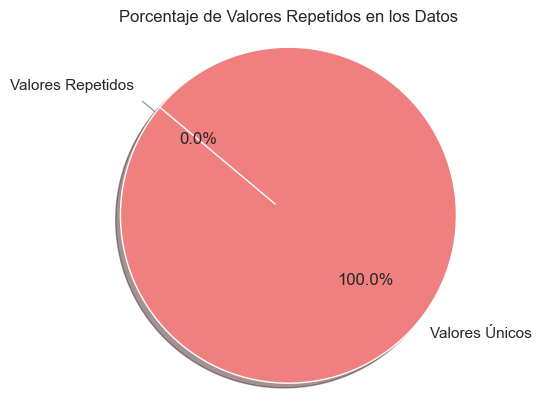

In [107]:
import pandas as pd
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'datos'
# Utiliza la función `duplicated` para marcar filas duplicadas
duplicados = datos[datos.duplicated(keep=False)]

# Luego, utiliza `groupby` para contar cuántas veces se repite cada fila duplicada
conteo_duplicados = duplicados.groupby(list(datos.columns)).size().reset_index(name='Cantidad')

# Filtra las filas que se repiten al menos 2 veces
conteo_duplicados = conteo_duplicados[conteo_duplicados['Cantidad'] >= 2]

# Calcular el porcentaje de valores repetidos
cantidad_filas_duplicadas = len(conteo_duplicados)
total_filas = len(datos)
porcentaje_repetidos = (cantidad_filas_duplicadas / total_filas) * 100

# Crear un gráfico de pastel
labels = ['Valores Únicos', 'Valores Repetidos']
sizes = [100 - porcentaje_repetidos, porcentaje_repetidos]
colors = ['lightcoral', 'lightblue']
explode = (0, 0.1)  # Destacar la porción de valores repetidos

plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)
plt.axis('equal')  # Asegurar que el gráfico sea un círculo

plt.title('Porcentaje de Valores Repetidos en los Datos')

plt.show()

# **2. PREPARACION DE DATOS**

### *2.2 Tratamiento de Valores Duplicados*

In [17]:
#datos = datos.drop_duplicates()

Se guardan los datos que han sido preprocesados 

In [69]:
#Se guardan los datos que han sido preprocesados 
#datos.to_csv('datos_turno1_limpios.csv', index=False)

Se cargan los datos limpios para hacer transfomacion de datos

In [119]:
#Se cargan los datos limpios para hacer transfomacion de datos
#datos = pd.read_csv('datos_turno1_limpios.csv')
#datos.head()

### *2.3 Transformacion de datos* (Configuracion de fechas, Dimension de datos, ajuste de datos, etc)

2.3.1 Transformacion de las variables de fechas a formato Datetime

In [109]:
# lista de columnas 'columnas_fecha' que contienen fechas
columnas_fecha = ['tiem_llegada_global','tiem_esperando', 'tiem_cuadra', 'tiem_cuadrado', 'tiem_carga', 'tiem_acarreo', 'tiem_cola', 'tiem_retro',
                  'tiem_listo', 'tiem_descarga', 'tiem_viajando','tiempo_inicio_carga_carguio', 'tiempo_esperando_carguio','previous_esperando_pala',
                  'tiempo_inicio_cambio_estado_camion','tiempo_inicio_cambio_estado_pala']  
# Itera sobre las columnas de fechas y convierte cada una
for columna in columnas_fecha:
    datos[columna] = pd.to_datetime(datos[columna], errors='coerce')  #Coerce reemplaza con Null, si la fecha no tiene el formato de la mayoria

# Ahora las columnas deberían ser del tipo datetime64[ns]
print(datos.dtypes)

id_ciclo_acarreo                                                                   int64
id_cargadescarga                                                                   int64
id_palas                                                                           int64
id_equipo_camion                                                                   int64
id_ciclo_carguio                                                                 float64
id_equipo_carguio                                                                float64
id_trabajador_pala                                                               float64
id_guardia_realiza_carga_al_camion                                               float64
id_locacion                                                                      float64
id_poligono_se_obtiene_material                                                  float64
tiempo_inicio_carga_carguio                                    datetime64[ns, UTC-05:00]
tiempo_esperando_carg

2.3.2 Se completan los valores Null generados por 'COERSE'(Celda anterior) de las fechas con el registro anterior mas 3 segundos

In [112]:
columnas_a_procesar = ['tiem_llegada_global','tiem_esperando', 'tiem_cuadra', 'tiem_cuadrado', 'tiem_carga', 'tiem_acarreo', 'tiem_cola', 'tiem_retro',
                  'tiem_listo', 'tiem_descarga', 'tiem_viajando','tiempo_inicio_carga_carguio', 'tiempo_esperando_carguio','previous_esperando_pala',
                  'tiempo_inicio_cambio_estado_camion','tiempo_inicio_cambio_estado_pala']

# Iterar sobre las columnas y reemplazar NaT con la fecha de la fila anterior + 3 segundos
for columna in columnas_a_procesar:
    mask_nat = datos[columna].isna()
    datos[columna].loc[mask_nat] = datos[columna].fillna(method='ffill') + pd.to_timedelta(3, unit='s')

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\3996567405.py:8: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\3996567405.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Se guardan los datos procesados (fechas a formato Datetime)

In [114]:
#Se guardan los datos que han sido preprocesados y calidad en los datos y cambiados nombres
#datos.to_csv('datos_turno1_prepro_v1.csv', date_format='%Y-%m-%d %H:%M:%S.%f%z', index=False)

In [115]:
#datos = pd.read_csv('datos_turno1_prepro_v1.csv', parse_dates=['tiem_llegada_global','tiem_esperando', 'tiem_cuadra', 'tiem_cuadrado', 'tiem_carga', 'tiem_acarreo', 'tiem_cola', 'tiem_retro',
#                  'tiem_listo', 'tiem_descarga', 'tiem_viajando','tiempo_inicio_carga_carguio', 'tiempo_esperando_carguio','previous_esperando_pala',
#                  'tiempo_inicio_cambio_estado_camion','tiempo_inicio_cambio_estado_pala'], date_parser=lambda x: pd.to_datetime(x, format='%Y-%m-%d %H:%M:%S.%f%z'))

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\651689491.py:1: FutureWarning:

The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_25844\651689491.py:1: DtypeWarning:

Columns (15,16) have mixed types. Specify dtype option on import or set low_memory=False.



2.3.3 Transformacion de datos que tienen medidas distintas (ejemplo: cm, metros, km, etc)

In [182]:
#pasar tonelajevims a toneladas
datos['tonelajevims'] = datos['tonelajevims'] / 10

#pasar efhcargado de centimetros a metros
datos['efhcargado'] = datos['efhcargado'] / 100

#pasar efhvacio de centimetros a metros
datos['efhvacio'] = datos['efhvacio'] / 100

#pasar distrealcargado de centimetros a metros
datos['distrealcargado'] = datos['distrealcargado'] / 100

#pasar distrealvacio de centimetros a metros
datos['distrealvacio'] = datos['distrealvacio'] / 100

#pasar coorxdesc de centimetros a Km
datos['coorxdesc'] = datos['coorxdesc'] / 100000

#pasar coorydesc de centimetros a Km
datos['coorydesc'] = datos['coorydesc'] / 100000

#pasar coorzdesc de centimetros a Km
datos['coorzdesc'] = datos['coorzdesc'] / 100000

#pasar velocidadvimscargado a  Km/hr
datos['velocidadvimscargado'] = datos['velocidadvimscargado'] / 1000

#pasar velocidadvimsvacio a  Km/hr
datos['velocidadvimsvacio'] = datos['velocidadvimsvacio'] / 1000

#pasar velocidadvimsvacio a  Km/hr
datos['velocidadgpscargado'] = datos['velocidadgpscargado'] / 1000

#pasar velocidadvimsvacio a  Km/hr
datos['velocidadgpsvacio'] = datos['velocidadgpsvacio'] / 1000

#pasar tonelajevimsretain a  toneladas
datos['tonelajevimsretain'] = datos['tonelajevimsretain'] / 10

#pasar coorzniveldescarga de centimetros a metros
datos['coorzniveldescarga'] = datos['coorzniveldescarga'] / 100

#pasar ancho_equipo de centimetros a metros
datos['ancho_equipo'] = datos['ancho_equipo'] / 100

#pasar largo_equipo de centimetros a metros
datos['largo_equipo'] = datos['largo_equipo'] / 100

#pasar tonelajevvanterior a toneladas
datos['tonelajevvanterior'] = datos['tonelajevvanterior'] / 10

#pasar tonelajevvposterior a toneladas
datos['tonelajevvposterior'] = datos['tonelajevvposterior'] / 10

2.3.4 Limpieza de Variables Especificas 

In [200]:
# DataFrame llamado 'datos' y la columna que deseas modificar (solucionar datos string) y uniformizar a un solo True-False
datos['termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio'] = datos['termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio'].replace({'True': True, 'False': False, '0': datos['termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio'].mode().iloc[0]})

# Convertir la columna a un tipo de datos booleano
datos['termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio'] = datos['termino_carga_equipo_en_espera_cuadrado_cuadrandose_carguio'].astype(bool)


#-----------------------------------------------------------------------------------------------------------------------------------------------------------------------
# DataFrame llamado 'datos' y la columna que deseas modificar (solucionar datos string) y uniformizar a un solo True-False
datos['cambio_estado_operatividad_carguio'] = datos['cambio_estado_operatividad_carguio'].replace({'True': True, 'False': False, '0': datos['cambio_estado_operatividad_carguio'].mode().iloc[0]})

# Convertir la columna a un tipo de datos booleano
datos['cambio_estado_operatividad_carguio'] = datos['cambio_estado_operatividad_carguio'].astype(bool)


2.3.5 Limpieza de Columnas duplicadas

In [229]:
#Eliminamos la columna 'id_cargadescarga_pases', es igual que id_cargadescarga, y asi mas casos de columnas obsoletas
datos = datos.drop(['id_cargadescarga_pases','dumpreal','loadreal', 'rownum_global', 'id_equipo'], axis=1)

### 2.4 <font color="orange">Renombramos los nombres de las variables para un mejor analisis
- Al momento de renombrar las variables, tener en cuenta que no se repitan los nombres de las variables</font>

In [233]:
import pandas as pd

# Define un diccionario con los nuevos nombres de las columnas solo para algunas columnas
nuevos_nombres = {'id_cargadescarga' : 'id_cargadescarga_ciclo', 'previous_esperando_pala' : 'tiempo_previous_esperando_pala',
    '
    ' : 'al_termino_cargar_en_espera_cuadrado_cuadrandose',
    'id_descarga' : 'id_zona_hace_descarga', 'id_descarga.1': 'id_secundario_descarga',  
    'tiem_llegada_global': 'tiempo_llegada_camion', 'tiem_esperando': 'tiempo_esperando_camion_en_locacion', 
    'tiem_cuadra': 'tiempo_cuadra_camion','tiem_cuadrado': 'tiempo_cuadrado_camion' , 'tiem_carga' : 'tiempo_cargar_al_camion', 
    'tiem_acarreo' : 'tiempo_acarreo_camion', 'tiem_cola': 'tiempo_cola_camion_en_zonadescarga','tiem_retro': 'tiempo_retroceso_para_descargar',
    'tiem_listo' : 'tiempo_listo_para_descargar',  'tiem_descarga': 'tiempo_descarga_camion', 'tiem_viajando': 'tiempo_viajando_vacio_locacion', 
    'tonelaje':'tonelaje_nominal', 'tonelajevims':'tonelaje_segun_computadora', 'yn_estado': 'cambios_estado_en_ciclo',
    'distrealcargado': 'distancia_recorrida_camioncargado_km_gps', 'distrealvacio': 'distancia_recorrida_camionvacio_km_gps' ,
    'coorxdesc': 'coordenada_x_descarga_km', 'coorydesc': 'coordenada_y_descarga_km' , 'coorzdesc': 'coordenada_z_descarga_km',
    'tipodescargaidentifier': 'tipo_descarga_efectuado', 
    'tonelajevvanterior': 'tonelaje_camion_viajevacio_cicloanterior_vims', 'tonelajevvposterior': 'tonelaje_camion_viajevacio_cicloactual_vims',
    'velocidadvimscargado': 'promedio_velocidad_camioncargado_km/hr_compu', 
    'velocidadvimsvacio': 'promedio_velocidad_camionvacio_km/hr_compu',
    'velocidadgpscargado':'promedio_velocidad_camioncargado_km/hr_gps', 'velocidadgpsvacio': 'promedio_velocidad_camionvacio_km/hr_gps', 
    'tonelajevimsretain': 'tonelaje_camion_antes_cargaestabilizada', 'nivelcombuscargado': 'porcentaje_combustible_camioncargando', 
    'nivelcombusdescargado':'porcentaje_combustible_camiondescargando', 'volumen': 'volumen_nominal', 'aplicafactor_vol': 'aplica_factor_volumen_o_tonelaje',
    'coorzniveldescarga': 'nivel_descarga_metros', 'nombre_equipo_acarr':'nombre_equipo_acarreo', 
    'id_secundario':'id_flota_secundaria', 'flota_secundaria':'nombre_flota_secundaria', 'id_principal': 'id_flota_principal', 'flota_principal':'nombre_flota_principal',
    'capacidad_vol_equipo': 'capacidad_en_volumen_equipo_acarreo', 'capacidad_pes_equipo':'capacidad_en_peso_equipo_acarreo', 'capacidadtanque_equipo': 'capacidadtanque_equipoacarreo_galones',
    'peso_bruto_equipo':'peso_bruto_equipo_acarreo', 'ishp_equipo':'si_no_equipo_altaprecision', 'ancho_equipo':'ancho_equipo_metros', 'largo_equipo':'largo_equipo_metros',
    'id_mezcla.1': 'id_mezcla_asignada_a_descargarse', 'elevacion_descarga':'nivel_elevacion_descarga_metros', 'nombre_descarga':'nombre_zona_descarga', 
    'nombre_carga_locacion':'nombre_locacion_carga', 'nivel_elevacion_locacion_mts':'nivel_elevacion_locacion_carga_metros', 'radio_locacion':'radio_locacion_metros',
    'ids_poligonos_en_locacion':'ids_poligonos_en_locacion_carga', 'id_material': 'id_material_dominante_en_poligono', 
    'elevacion_poligono_mts':'elevacion_poligono_metros', 'ley_in':'lista_leyes', 'densidad_poligono':'densidad_inicial_poligono_creado',
    'capacidad_vol' : 'capacidad_en_volumen_equipo_carguio', 'capacidad_pes':'capacidad_en_peso_equipo_carguio', 'capacidadtanque': 'capacidadtanque_equipocarguio_galones',
    'radiohexagonocuchara' : 'radiohexagonocuchara_equipocarguio', 'id_tablegen' : 'id_guardia_acarreocarga', 'nombre_tablegen' : 'nombre_guardia_acarreocarga', 
    'id_guardiadescarga': 'id_guardia_acarreodescarga', 'nombre_guardiadescarga':'nombre_guardia_acarreodescarga',
    'id':'id_guardia_carguio', 'nombre': 'nombre_guardia_carguio', 'id_locacion' : 'id_locacion_hace_carga','tonelaje_inicial_poligono': 'tonelaje_inicial_poligono_creado'
}

# Renombra las columnas del DataFrame
datos = datos.rename(columns=nuevos_nombres)
datos.head(2)

,id_ciclo_acarreo,id_cargadescarga_ciclo,id_palas,id_equipo_camion,id_ciclo_carguio,id_equipo_carguio,id_trabajador_pala,id_guardia_realiza_carga_al_camion,id_locacion_hace_carga,id_poligono_se_obtiene_material,tiempo_inicio_carga_carguio,tiempo_esperando_carguio,tiempo_ready_cargando_pala,tiempo_ready_esperando_pala,tiempo_previous_esperando_pala,al_termino_cargar_en_espera_cuadrado_cuadrandose,cambio_estado_operatividad_carguio,cantidad_equipos_espera_al_termino_carga_pala,id_estados_camion,id_equipo_table_estados_camion,id_detal_estado_camion,tiempo_inicio_cambio_estado_camion,tiempo_estimado_duracion_estado_camion,en_campo_o_taller_mantenimiento_camion,id_tipo_estad_camion,estado_detalle_camion,estado_secundario_camion,estado_primario_camion,id_estados_pala,id_equipo_table_estados_pala,id_detal_estado_pala,tiempo_inicio_cambio_estado_pala,tiempo_estimado_duracion_estado_pala,en_campo_o_taller_mantenimiento_pala,id_tipo_estad_pala,estado_detalle_pala,estado_secundario_pala,estado_primario_pala,id_zona_hace_descarga,id_factor,id_poligono,tiempo_llegada_camion,tiempo_esperando_camion_en_locacion,tiempo_cuadra_camion,tiempo_cuadrado_camion,tiempo_cargar_al_camion,tiempo_acarreo_camion,tiempo_cola_camion_en_zonadescarga,tiempo_retroceso_para_descargar,tiempo_listo_para_descargar,tiempo_descarga_camion,tiempo_viajando_vacio_locacion,tiempo_ready_llegada_esperando,tiempo_ready_esperando_cuadra,tiempo_ready_cuadra_cuadrado,tiempo_ready_cuadrado_cargado,tiempo_ready_carga_acarreo,tiempo_ready_acarreo_cola,tiempo_ready_cola_retro,tiempo_ready_retro_listo,tiempo_ready_listo_descarga,tiempo_ready_descarga_viajandovacio,id_trabajador_camion,id_palanext,tonelaje_nominal,tonelaje_segun_computadora,cambios_estado_en_ciclo,id_guardia_hizocarga,id_guardia_hizodescarga,id_zona_aplicafactor,id_zona_pertenece_poligono,factor,toneladas_secas,productividad_operativa_acarreo_tn_h,productividad_operativa_carguio_tn_h,efhcargado,efhvacio,distancia_recorrida_camioncargado_km_gps,distancia_recorrida_camionvacio_km_gps,coordenada_x_descarga_km,coordenada_y_descarga_km,coordenada_z_descarga_km,tipo_descarga_efectuado,tonelaje_camion_viajevacio_cicloanterior_vims,tonelaje_camion_viajevacio_cicloactual_vims,promedio_velocidad_camioncargado_km/hr_compu,promedio_velocidad_camionvacio_km/hr_compu,promedio_velocidad_camioncargado_km/hr_gps,promedio_velocidad_camionvacio_km/hr_gps,tonelaje_camion_antes_cargaestabilizada,porcentaje_combustible_camioncargando,porcentaje_combustible_camiondescargando,volumen_nominal,aplica_factor_volumen_o_tonelaje,nivel_descarga_metros,efh_factor_loaded,efh_factor_empty,nombre_equipo_acarreo,id_flota_secundaria,nombre_flota_secundaria,id_flota_principal,nombre_flota_principal,capacidad_en_volumen_equipo_acarreo,capacidad_en_peso_equipo_acarreo,capacidadtanque_equipoacarreo_galones,peso_bruto_equipo_acarreo,si_no_equipo_altaprecision,ancho_equipo_metros,largo_equipo_metros,numeroejes_equipo,id_turnos_turnocarga,nombre_turnocarga,horaini_turnocarga,horafin_turnocarga,id_turnos_turnodescarga,nombre_turnodescarga,horaini_turnodescarga,horafin_turnodescarga,id_secundario_descarga,id_zona_encuentra_descarga,id_nodo_carga,id_nodo_descarga,id_mezcla_asignada_a_descargarse,nivel_elevacion_descarga_metros,nombre_zona_descarga,nombre_locacion_carga,nivel_elevacion_locacion_carga_metros,radio_locacion_metros,ids_poligonos_en_locacion_carga,id_material_dominante_en_poligono,nombre_poligono,elevacion_poligono_metros,lista_leyes,densidad_inicial_poligono_creado,tonelaje_inicial_poligono_creado,id_pases,id_palas_pases,coord_x_pases,coord_y_pases,coord_z_pases,angulo_giro_pases,tonelaje_pases,duracion_excavacion_pases,angulo_giro_promedio_pases,has_block_pases,nombre_equipo_carguio,capacidad_en_volumen_equipo_carguio,capacidad_en_peso_equipo_carguio,capacidadtanque_equipocarguio_galones,radiohexagonocuchara_equipocarguio,id_guardia_acarreocarga,nombre_guardia_acarreocarga,id_guardia_acarreodescarga,nombre_guardia_acarreodescarga,id_guardia_carg

Renombramos variables con mayor nivel de profundidad

In [252]:
#import pandas as pd

# Define un diccionario con los nuevos nombres de las columnas solo para algunas columnas
#nuevos_nombres_2 = {'densidad_inicial_poligono_creado':'densidad_inicial_poligono_creado_tn/m3',
#'capacidad_en_volumen_equipo_acarreo' : 'capacidad_en_volumen_equipo_acarreo_m3',
#                  'capacidad_en_volumen_equipo_carguio' : 'capacidad_en_volumen_equipo_carguio_m3',
#                  'efhvacio':'efhvacio_mts', 'efhcargado':'efhcargado_mts', 
#                  'distancia_recorrida_camionvacio_km_gps':'distancia_recorrida_camionvacio_km_gps_mts',
#                  'distancia_recorrida_camioncargado_km_gps':'distancia_recorrida_camioncargado_km_gps_mts'
#}

# Renombra las columnas del DataFrame
#datos = datos.rename(columns=nuevos_nombres_2)
#datos.head(2)

#### 3. Agregar nuevas variables calculadas al dataset

In [242]:
#Agregamos la variable 'porcentaje_eficiencia_toneladas_movidas_acarreo'
datos['porcentaje_eficiencia_toneladas_movidas_acarreo'] = (datos['tonelaje_segun_computadora'] / datos['tonelaje_nominal']) * 100

#Agregamos la variable 'altura_elevacion'
datos['altura_elevacion'] = abs(datos['nivel_elevacion_descarga_metros'] - datos['nivel_elevacion_locacion_carga_metros'] )

In [249]:
# Agregamos la variable 'factor_perfil_rutavacio_mts'
datos['factor_perfil_rutavacio'] = np.where(datos['distancia_recorrida_camionvacio_km_gps_mts'] != 0,
                                            datos['efhvacio_mts'] / datos['distancia_recorrida_camionvacio_km_gps_mts'],
                                            0)

# Agregamos la variable 'factor_perfil_rutacargado_mts'
datos['factor_perfil_rutacargado'] = np.where(datos['distancia_recorrida_camioncargado_km_gps_mts'] != 0,
                                              datos['efhcargado_mts'] / datos['distancia_recorrida_camioncargado_km_gps_mts'],
                                              0)

In [271]:
# Agregamos la variable calculada "numero_pases_carguio" basado en la columna 'coord_x_pases'
datos['numero_pases_carguio'] = datos['coord_x_pases'].apply(lambda x: len(eval(x)) if isinstance(x, str) and '[' in x else x if isinstance(x, int) else 0)

#isinstance(x, str) and '[' in x: Verifica si x es una cadena (string) y contiene el carácter "[".
#len(eval(x)): Si la condición anterior es verdadera, evalúa el contenido de la cadena x como una expresión de Python y calcula su longitud.
# caso contrario si es un entero, devuelve el mismo X , sino 0

Agregamos la variable Galones_diponible_camioncargando y Galones_diponible_camiondescargando 

In [306]:
#Agregamos la variable Galones_diponible_camioncargando
datos['Galones_disponibles_camioncargando'] = (datos['porcentaje_combustible_camioncargando']/100) * datos['capacidadtanque_equipoacarreo_galones']
#datos['demanda_galones_camioncargando'] = (datos['porcentaje_combustible_camioncargando']/100) * datos['capacidadtanque_equipoacarreo_galones']

#Agregar la variable Galones_diponible_camiondescargando 
datos['Galones_disponibles_camiondescargando'] = (datos['porcentaje_combustible_camiondescargando']/100) * datos['capacidadtanque_equipoacarreo_galones']
#datos['demanda_galones_camiondescargando'] = (datos['porcentaje_combustible_camiondescargando']/100) * datos['capacidadtanque_equipoacarreo_galones']

Agregar la variable Galones_consumidos_entre_cargando_descargando 

In [311]:
#Agregar la variable Galones_consumidos_entre_cargando_descargando 
datos['Galones_consumidos_entre_cargando_descargando_acarreo'] = datos['Galones_disponibles_camioncargando'] - datos['Galones_disponibles_camiondescargando']
#datos['demanda_galones_camiondescargando'] = (datos['porcentaje_combustible_camiondescargando']/100) * datos['capacidadtanque_equipoacarreo_galones']

### 4. *Se guardan los datos que han sido preprocesados y calidad en los datos y cambiados nombres (listos para analisis), con el formato datetime adecuado*

In [318]:
#Se guardan los datos que han sido preprocesados y calidad en los datos y cambiados nombres
datos.to_csv('datos_turno1_listo_para_analisis.csv', date_format='%Y-%m-%d %H:%M:%S.%f%z', index=False)

### *4.1 Se cargan los datos que estan listos para analisis, con el formato datetime adecuado*

In [12]:
datos = pd.read_csv('datos_turno1_listo_para_analisis.csv', parse_dates=['tiempo_llegada_camion','tiempo_esperando_camion_en_locacion',
                 'tiempo_cuadra_camion', 'tiempo_cuadrado_camion', 'tiempo_cargar_al_camion', 'tiempo_acarreo_camion', 
                 'tiempo_cola_camion_en_zonadescarga', 'tiempo_retroceso_para_descargar',
                 'tiempo_listo_para_descargar', 'tiempo_descarga_camion', 'tiempo_viajando_vacio_locacion','tiempo_inicio_carga_carguio',
                 'tiempo_esperando_carguio','tiempo_previous_esperando_pala',
                  'tiempo_inicio_cambio_estado_camion','tiempo_inicio_cambio_estado_pala'], date_parser=lambda x: pd.to_datetime(x, format='%Y-%m-%d %H:%M:%S.%f%z'))


C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_16588\2908562261.py:1: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  datos = pd.read_csv('datos_turno1_listo_para_analisis.csv', parse_dates=['tiempo_llegada_camion','tiempo_esperando_camion_en_locacion',


In [13]:
datos.dtypes

id_ciclo_acarreo                                                             int64
id_cargadescarga_ciclo                                                       int64
id_palas                                                                     int64
id_equipo_camion                                                             int64
id_ciclo_carguio                                                           float64
id_equipo_carguio                                                          float64
id_trabajador_pala                                                         float64
id_guardia_realiza_carga_al_camion                                         float64
id_locacion_hace_carga                                                     float64
id_poligono_se_obtiene_material                                            float64
tiempo_inicio_carga_carguio                              datetime64[ns, UTC-05:00]
tiempo_esperando_carguio                                 datetime64[ns, UTC-05:00]
tiem

### *5. ANALISIS DE ESTADISTICA DESCRIPTIVA EN LOS DATOS*

Se analizan las medidas de tendencia central, donde tambien se consideran la desviacion estandar, cuantiles, media, max, min

In [289]:
import pandas as pd

# Supongamos que 'analisis_descriptivo_num' es el DataFrame resultante de tu análisis descriptivo
# Puedes personalizar las estadísticas que deseas mostrar
columnas_a_excluir = [col for col in datos.columns if col.startswith('id')]

# Selecciona solo las columnas que no comienzan con 'id'
columnas_incluidas = [col for col in datos.columns if col not in columnas_a_excluir] # Si no estan en columnas a excluir, entonces las incluyo en el analisis estadistico

analisis_descriptivo = datos[columnas_incluidas].describe()

# Estadísticas descriptivas a mostrar
estadisticas = ['count', 'mean', 'std', 'min', '25%', '50%', '75%', 'max']

# Selecciona las estadísticas deseadas
resumen_estadistico = analisis_descriptivo.loc[estadisticas]

# Transpone la tabla para que las estadísticas estén en filas y las columnas en columnas
resumen_estadistico = resumen_estadistico.T

# Muestra la tabla de estadísticas
print(resumen_estadistico)

                                                        count           mean            std          min          25%           50%           75%             max
tiempo_ready_cargando_pala                      368110.000000     183.779925     128.756347     0.000000   132.017000    158.030000    196.025000     5012.661000
tiempo_ready_esperando_pala                     368110.000000     168.252767     218.766058     0.000000    49.815000     94.333500    198.887750     8569.329421
cantidad_equipos_espera_al_termino_carga_pala   368110.000000       0.354476       0.746483    -1.000000     0.000000      0.000000      1.000000        8.000000
tiempo_estimado_duracion_estado_camion          368110.000000     152.027655     219.874297     0.000000     0.000000      0.000000    300.000000      600.000000
en_campo_o_taller_mantenimiento_camion          368110.000000       0.586281       0.492500     0.000000     0.000000      1.000000      1.000000        1.000000
tiempo_estimado_duracion_est

**Definiciones:**  
*- Desviacion_Estandar : Cuanto mayor sea la desviación estándar, mayor será la variabilidad de los datos con respecto a la media. Si una variable tiene una desviación estándar significativamente más alta que otra, esto sugiere que los valores en esa variable están más dispersos y pueden estar más lejos de la media. También puede indicar la presencia de valores atípicos o extremos.*

### *3.1 Analisis de Histogramas*

**Definiciones:**  
- Eje horizontal (eje X): En el eje X, se representan los valores de la variable que estás analizando. Cada barra del histograma corresponde a un rango de valores.
- Eje vertical (eje Y): En el eje Y, se representa la frecuencia o densidad de ocurrencia de los valores en cada rango. La altura de las barras del histograma muestra cuántas veces los valores caen dentro de ese rango.
- Tendencia central: La ubicación de la "cima" o pico del histograma indica la tendencia central de los datos. 
- Dispersión: La dispersión se relaciona con la anchura de las barras del histograma. Cuanto más ancho sea el histograma, mayor será la dispersión de los datos. Cuanto más estrecho sea, menor será la dispersión.
- Valores atípicos: Los valores atípicos o extremos en el histograma se alejan significativamente del rango principal de la distribución y pueden aparecer como barras solitarias o como una cola larga en un extremo del histograma.
- Interpretación de patrones: Un histograma puede mostrar múltiples modas (picos) o patrones interesantes.


In [340]:
datos['cambio_estado_operatividad_carguio'].value_counts()

cambio_estado_operatividad_carguio
False    339852
True      28258
Name: count, dtype: int64

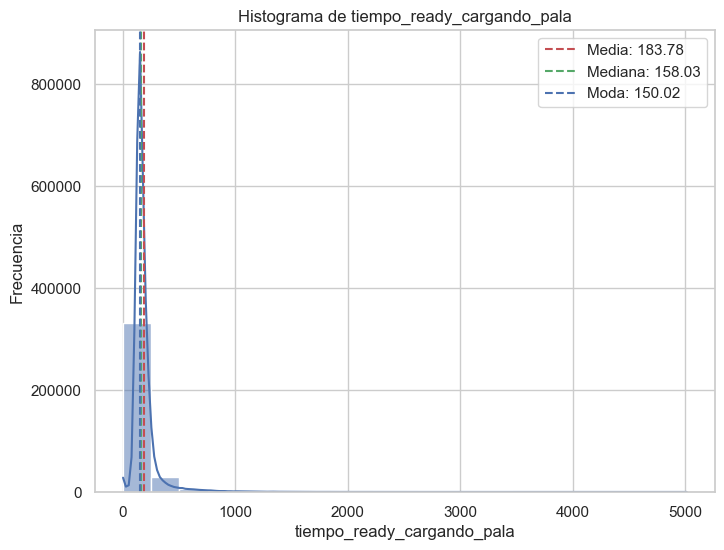

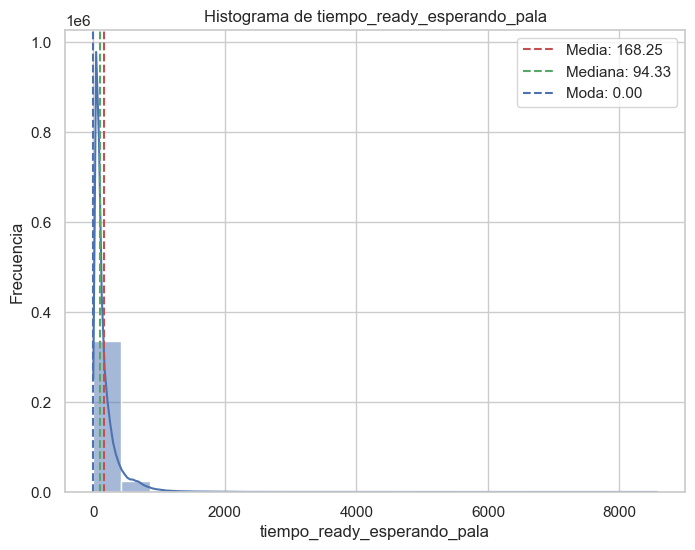

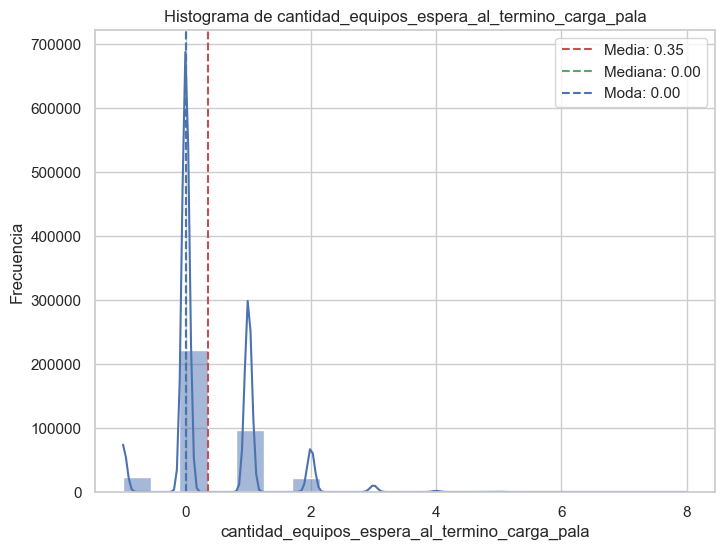

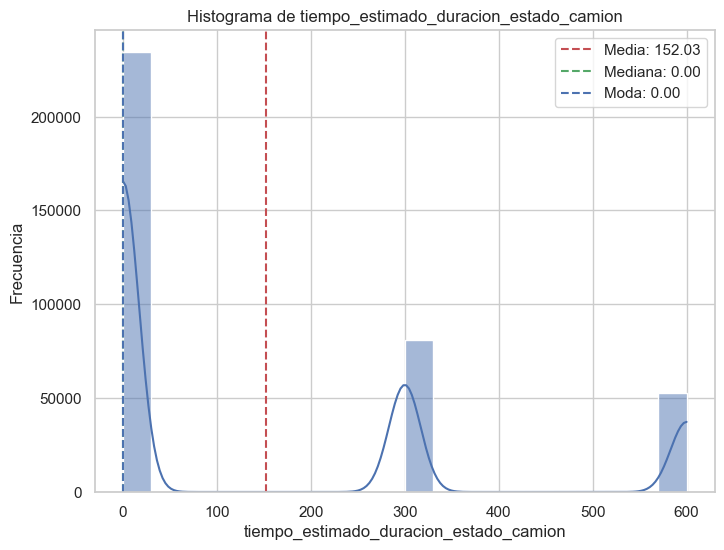

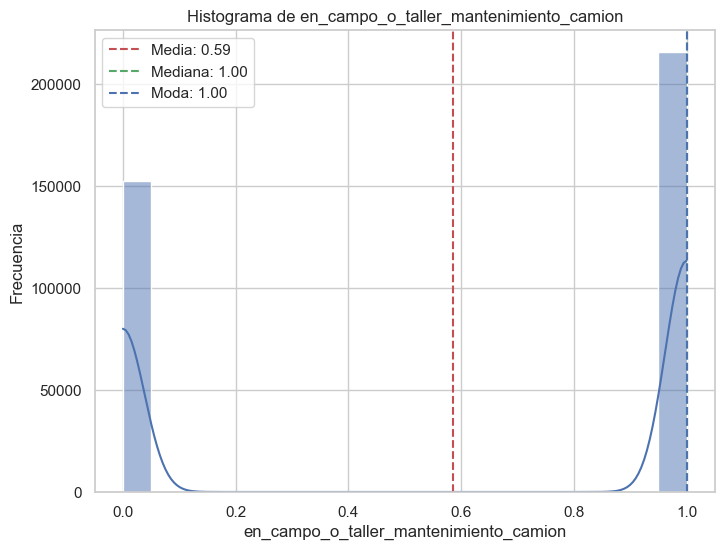

...

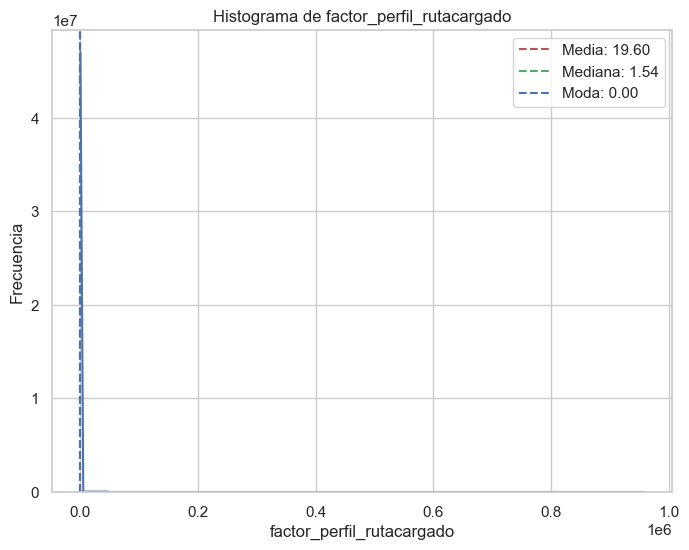

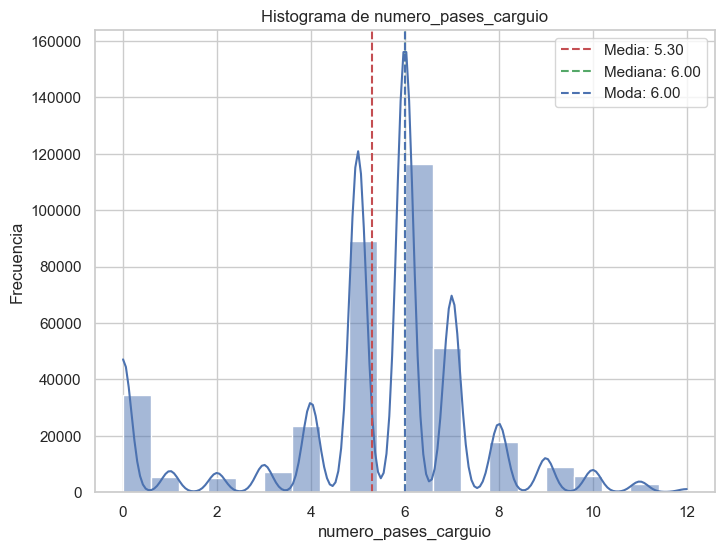

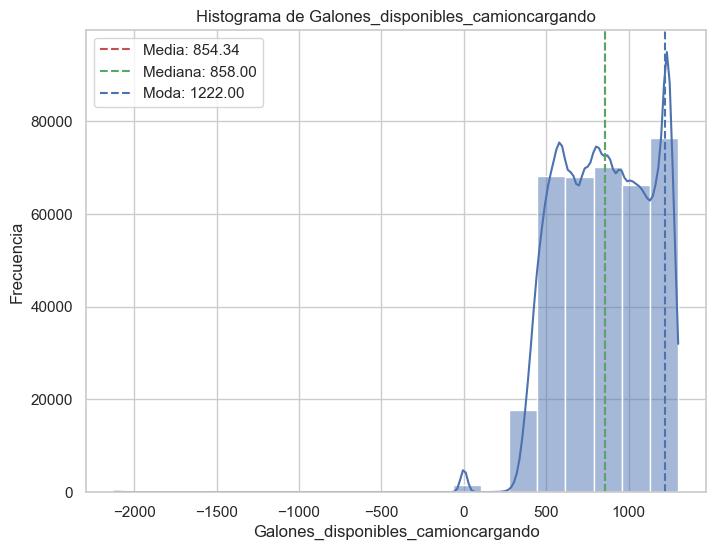

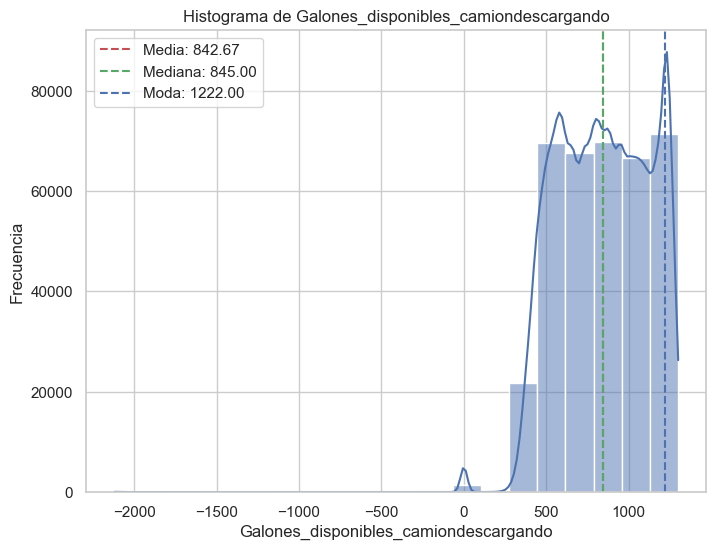

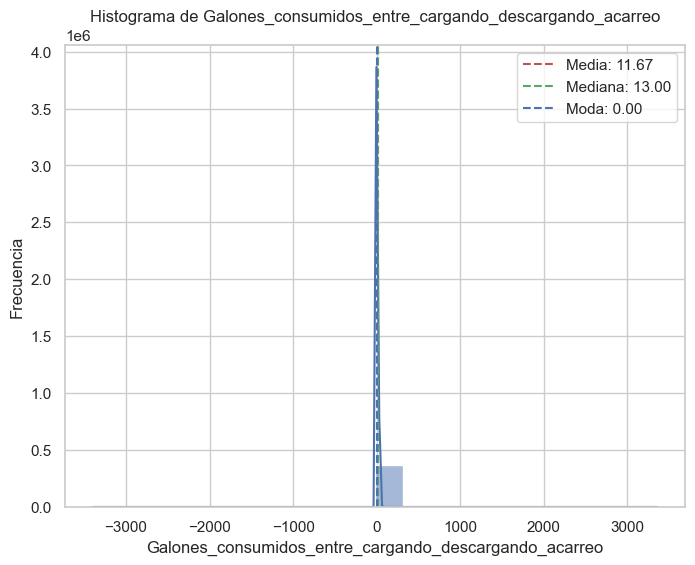

In [322]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'datos'

# Identificar las columnas numéricas y categóricas
columnas_numericas = datos.select_dtypes(include=['int', 'float']).columns

# Excluir las columnas que comienzan con 'id'
columnas_a_excluir = [col for col in datos.columns if col.startswith('id')]

# Filtrar las columnas numéricas que no están en columnas_a_excluir
columnas_a_incluir = [col for col in columnas_numericas if col not in columnas_a_excluir]

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Crear histogramas solo para las columnas numéricas seleccionadas
for columna in columnas_a_incluir:
    plt.figure(figsize=(8, 6))
    sns.histplot(datos[columna], bins=20, kde=True)

    # Calcula la media, mediana y moda
    media = datos[columna].mean()
    mediana = datos[columna].median()
    moda = datos[columna].mode().iloc[0]  # Obtén el primer valor modal

    # Agrega líneas verticales y etiquetas
    plt.axvline(media, color='r', linestyle='--', label=f'Media: {float(media):.2f}')
    plt.axvline(mediana, color='g', linestyle='--', label=f'Mediana: {mediana:.2f}')
    plt.axvline(moda, color='b', linestyle='--', label=f'Moda: {float(moda):.2f}')

    plt.title(f'Histograma de {columna}')
    plt.xlabel(columna)
    plt.ylabel("Frecuencia")
    plt.legend()
    plt.show()

<span style="color: orange;">***Principales Insights del analisis de Histogramas***</span>
1. tonelajex10_segun_computadora
2. distancia_recorrida_camioncargado_cm_gps
3. distancia_recorrida_camionvacio_cm_gps

### *3.2 Analisis de Diagramas de Cajas*
**Definiciones:**  
- La caja representa el rango intercuartílico (IQR), que contiene el 50% central de los datos. 
- Rango intercuartílico(IQR): La caja se extiende desde el primer cuartil (Q1) hasta el tercer cuartil (Q3). El IQR es la diferencia entre Q3 y Q1 y contiene la mayoría de los datos. La longitud de la caja muestra la variabilidad de los datos.
- Bigotes: Se extienden desde la caja y muestran los valores mínimos y máximos dentro de un cierto rango.
- Valores atípicos (outliers): Se muestran como puntos individuales más allá de los bigotes. 

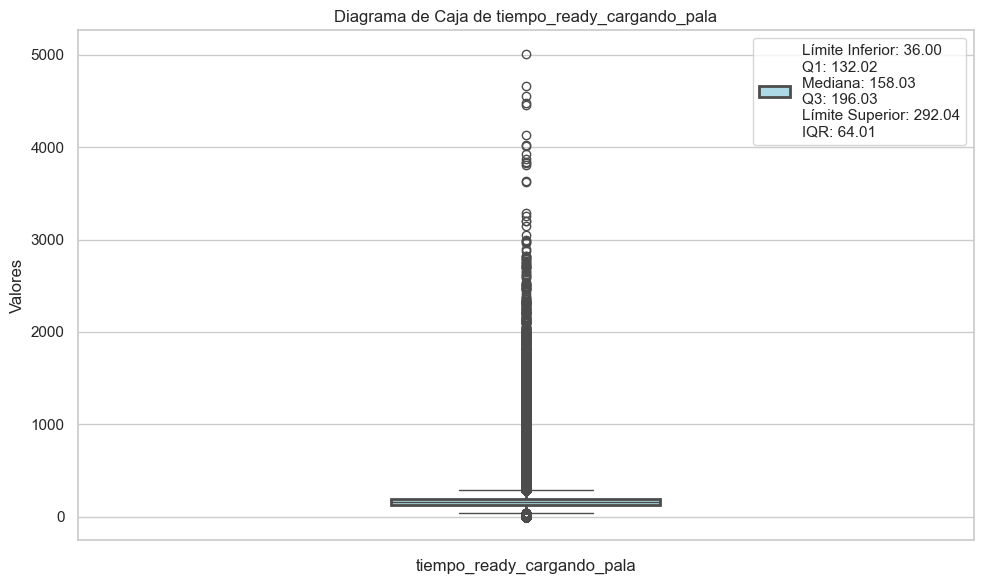

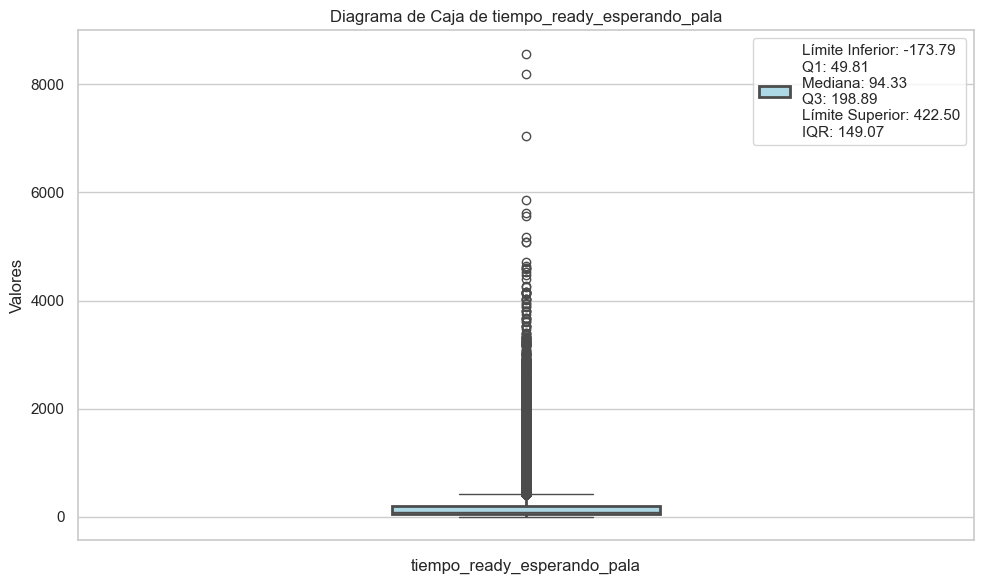

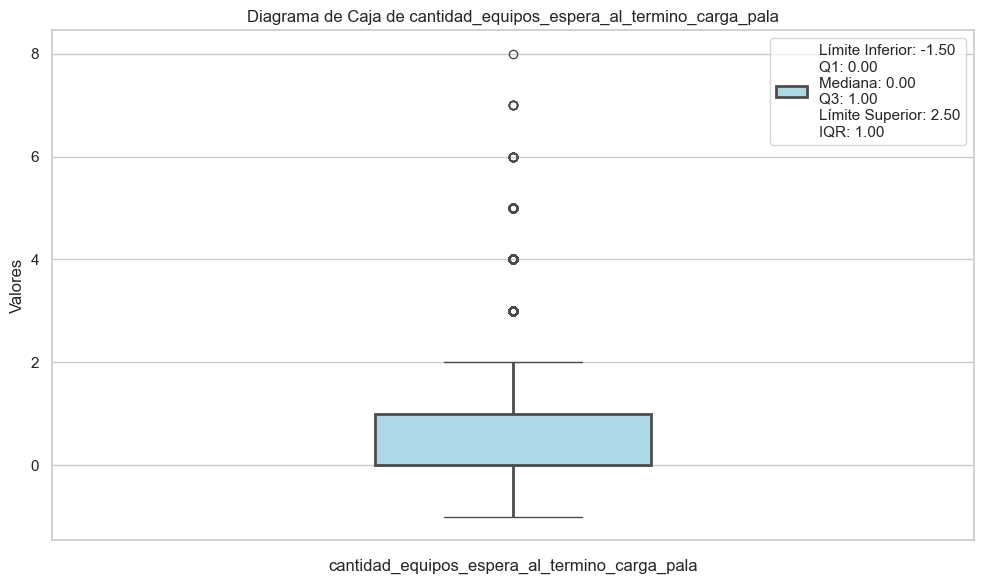

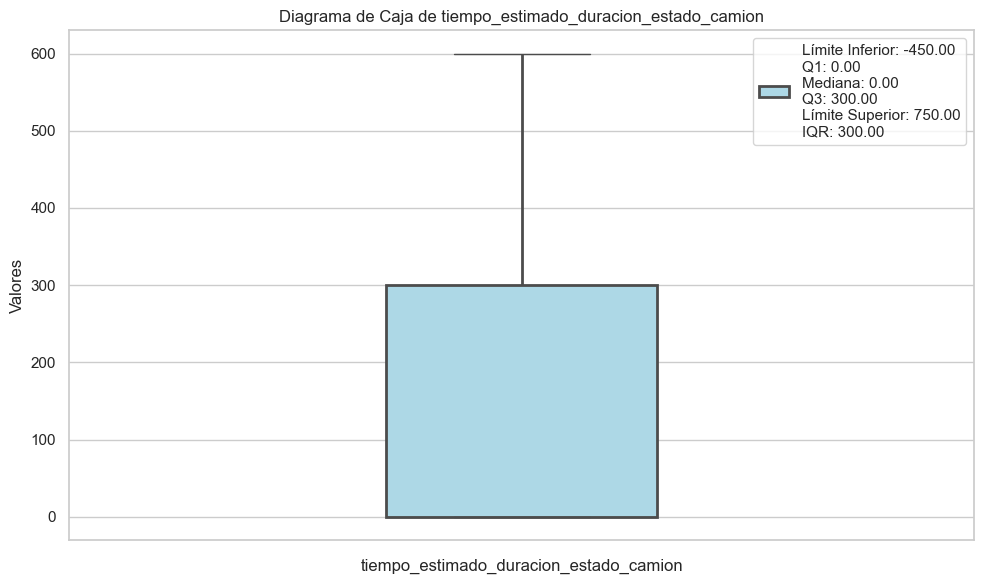

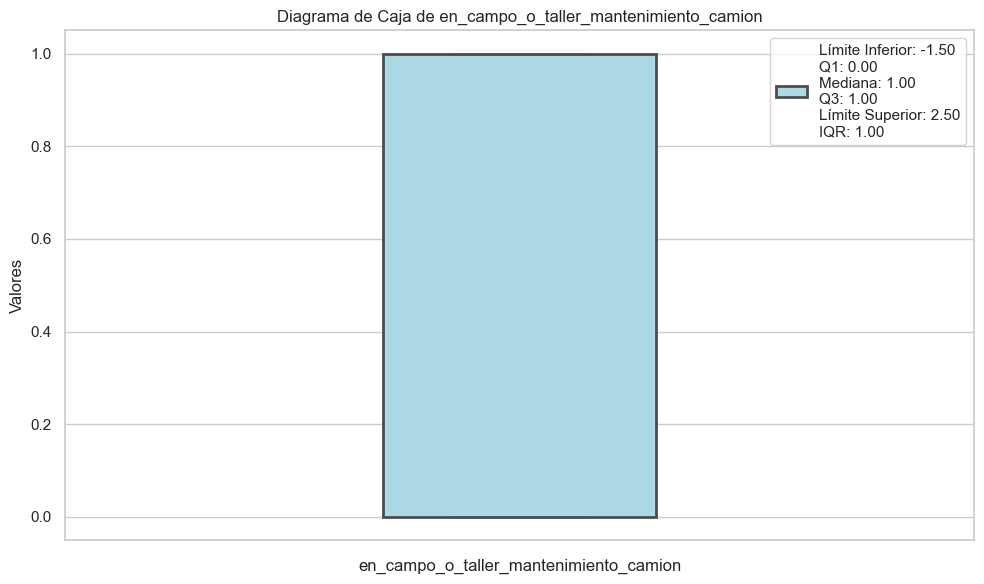

...

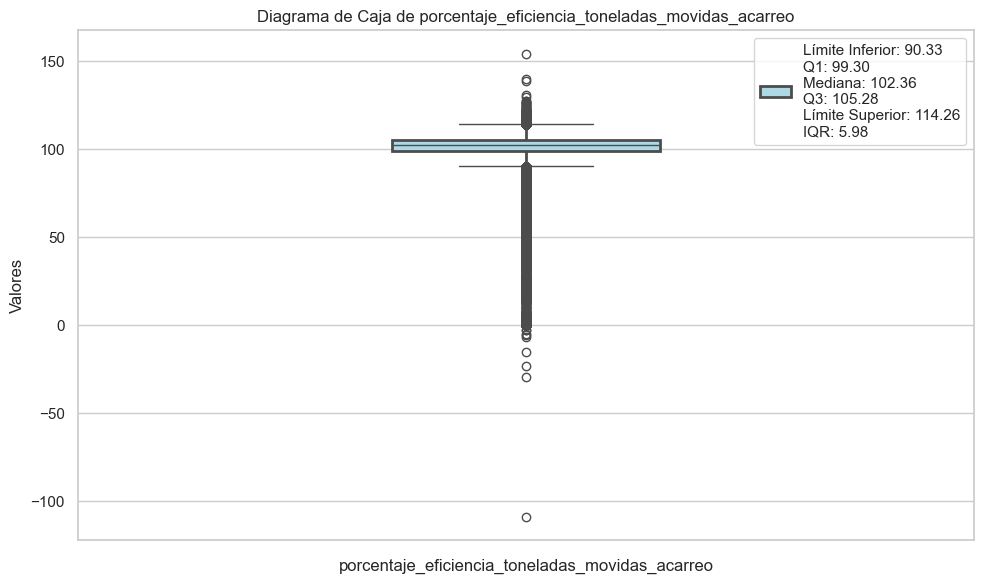

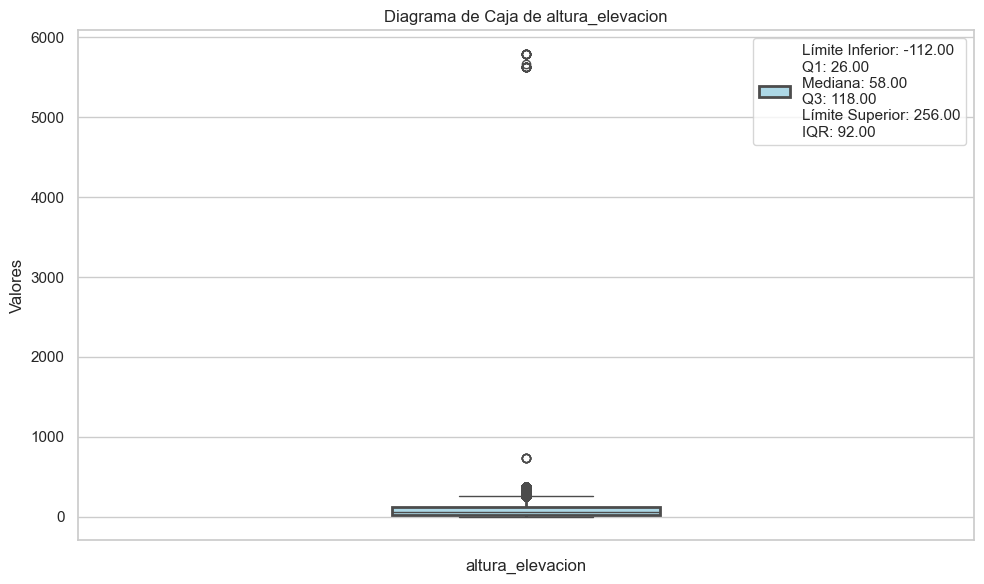

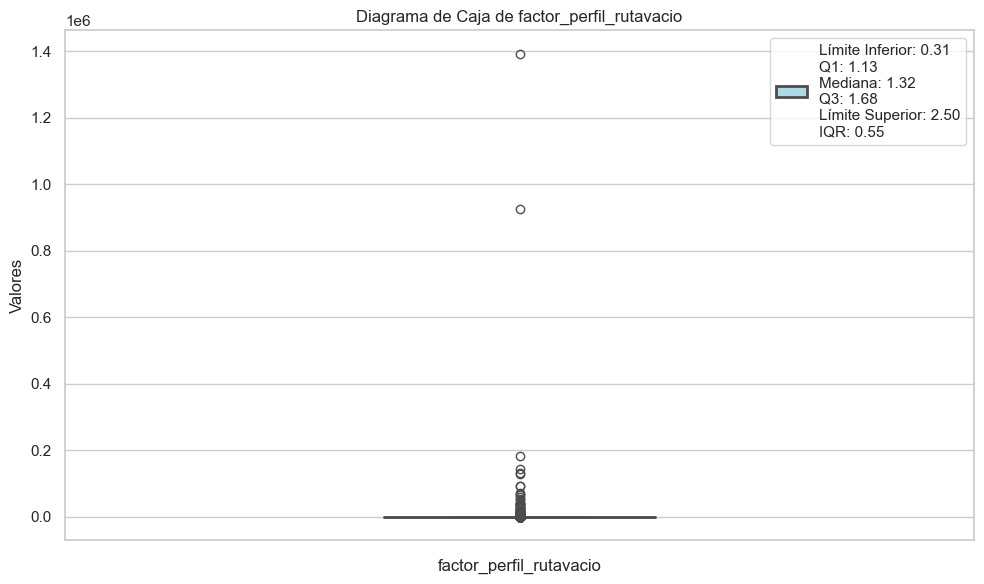

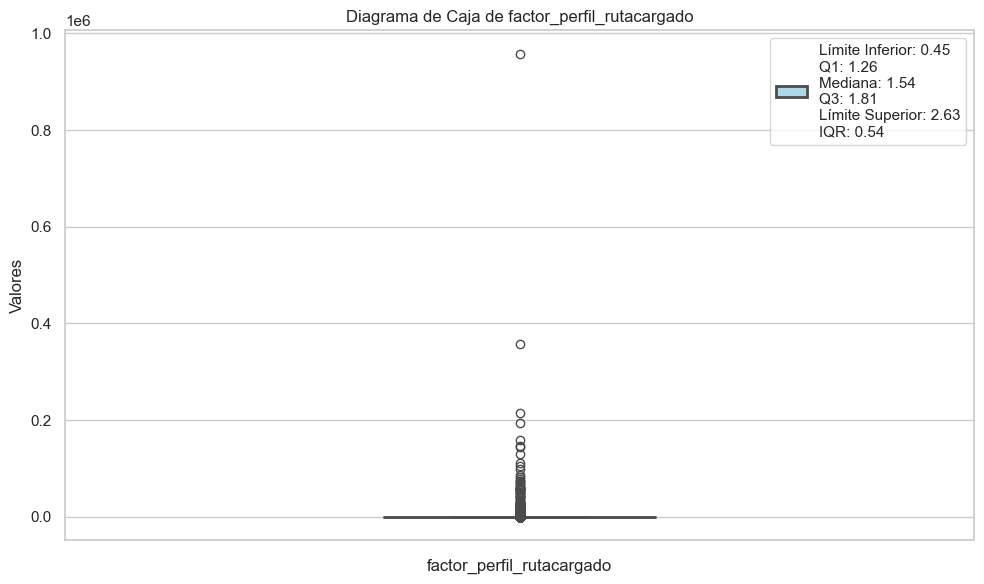

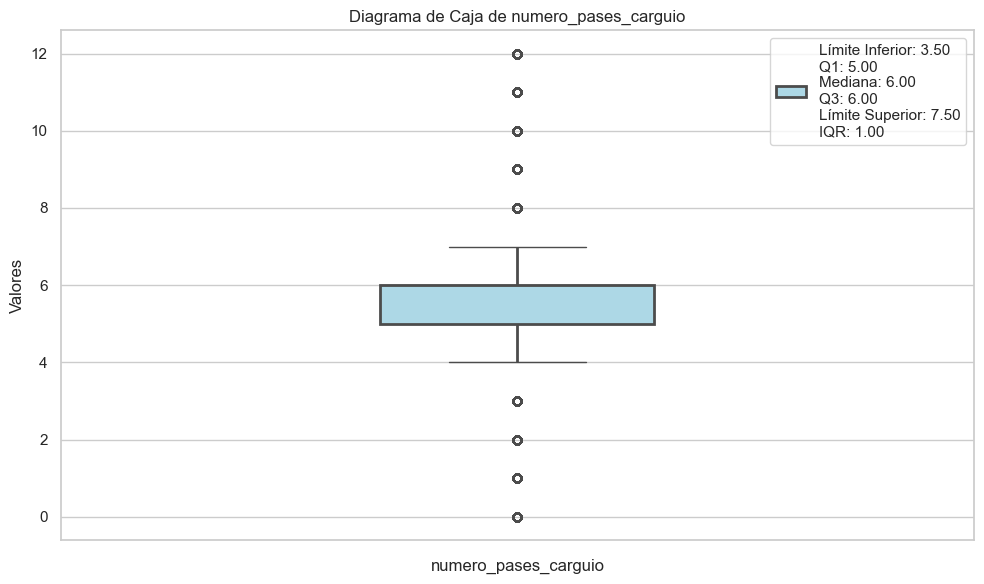

In [291]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Identificar las columnas numéricas y categóricas
columnas_numericas = datos.select_dtypes(include=['int', 'float']).columns

# Excluir las columnas que comienzan con 'id'
columnas_a_excluir = [col for col in datos.columns if col.startswith('id')]

# Filtrar las columnas numéricas que no están en columnas_a_excluir
columnas_a_incluir = [col for col in columnas_numericas if col not in columnas_a_excluir]

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Crear diagramas de caja con bigotes como líneas y una leyenda
for columna in columnas_a_incluir:
    plt.figure(figsize=(10, 6))
    
    # Configurar el estilo de la caja y los bigotes
    boxprops = {'facecolor': 'lightblue', 'linewidth': 2}
    whiskerprops = {'linewidth': 2}
    
    sns.boxplot(data=datos, y=columna, boxprops=boxprops, whiskerprops=whiskerprops, width=0.3)
    
    plt.title(f'Diagrama de Caja de {columna}')
    plt.xlabel(columna)
    plt.ylabel("Valores")
    
    # Calcular estadísticas
    mediana = datos[columna].median()
    Q1 = datos[columna].quantile(0.25)
    Limite_inferior = datos[columna].quantile(0.25) - 1.5 * (datos[columna].quantile(0.75) - datos[columna].quantile(0.25))
    Q3 = datos[columna].quantile(0.75)
    Limite_superior = datos[columna].quantile(0.75) + 1.5 * (datos[columna].quantile(0.75) - datos[columna].quantile(0.25))
    IQR = Q3 - Q1
    
    # Crear la leyenda
    leyenda = f'Límite Inferior: {Limite_inferior:.2f}\nQ1: {Q1:.2f}\nMediana: {mediana:.2f}\nQ3: {Q3:.2f}\nLímite Superior: {Limite_superior:.2f}\nIQR: {IQR:.2f}'
    
    # Colocar la leyenda fuera del gráfico, en el lado derecho superior
    plt.legend([leyenda], loc='upper right', bbox_to_anchor=(1, 1))
    
    # Ajustar la disposición de elementos en el gráfico
    plt.tight_layout()
    
    plt.show()

### 3.3 Identificacion los Valores Outliers

In [5]:
# Asegúrate de que 'selected_variable' esté definida antes
selected_variable = 'tiempo_ready_acarreo_cola'  # Reemplaza 'nombre_de_tu_variable' con el nombre real de tu variable

# Seleccionar la columna de datos
data_variable = datos[selected_variable]

# Calcular estadísticas descriptivas
q1 = data_variable.quantile(0.25)
q3 = data_variable.quantile(0.75)
iqr = q3 - q1

# Calcular límites para identificar outliers
lower_limit = q1 - 1.5 * iqr
upper_limit = q3 + 1.5 * iqr

# Filtrar registros considerados outliers
outliers = datos[(data_variable < lower_limit) | (data_variable > upper_limit)]

# Ordenar el DataFrame por la variable principal en orden descendente
outliers = outliers.sort_values(by=selected_variable, ascending=False)

# Seleccionar columnas adicionales
additional_columns = ['nombre_equipo', 'tiempo_llegada_camion', 'nombre_locacion_carga', 'nombre_zona_descarga']  # Agrega más columnas según sea necesario

# Mostrar los valores atípicos junto con columnas adicionales
outliers_with_additional_columns = outliers[[selected_variable] + additional_columns]

# Mostrar el DataFrame de valores atípicos
outliers_with_additional_columns.head(10)

,tiempo_ready_acarreo_cola,nombre_equipo,tiempo_llegada_camion,nombre_locacion_carga,nombre_zona_descarga
277045,5317.986187,CA17,2023-04-17 11:37:53.341000-05:00,MJ785-C1S_1,CHANCADORA_SUL
358444,5096.891000,CA26,2023-08-26 08:35:52.743000-05:00,MJ632-C2,BOT-738-DES_N4
349394,4894.921359,CA23,2023-08-12 10:32:52.227000-05:00,MJ750-C1O_3,STK-762-OXI4_N_A
239503,4788.186000,CA05,2023-02-12 10:52:05.250000-05:00,MJ815-C10,BOT-695-RIP_N
349403,4388.448116,CA26,2023-08-12 10:41:50.378000-05:00,MJ750-C1O_3,STK-762-OXI4_N_A
112730,4095.443871,CA15,2022-07-07 13:53:44.516000-05:00,MJ797-C1S_1,STK-809-SUL10-SUL07
327686,3920.044729,CA11,2023-07-08 16:10:04.992000-05:00,MJ750-C1O_3,STK-762-OXI3_N_A
306030,3420.120541,CA06,2023-06-04 17:33:16.736000-05:00,MJ813-C1S_1,CHANCADORA_SUL
75395,3349.094557,CA25,2022-05-08 15:01:44.080000-05:00,MJ584-C3,CHANCADORA_SUL
31057,3245.681551,CA09,2022-02-26 17:26:09.438000-05:00,MJ780-C1S_2,STK-797-SUL9_D


In [8]:
import pandas as pd
import plotly.express as px

# Calcular el tiempo total por ruta
outliers_with_additional_columns['tiempo_total'] = outliers_with_additional_columns['tiempo_ready_acarreo_cola']

# Agrupar por ruta y calcular estadísticas
ruta_stats = outliers_with_additional_columns.groupby(['nombre_locacion_carga', 'nombre_zona_descarga'])['tiempo_total'].agg(['mean', 'count']).reset_index()

# Ordenar por tiempo promedio descendente
ruta_stats = ruta_stats.sort_values(by='mean', ascending=False)

# Crear gráfico interactivo con Plotly Express
fig = px.bar(ruta_stats, x='mean', y='nombre_locacion_carga', color='nombre_zona_descarga',
             text='mean', orientation='h', title='Tiempo promedio de ready acarreo cola por ruta',
             labels={'mean': 'Tiempo promedio'},
             height=600)

# Ajustar el diseño para mejorar la visibilidad del eje y
fig.update_layout(
    yaxis=dict(
        tickmode='linear',
        tick0=0,
        dtick=1,
        tickangle=45,  # Rotar los nombres
        tickfont=dict(size=10)  # Reducir el tamaño del texto
    )
)

# Mostrar el gráfico
fig.show()

# Obtener ruta con mayor tiempo promedio
ruta_mas_lenta = ruta_stats.iloc[0]

print(f"La ruta con mayor tiempo promedio de ready acarreo cola es de {ruta_mas_lenta['nombre_locacion_carga']} a {ruta_mas_lenta['nombre_zona_descarga']}.")
print(f"Con un tiempo promedio de: {ruta_mas_lenta['mean']} y un total de {ruta_mas_lenta['count']} registros.")

C:\Users\BryanInche-MS4M\AppData\Local\Temp\ipykernel_12432\3880490819.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



La ruta con mayor tiempo promedio de ready acarreo cola es de MJ797-C1S_1 a STK-809-SUL10-SUL07.
Con un tiempo promedio de: 4095.443871 y un total de 1 registros.


In [11]:
ruta_stats

,nombre_locacion_carga,nombre_zona_descarga,mean,count
481,MJ797-C1S_1,STK-809-SUL10-SUL07,4095.443871,1
453,MJ750-C1O_3,STK-762-OXI3_N_A,3920.044729,1
454,MJ750-C1O_3,STK-762-OXI4_N_A,3562.669821,3
345,MJ632-C2,BOT-738-DES_N4,3247.131500,2
471,MJ780-C1S_2,STK-797-SUL9_D,3245.681551,1
...,...,...,...,...
216,MJ560-C1,BOT-770-RIP_N,1292.652295,1
506,MJ815-C10,IPT-680_PisoPH02,1292.479516,1
287,MJ596-C2,STK-774-OXI1_S,1292.156000,1
305,MJ608-C1,STK-750-OXI1_S_1,1291.548000,1


### 3.4 *Matriz de Correlacion (Sin Tratamiento de Outliers)*
- Rango de valores: La correlación varía en un rango de -1 a 1.  
Un **valor de 1** indica una correlación positiva perfecta, lo que significa que las dos variables aumentan juntas de manera lineal.  
Un **valor de -1** indica una correlación negativa perfecta, lo que significa que una variable aumenta mientras que la otra disminuye de manera lineal.  
Un **valor cercano a 0** indica una correlación débil o inexistente.
- Dirección de la correlación:   
***|r| < 0.3: Se considera una correlación débil.  
0.3 ≤ |r| < 0.7: Se considera una correlación moderada.  
|r| ≥ 0.7: Se considera una correlación fuerte.***  

    Una correlación positiva significa que a medida que una variable aumenta, la otra también tiende a aumentar.  
    Una correlación negativa indica que a medida que una variable aumenta, la otra tiende a disminuir.


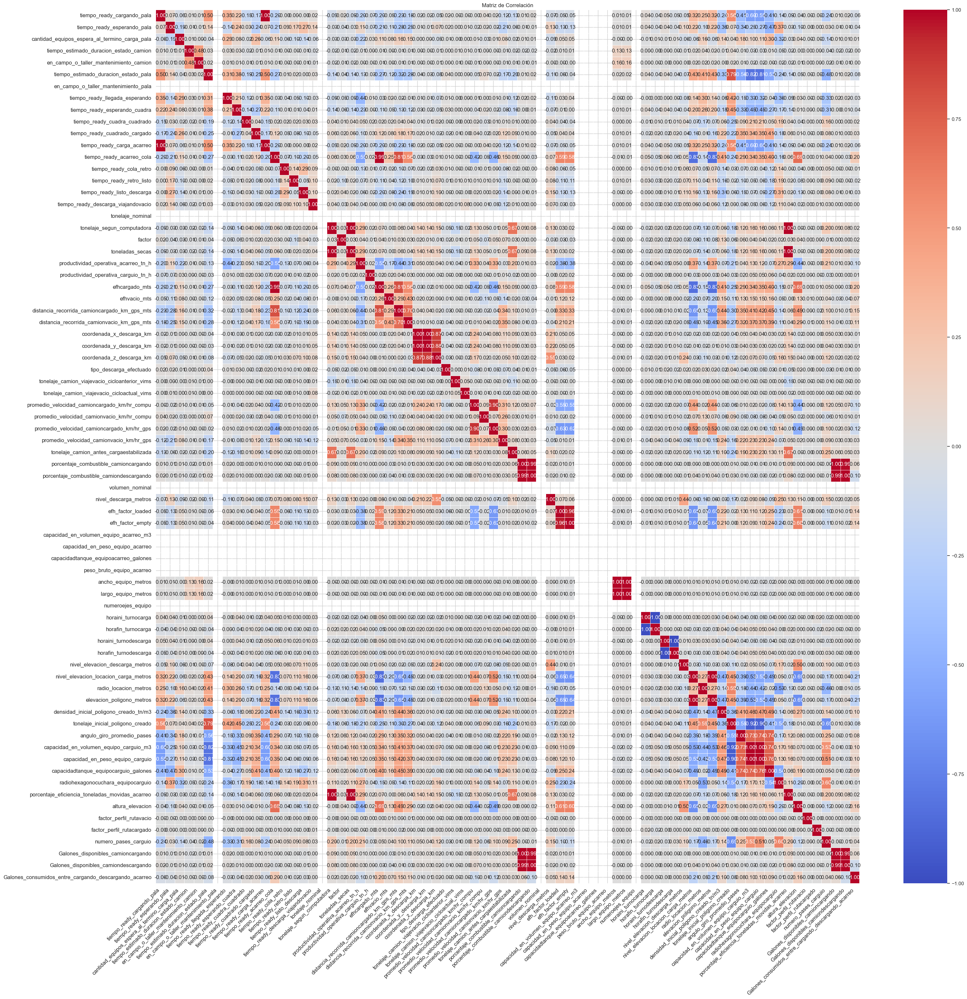

In [336]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'datos'

# Identificar las columnas numéricas
columnas_numericas = datos.select_dtypes(include=['int', 'float']).columns

# Excluir las columnas que comienzan con 'id'
columnas_numericas = [col for col in columnas_numericas if not col.startswith('id')]

# Crear una matriz de correlación
matriz_correlacion = datos[columnas_numericas].corr()

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Aumentar el tamaño del gráfico para mostrar más detalles
plt.figure(figsize=(35, 35))

# Crear un mapa de calor (heatmap) de la matriz de correlación con desplazamiento habilitado
ax = sns.heatmap(matriz_correlacion, annot=True, fmt=".2f", cmap="coolwarm", linewidths=.5)

# Agregar etiquetas a los ejes X e Y
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, horizontalalignment='right', fontsize=8)

# Ajustar el tamaño de las fuentes de los nombres de las variables (eje x)
ax.tick_params(axis='x', labelsize=12)

# Ajustar el tamaño de las fuentes de los nombres de las variables (eje y)
ax.tick_params(axis='y', labelsize=12)

plt.title("Matriz de Correlación")
plt.show()

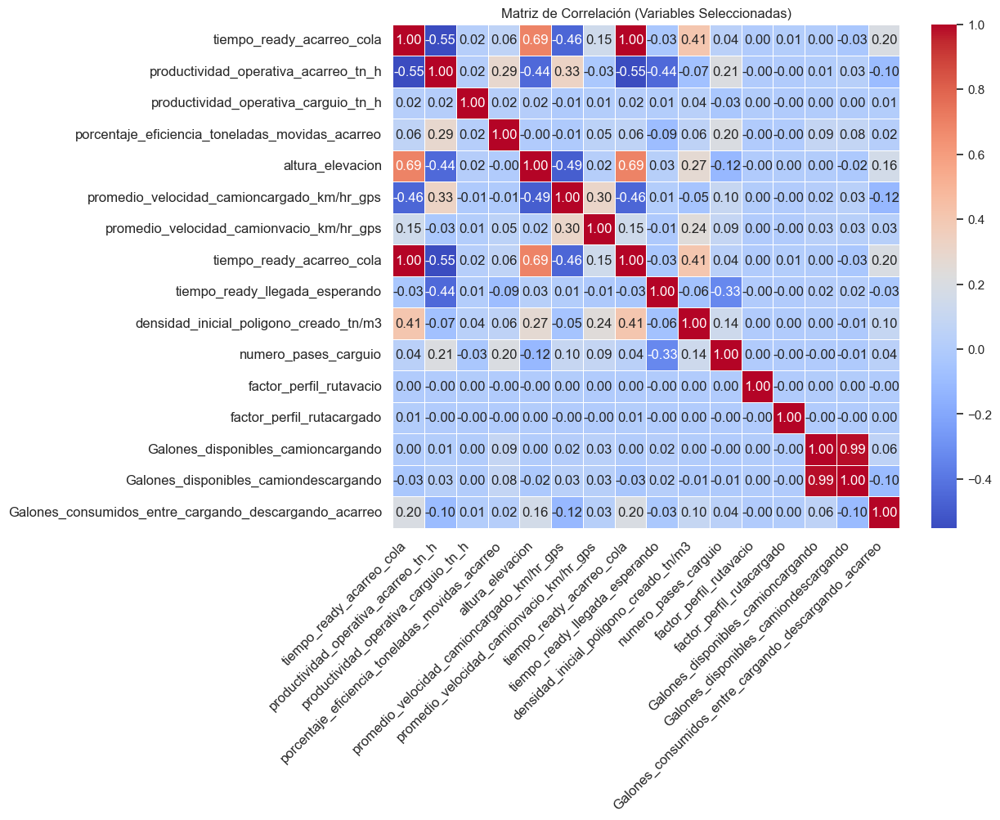

In [348]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'datos'

# Lista de variables que deseas analizar
variables_a_analizar = ['tiempo_ready_acarreo_cola','productividad_operativa_acarreo_tn_h', 'productividad_operativa_carguio_tn_h',
                     'porcentaje_eficiencia_toneladas_movidas_acarreo', 'altura_elevacion', 
                     'promedio_velocidad_camioncargado_km/hr_gps','promedio_velocidad_camionvacio_km/hr_gps','tiempo_ready_acarreo_cola', 
                     'tiempo_ready_llegada_esperando','densidad_inicial_poligono_creado_tn/m3', 'numero_pases_carguio', 'factor_perfil_rutavacio',
                     'factor_perfil_rutacargado', 'Galones_disponibles_camioncargando', 'Galones_disponibles_camiondescargando', 
                     'Galones_consumidos_entre_cargando_descargando_acarreo']

# Filtrar el DataFrame para incluir solo las variables de interés
datos_subset = datos[variables_a_analizar]

# Crear una matriz de correlación para el subconjunto de variables
matriz_correlacion = datos_subset.corr()

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Aumentar el tamaño del gráfico para mostrar más detalles
plt.figure(figsize=(10, 8))

# Crear un mapa de calor (heatmap) de la matriz de correlación con desplazamiento habilitado
ax = sns.heatmap(matriz_correlacion, annot=True, fmt=".2f", cmap="coolwarm", linewidths=.5)

# Agregar etiquetas a los ejes X e Y
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, horizontalalignment='right', fontsize=8)

# Ajustar el tamaño de las fuentes de los nombres de las variables (eje x)
ax.tick_params(axis='x', labelsize=12)

# Ajustar el tamaño de las fuentes de los nombres de las variables (eje y)
ax.tick_params(axis='y', labelsize=12)

plt.title("Matriz de Correlación (Variables Seleccionadas)")
plt.show()


# 4. **PREPARACION DE LOS DATOS**

### *4.1 TRATAMIENTO DE OUTLIERS*

- Eliminar los valores atípicos:

Este enfoque implica eliminar directamente los valores atípicos de tu conjunto de datos. Puedes hacerlo eliminando las filas que contienen valores atípicos en una o varias columnas.
Ventajas:
Puede mejorar la calidad de tus análisis al eliminar valores que puedan distorsionar tus resultados.
Puede ser útil si los outliers son errores de medición o valores claramente incoherentes.
Desventajas:
Puedes perder información valiosa al eliminar datos.
No siempre es la mejor opción, ya que algunos outliers pueden ser legítimos y relevantes para tu análisis.

- Limitar los valores atípicos a los límites del bigote (capping):

En este enfoque, en lugar de eliminar los valores atípicos, los limitas estableciendo un valor máximo y mínimo basado en los límites del bigote en un diagrama de caja.
Ventajas:
Conserva todos los datos, evitando la pérdida de información.
Puede ayudar a reducir el impacto de los outliers sin eliminarlos por completo.
Desventajas:
Puede introducir sesgo en tus datos si no se seleccionan adecuadamente los límites de corte.
No es apropiado para todos los casos, ya que puede no ser una solución efectiva para valores atípicos extremadamente alejados.

Limitamos los valores outilers a Limite Superior y Inferior

In [26]:
import pandas as pd

# Supongamos que tienes un DataFrame llamado 'datos'

# Obtener una lista de las columnas numéricas excluyendo las que comienzan con 'id'
columnas_numericas = [col for col in datos.select_dtypes(include=['int', 'float']).columns if not col.startswith('id')]

# Iterar a través de las columnas numéricas y limitar los valores atípicos
for columna in columnas_numericas:
    # Calcular el Q1 y Q3 de la columna
    Q1 = datos[columna].quantile(0.25)
    Q3 = datos[columna].quantile(0.75)

    # Calcular el rango intercuartilico (IQR)
    IQR = Q3 - Q1

    # Calcular los límites inferior y superior del bigote
    Limite_inferior = Q1 - 1.5 * IQR
    Limite_superior = Q3 + 1.5 * IQR

    # Limitar los valores atípicos a los límites del bigote en la columna
    datos[columna] = datos[columna].clip(lower=Limite_inferior, upper=Limite_superior)

# Los valores atípicos en todas las variables (que no comienzan con 'id') están limitados a los límites del bigote

### 4.2 *Matriz de Correlacion Con Tratamiento de Outliers (Limitando a Limite Superior y Inferior)*

Validamos que ahora los valores atipicos(Outliers) ahora estan limitados a los limites superior e inferior de los Bigotes del diagrama de cajas.

In [18]:
'''
# Identificar las columnas numéricas y categóricas
columnas_numericas = datos.select_dtypes(include=['int', 'float']).columns

# Excluir las columnas que comienzan con 'id'
columnas_a_excluir = [col for col in datos.columns if col.startswith('id')]

# Filtrar las columnas numéricas que no están en columnas_a_excluir
columnas_a_incluir = [col for col in columnas_numericas if col not in columnas_a_excluir]

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Crear diagramas de caja con bigotes como líneas y una leyenda
for columna in columnas_a_incluir:
    plt.figure(figsize=(10, 6))
    
    # Configurar el estilo de la caja y los bigotes
    boxprops = {'facecolor': 'lightblue', 'linewidth': 2}
    whiskerprops = {'linewidth': 2}
    
    sns.boxplot(data=datos, y=columna, boxprops=boxprops, whiskerprops=whiskerprops, width=0.3)
    
    plt.title(f'Diagrama de Caja de {columna}')
    plt.xlabel(columna)
    plt.ylabel("Valores")
    
    # Calcular estadísticas
    mediana = datos[columna].median()
    Q1 = datos[columna].quantile(0.25)
    Limite_inferior = datos[columna].quantile(0.25) - 1.5 * (datos[columna].quantile(0.75) - datos[columna].quantile(0.25))
    Q3 = datos[columna].quantile(0.75)
    Limite_superior = datos[columna].quantile(0.75) + 1.5 * (datos[columna].quantile(0.75) - datos[columna].quantile(0.25))
    IQR = Q3 - Q1
    
    # Crear la leyenda
    leyenda = f'Límite Inferior: {Limite_inferior:.2f}\nQ1: {Q1:.2f}\nMediana: {mediana:.2f}\nQ3: {Q3:.2f}\nLímite Superior: {Limite_superior:.2f}\nIQR: {IQR:.2f}'
    
    # Colocar la leyenda fuera del gráfico, en el lado derecho superior
    plt.legend([leyenda], loc='upper right', bbox_to_anchor=(1, 1))
    
    # Ajustar la disposición de elementos en el gráfico
    plt.tight_layout()
    
    plt.show()
'''

'\n# Identificar las columnas numéricas y categóricas\ncolumnas_numericas = datos.select_dtypes(include=[\'int\', \'float\']).columns\n\n# Excluir las columnas que comienzan con \'id\'\ncolumnas_a_excluir = [col for col in datos.columns if col.startswith(\'id\')]\n\n# Filtrar las columnas numéricas que no están en columnas_a_excluir\ncolumnas_a_incluir = [col for col in columnas_numericas if col not in columnas_a_excluir]\n\n# Configurar el estilo de Seaborn\nsns.set(style="whitegrid")\n\n# Crear diagramas de caja con bigotes como líneas y una leyenda\nfor columna in columnas_a_incluir:\n    plt.figure(figsize=(10, 6))\n    \n    # Configurar el estilo de la caja y los bigotes\n    boxprops = {\'facecolor\': \'lightblue\', \'linewidth\': 2}\n    whiskerprops = {\'linewidth\': 2}\n    \n    sns.boxplot(data=datos, y=columna, boxprops=boxprops, whiskerprops=whiskerprops, width=0.3)\n    \n    plt.title(f\'Diagrama de Caja de {columna}\')\n    plt.xlabel(columna)\n    plt.ylabel("Valores"

Graficamos la matriz de correlacion, luego de haber hecho el tratamiento de Valores Atipicos (Metodo de Limitar a los limites superior e inferior)

In [19]:
'''
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'datos'

# Identificar las columnas numéricas
columnas_numericas = datos.select_dtypes(include=['int', 'float']).columns

# Excluir las columnas que comienzan con 'id'
columnas_numericas = [col for col in columnas_numericas if not col.startswith('id')]

# Crear una matriz de correlación
matriz_correlacion = datos[columnas_numericas].corr()

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Aumentar el tamaño del gráfico para mostrar más detalles
plt.figure(figsize=(28, 25))

# Crear un mapa de calor (heatmap) de la matriz de correlación con desplazamiento habilitado
ax = sns.heatmap(matriz_correlacion, annot=True, fmt=".2f", cmap="coolwarm", linewidths=.5)

# Agregar etiquetas a los ejes X e Y
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, horizontalalignment='right')

plt.title("Matriz de Correlación")
plt.show()
'''

'\nimport pandas as pd\nimport seaborn as sns\nimport matplotlib.pyplot as plt\n\n# Supongamos que tienes un DataFrame llamado \'datos\'\n\n# Identificar las columnas numéricas\ncolumnas_numericas = datos.select_dtypes(include=[\'int\', \'float\']).columns\n\n# Excluir las columnas que comienzan con \'id\'\ncolumnas_numericas = [col for col in columnas_numericas if not col.startswith(\'id\')]\n\n# Crear una matriz de correlación\nmatriz_correlacion = datos[columnas_numericas].corr()\n\n# Configurar el estilo de Seaborn\nsns.set(style="whitegrid")\n\n# Aumentar el tamaño del gráfico para mostrar más detalles\nplt.figure(figsize=(28, 25))\n\n# Crear un mapa de calor (heatmap) de la matriz de correlación con desplazamiento habilitado\nax = sns.heatmap(matriz_correlacion, annot=True, fmt=".2f", cmap="coolwarm", linewidths=.5)\n\n# Agregar etiquetas a los ejes X e Y\nax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment=\'right\')\nax.set_yticklabels(ax.get_yticklabels()

<span style="color: yellow;">*Apartir de aplicar el tratamiento de los valores atipicos(Outliers), se concluye que en el analisis de la presente tabla "public.tp_cargadescarga (Ciclo Acarreo)"
no es adecuado hacer el tratamiento de valores atipicos, porque los valores atipicos que se presentan nos generan informacion valiosa para los posteriores analisis.*</span>

### 5. *ANALISIS DE DIAGRAMAS DE DISPERSION* 
- Identificar las variables: Cada punto en el gráfico representa una observación que contiene valores para ambas variables que se están comparando.
- Evaluar la fuerza de la relación: Cuanto más cerca estén los puntos de una línea recta, más fuerte será la relación. Si los puntos están más dispersos, la relación será más débil.
- Identificar patrones: Buscamos patrones en el gráfico, como líneas rectas, curvas, grupos de puntos o cualquier otro patrón que indique una relación entre las variables.

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



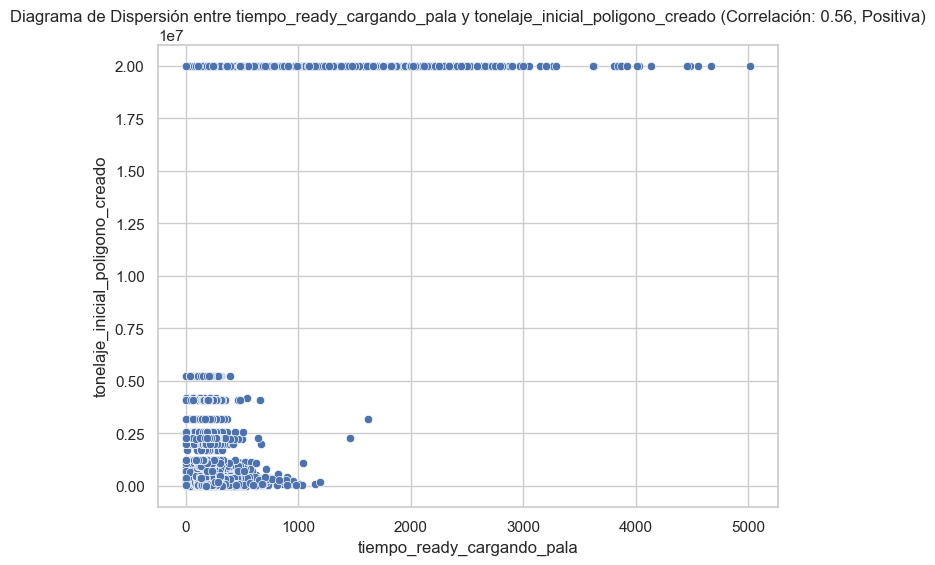

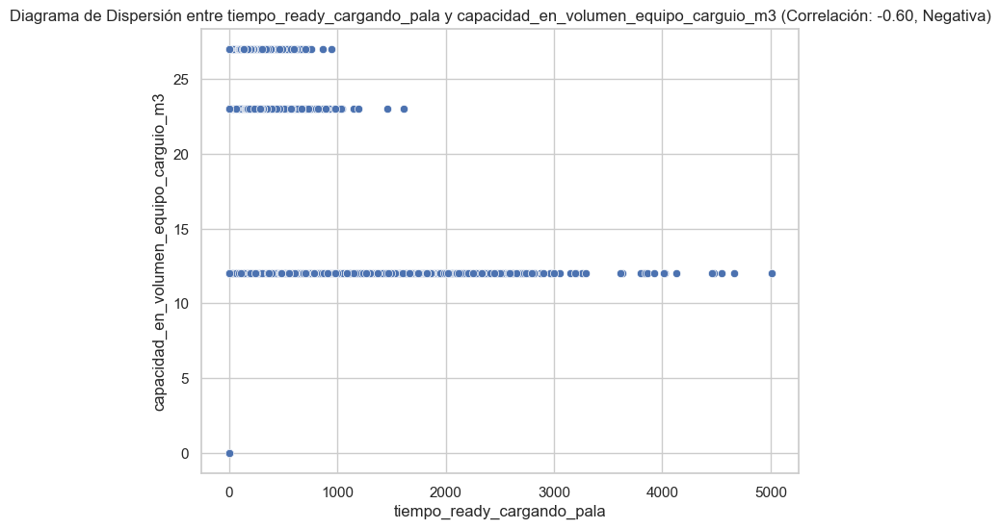

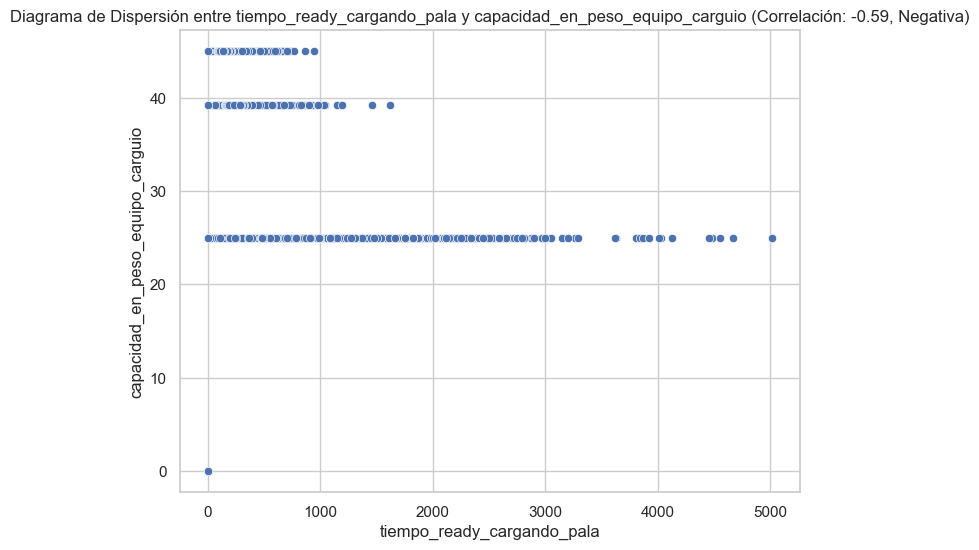

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



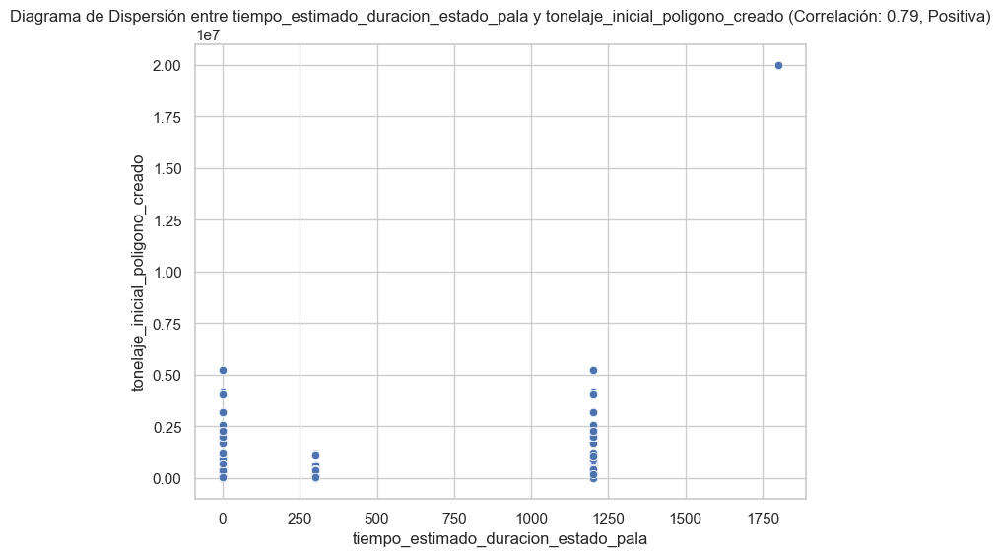

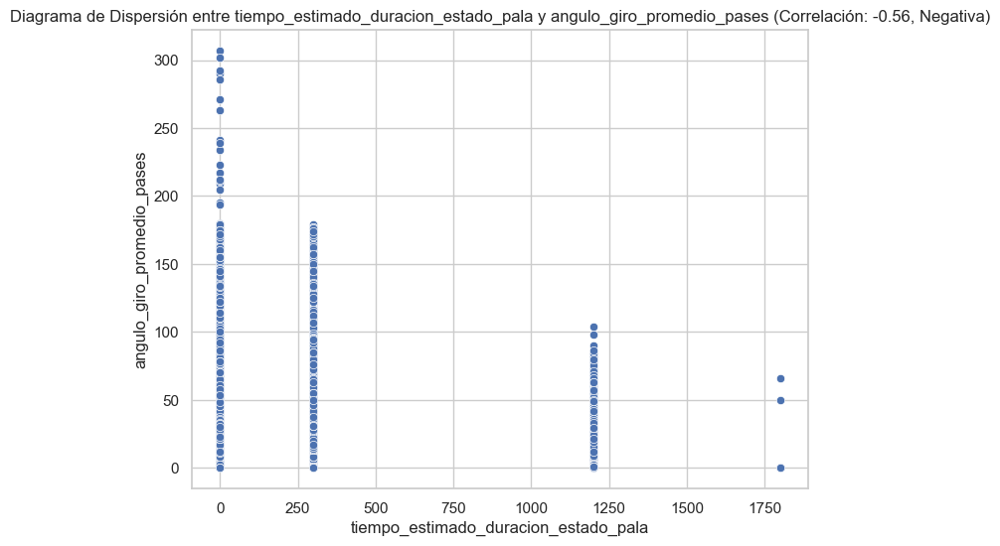

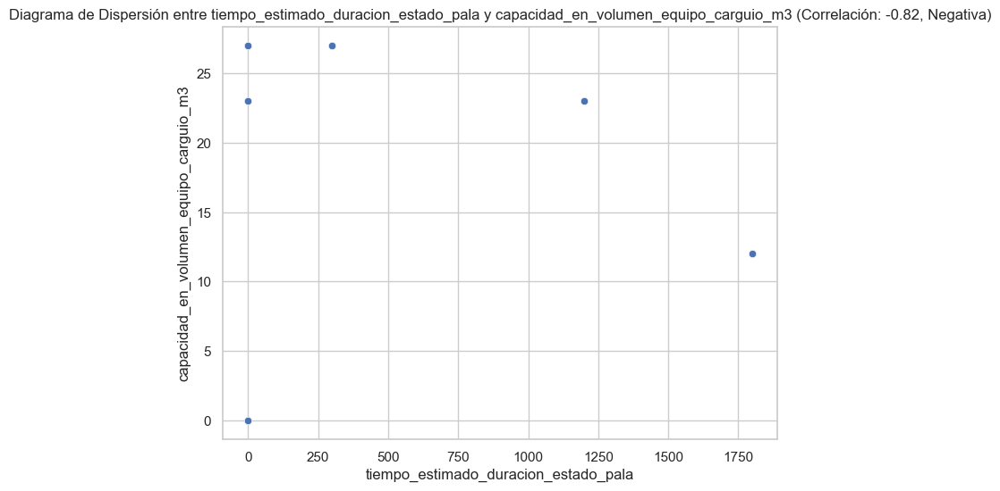

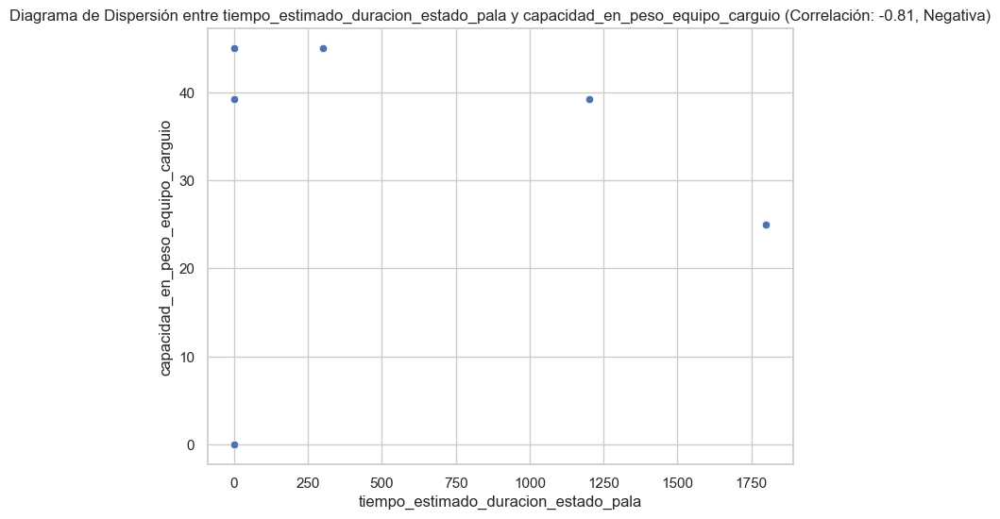

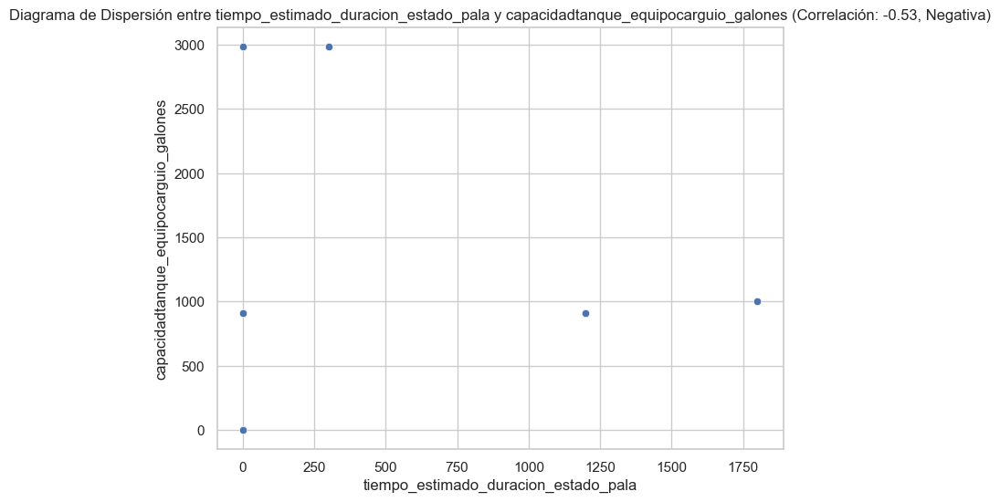

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



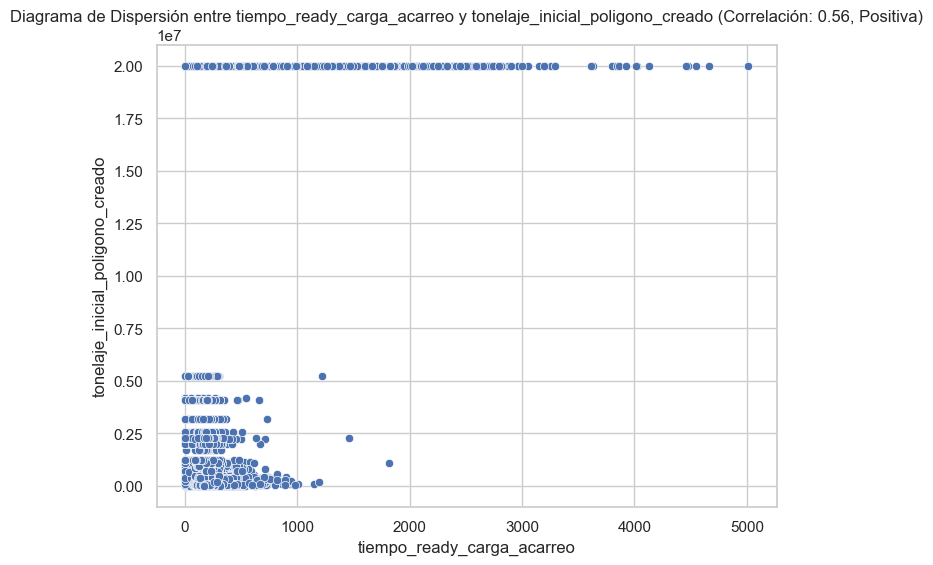

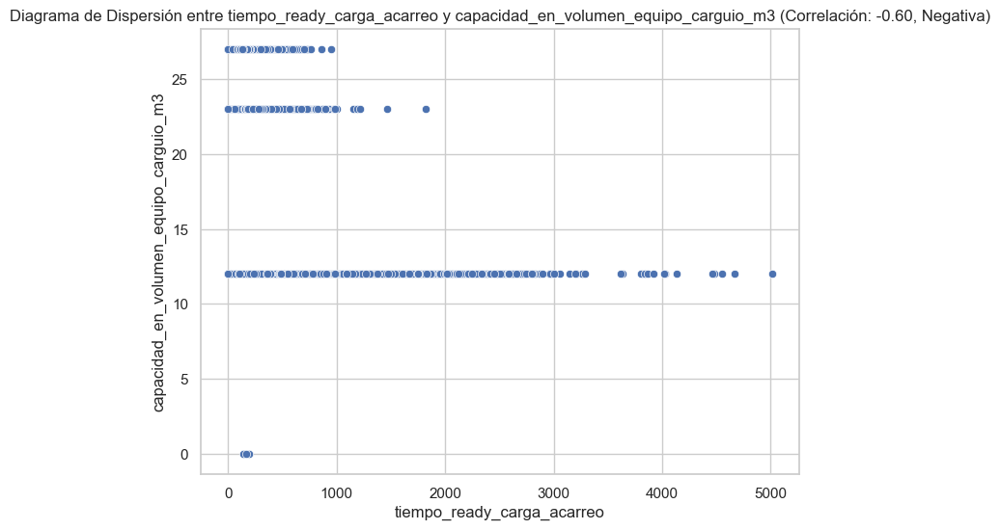

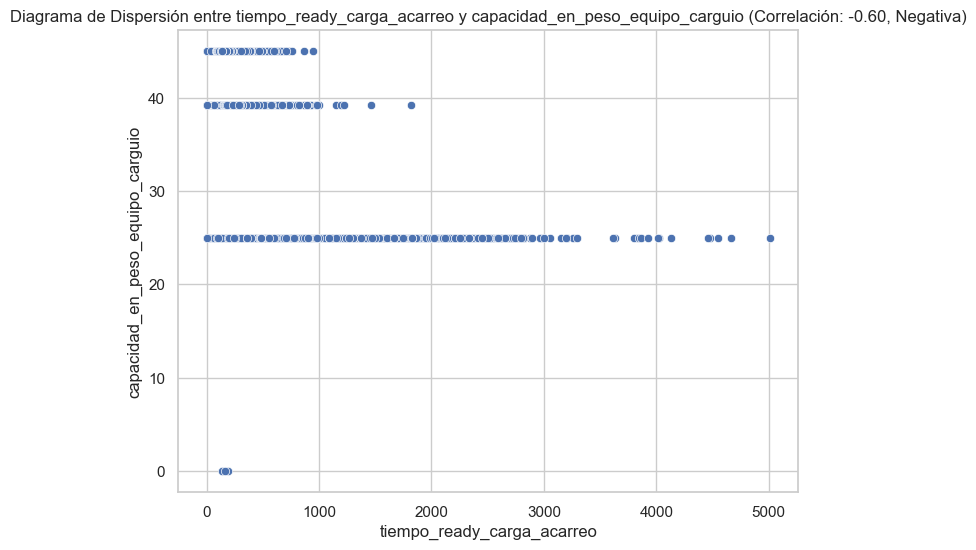

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



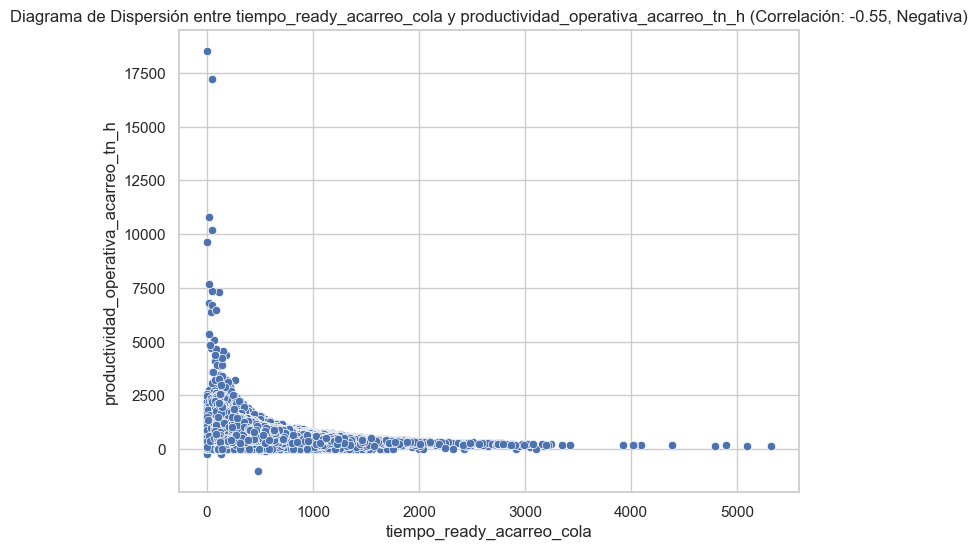

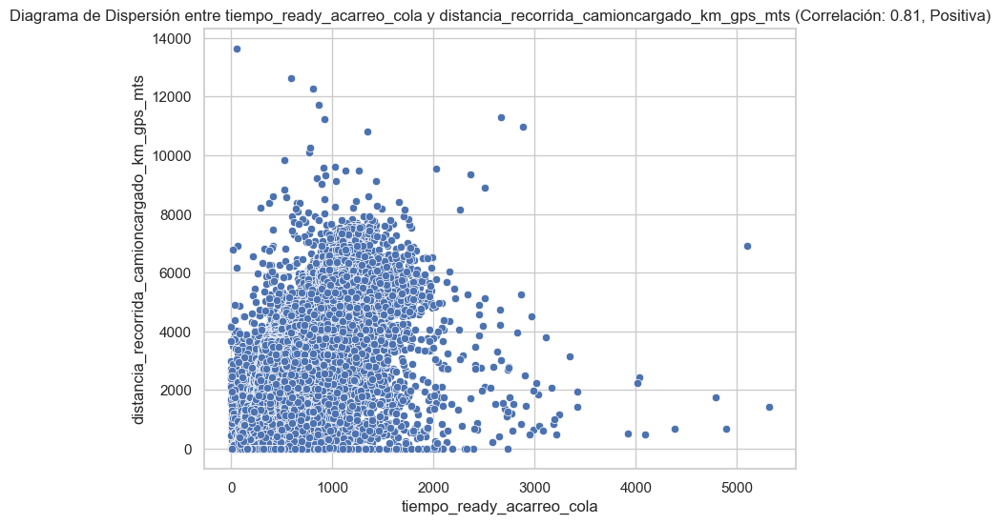

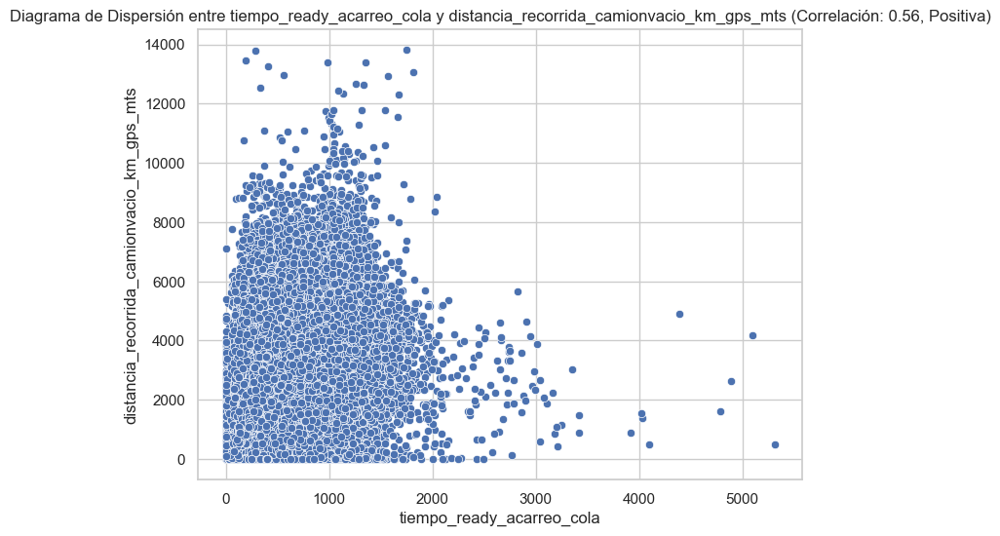

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



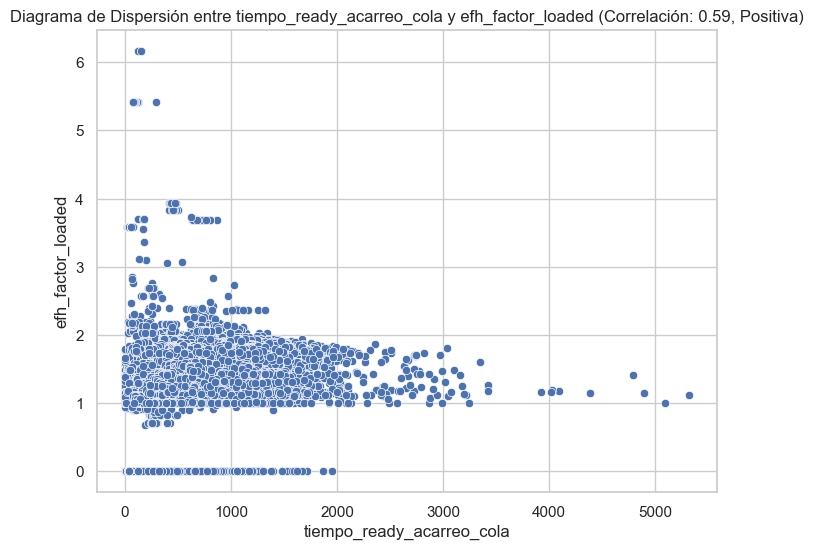

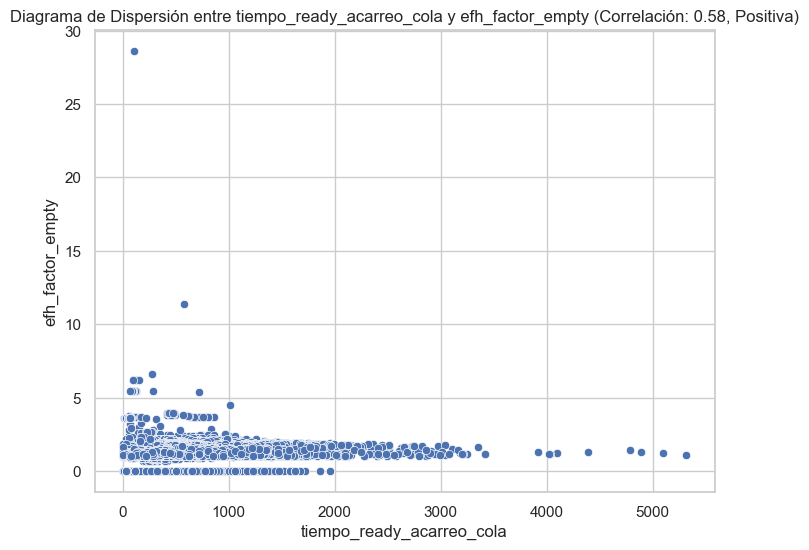

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



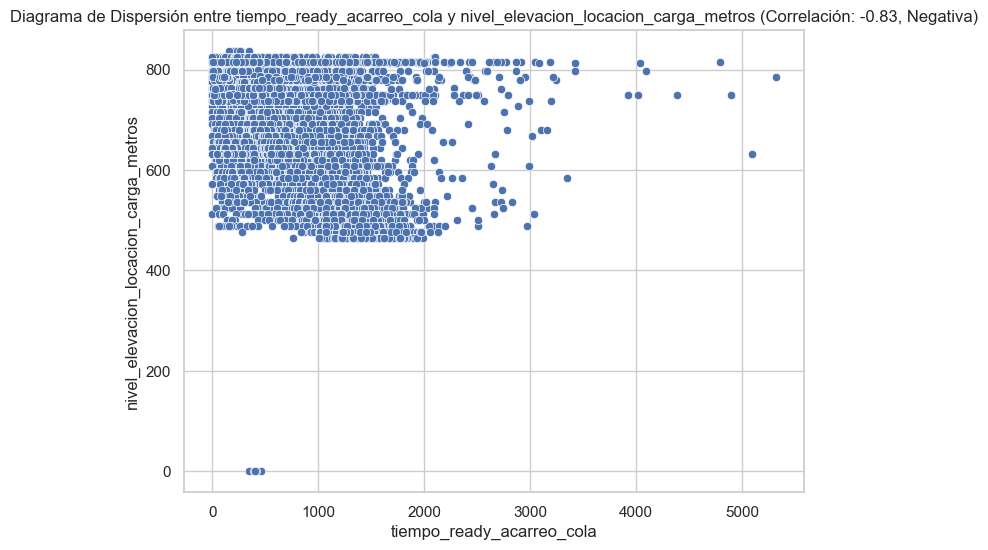

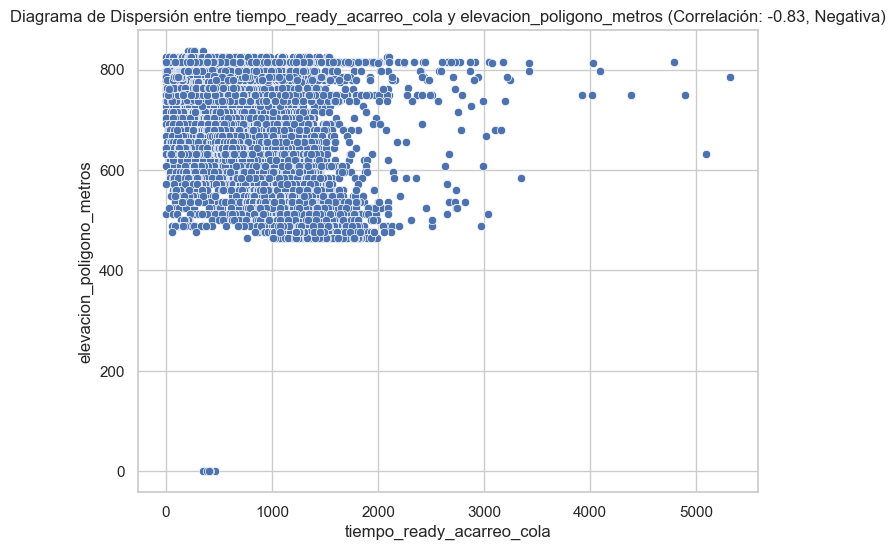

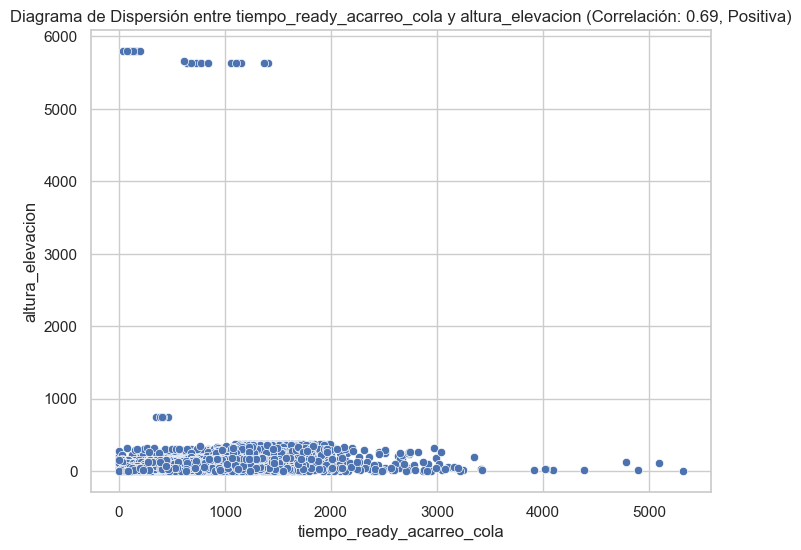

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



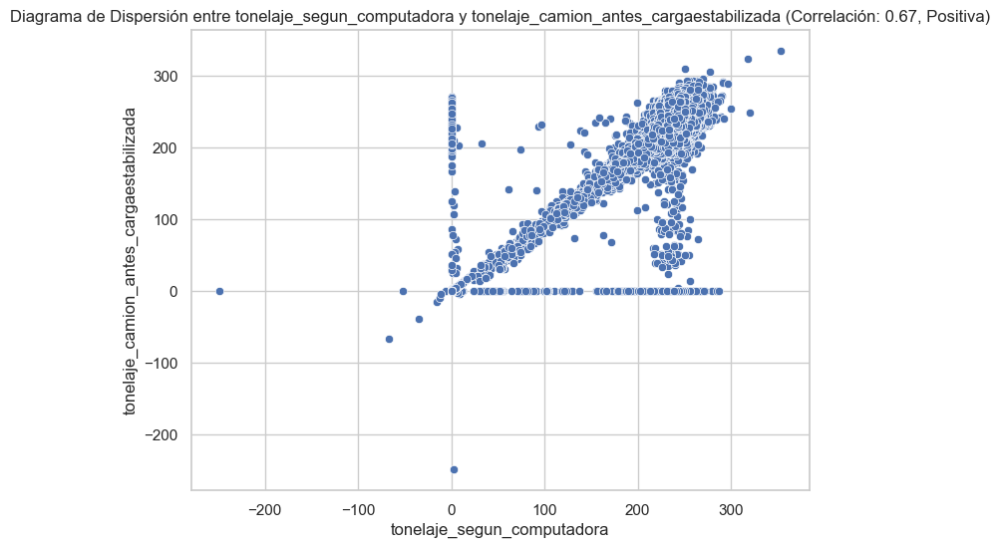

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



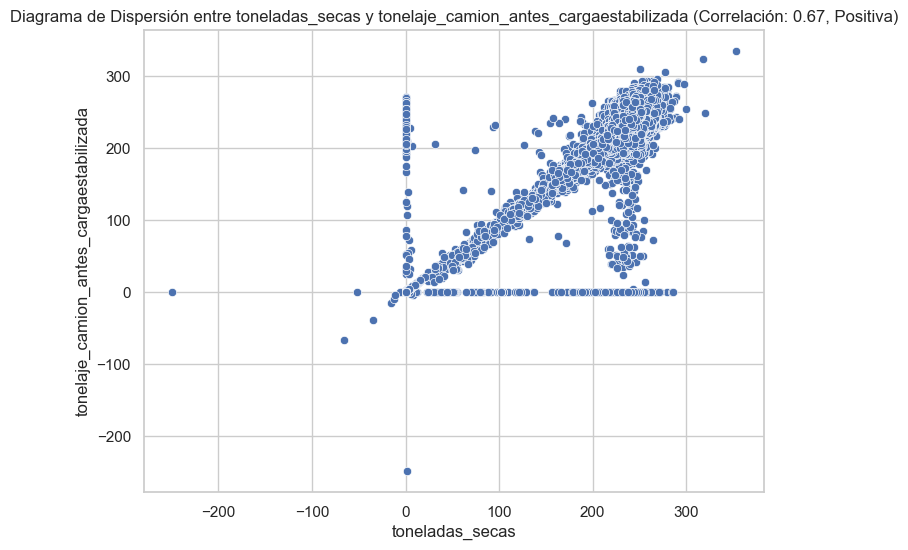

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



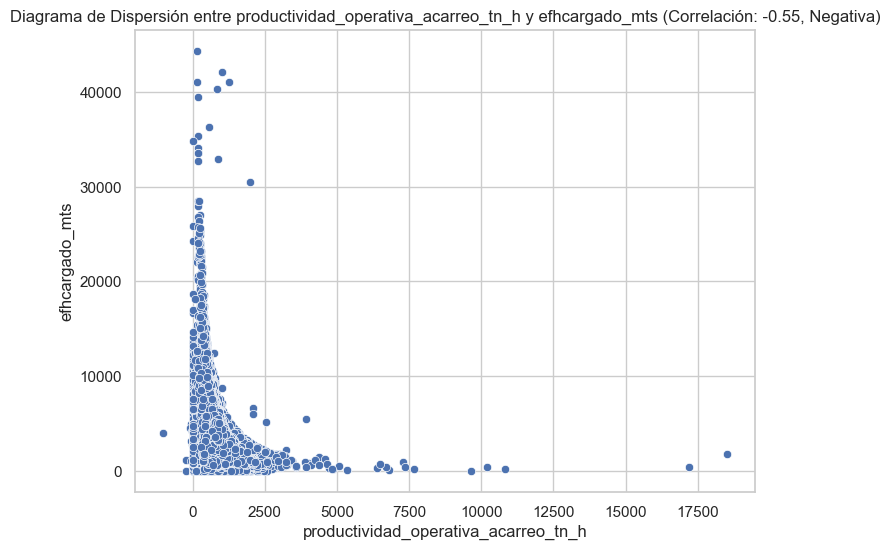

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



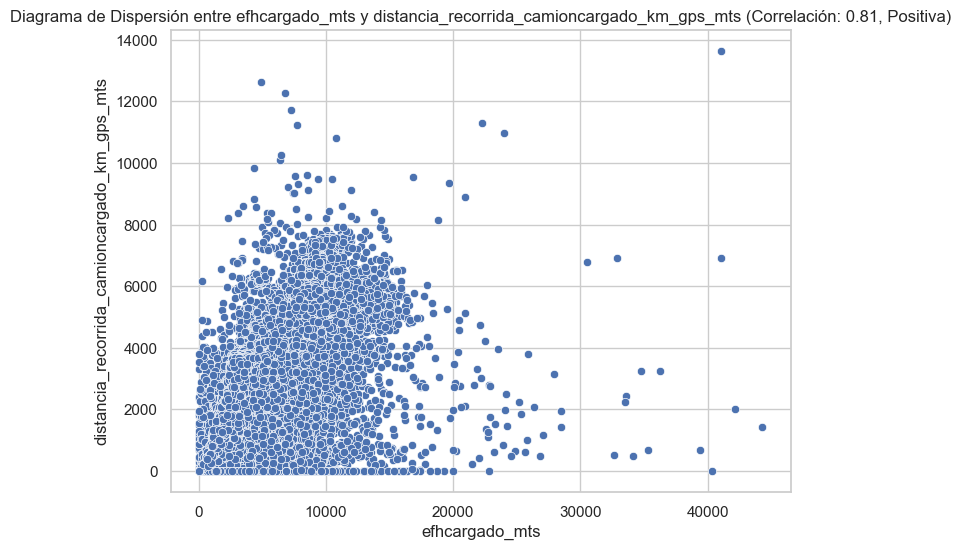

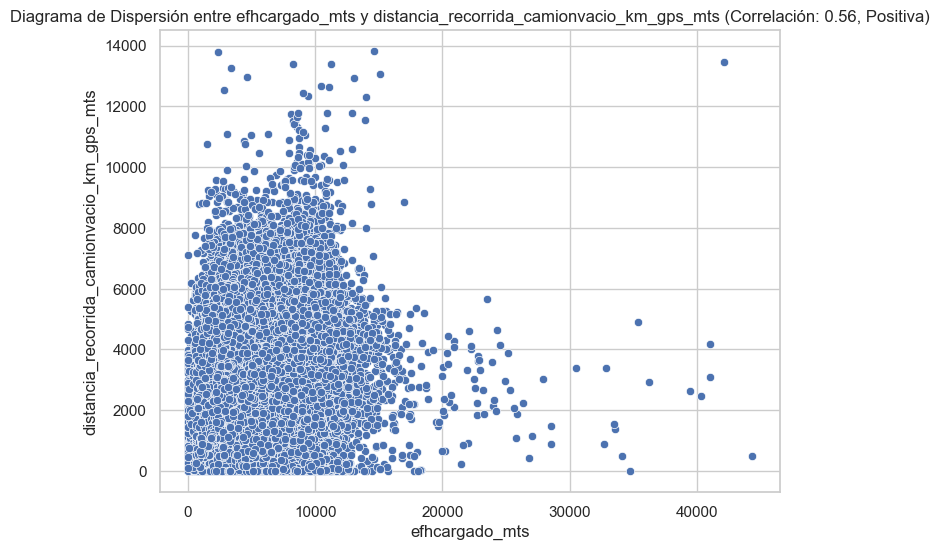

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



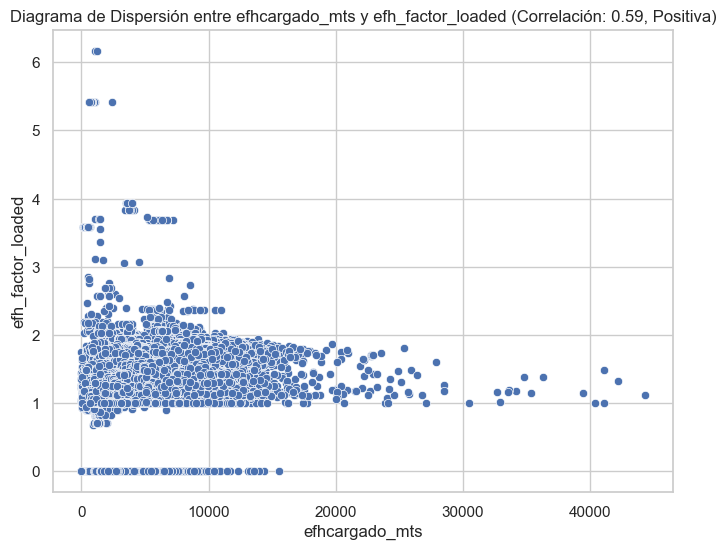

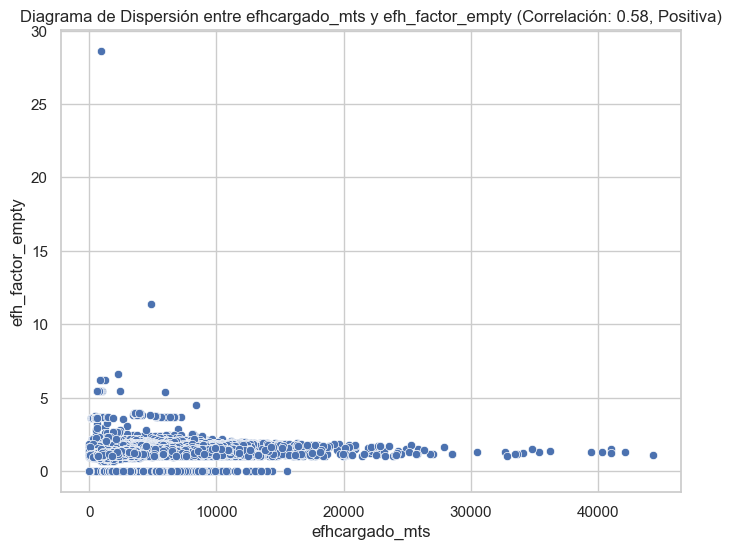

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



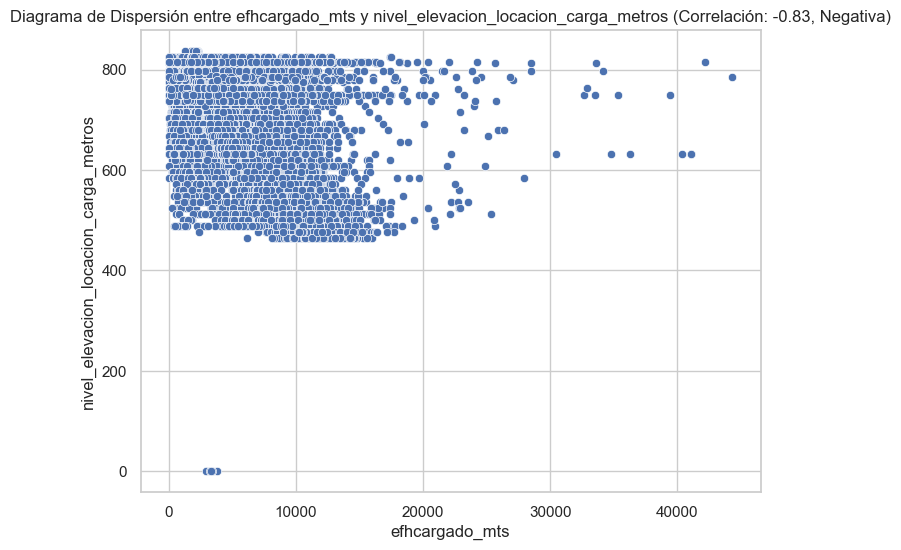

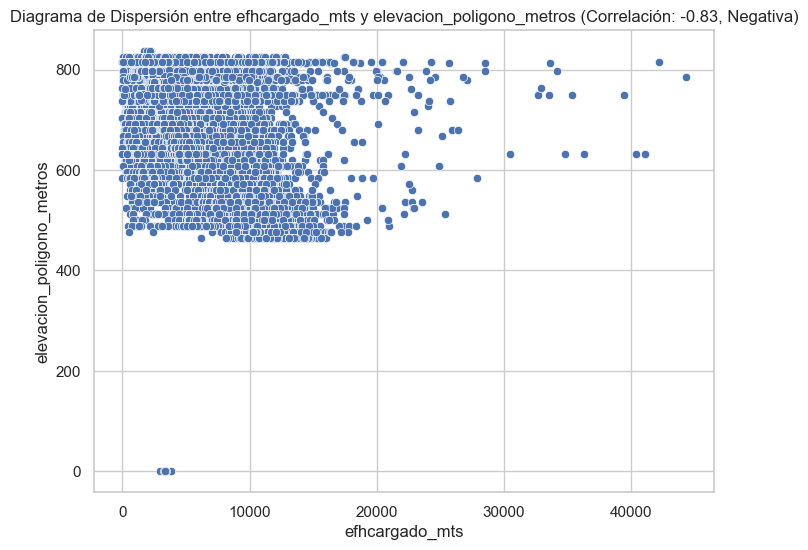

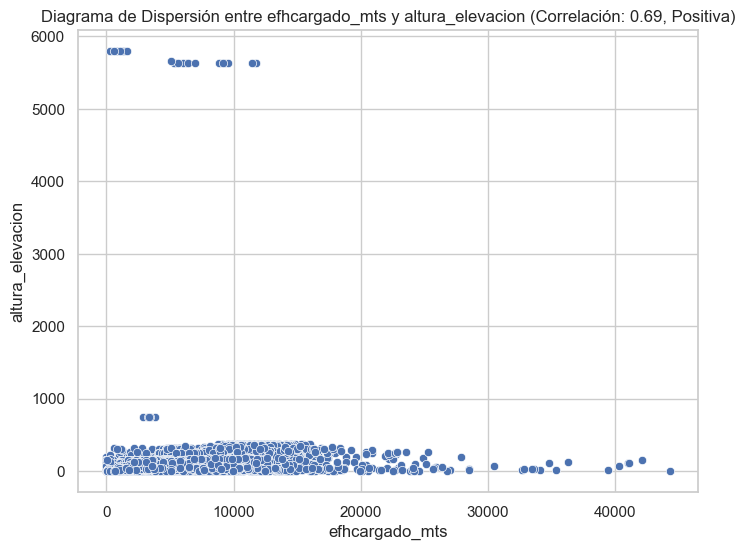

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



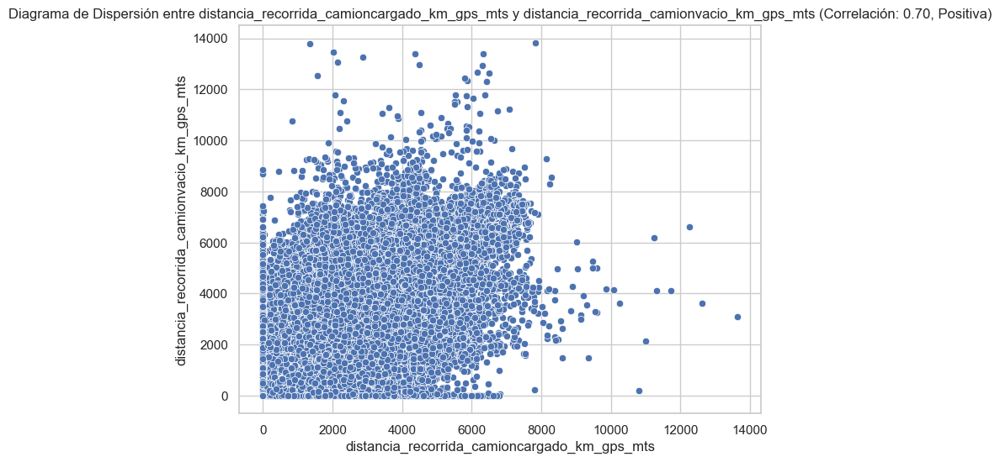

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



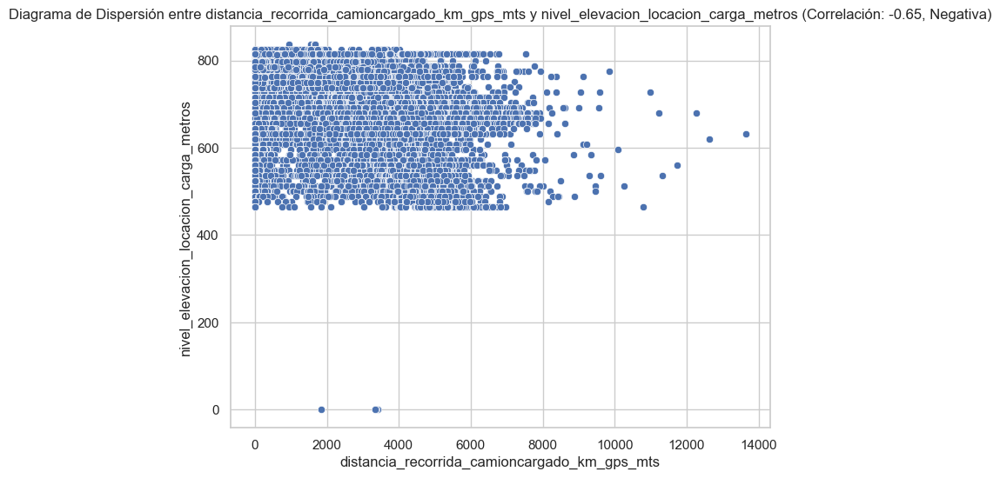

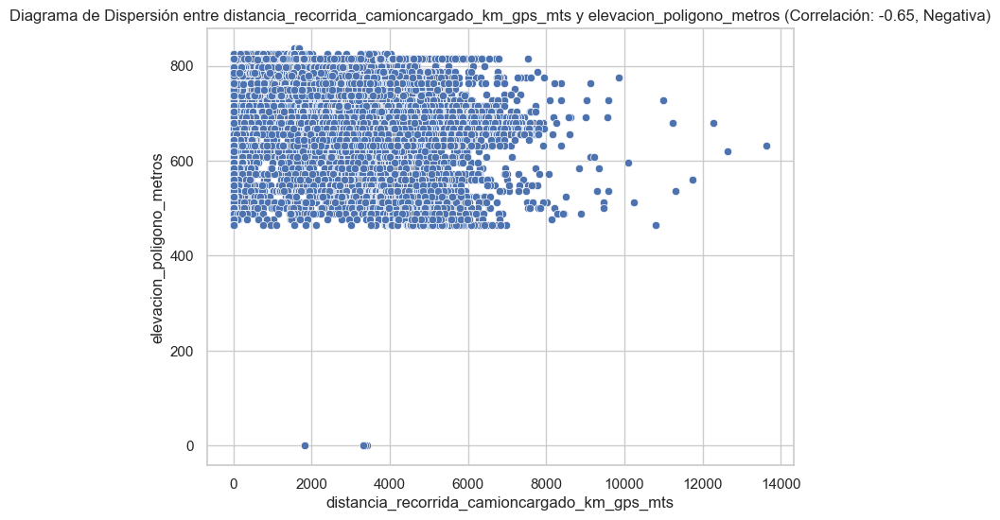

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



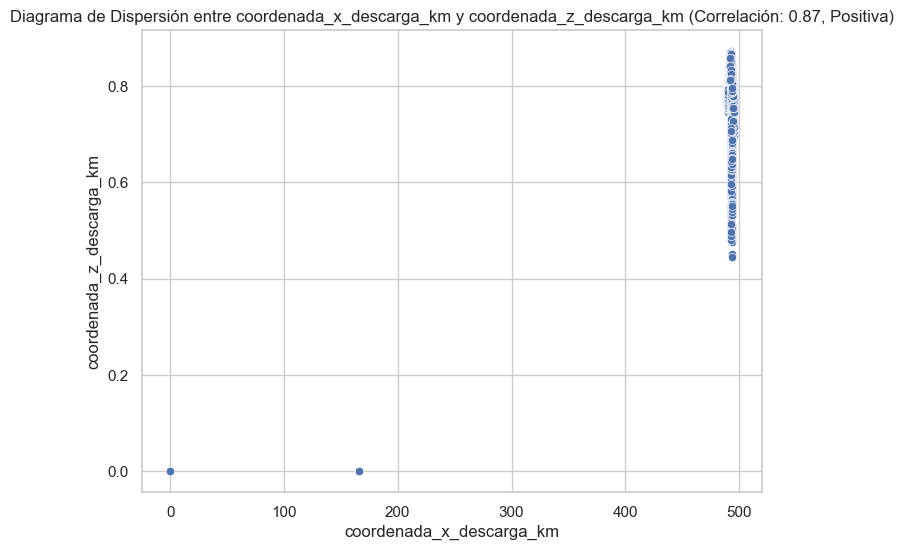

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



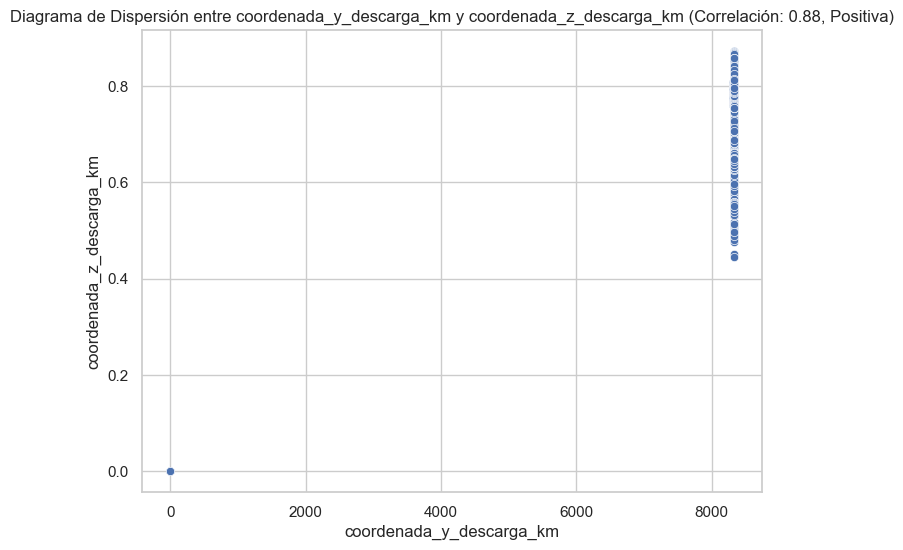

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



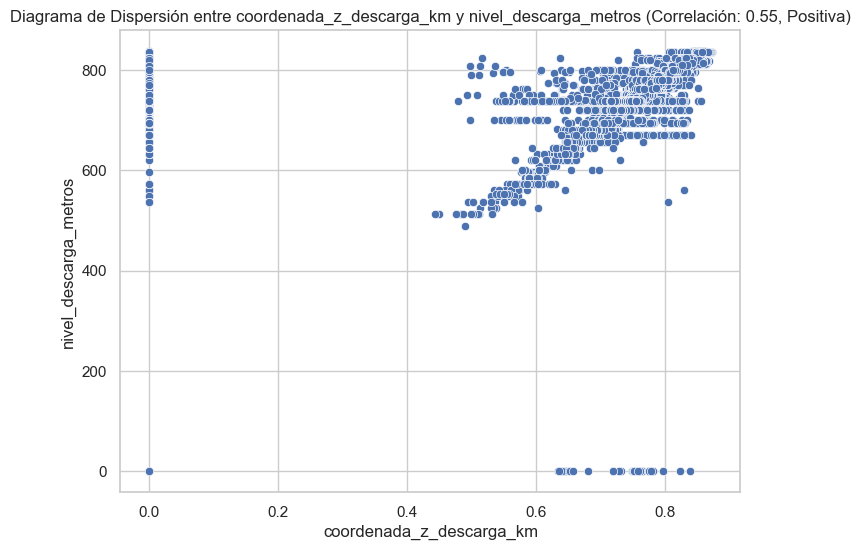

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



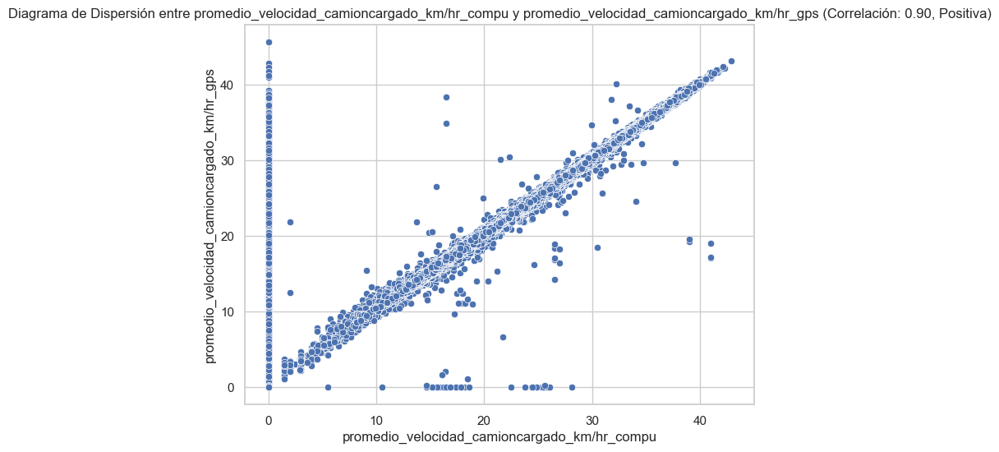

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



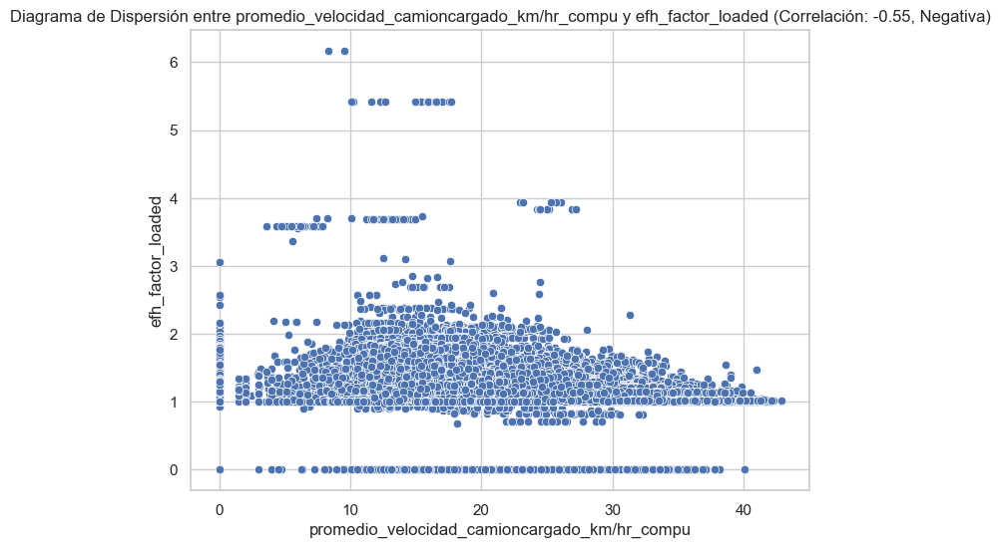

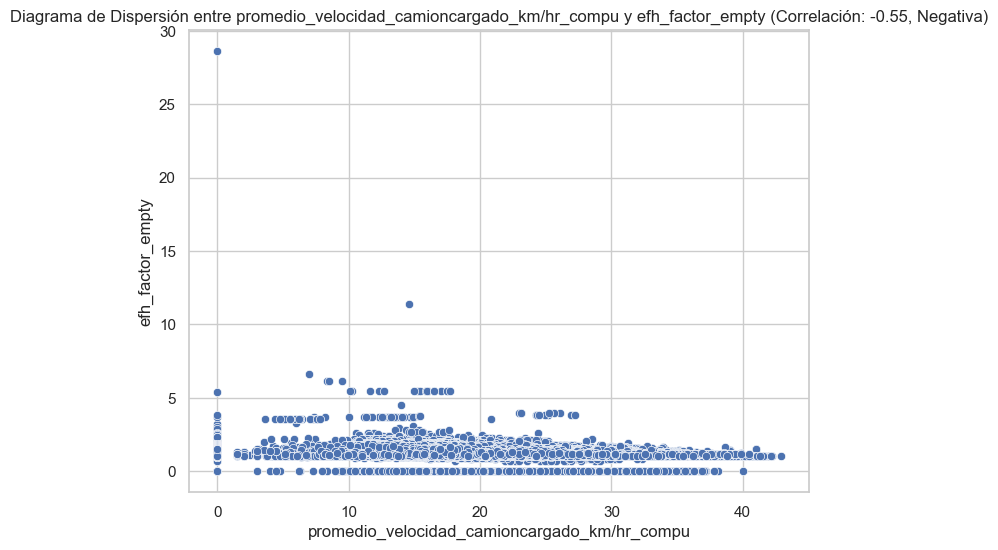

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



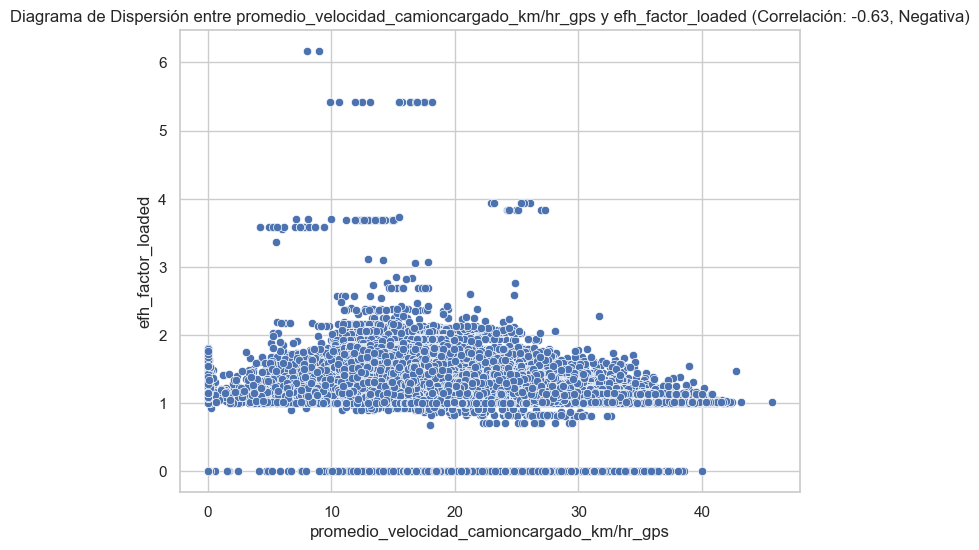

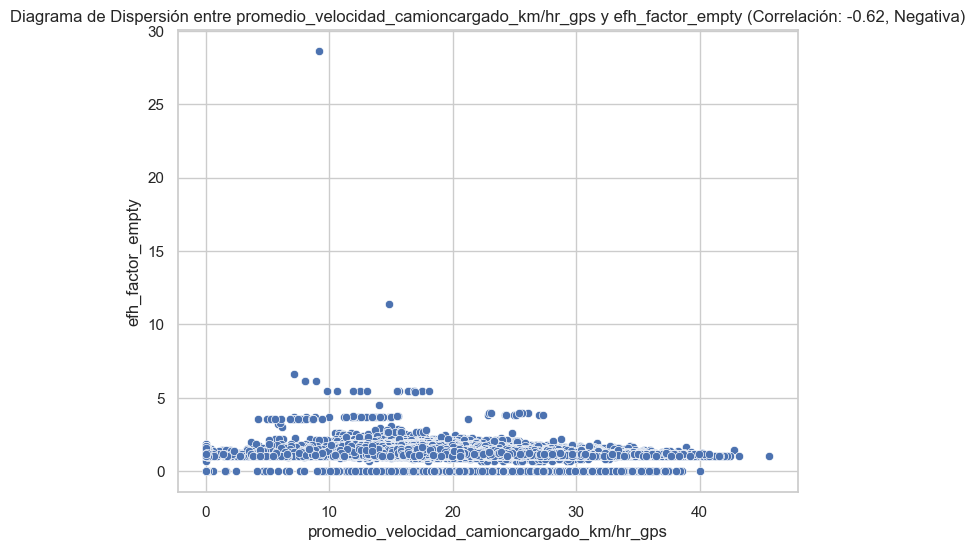

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



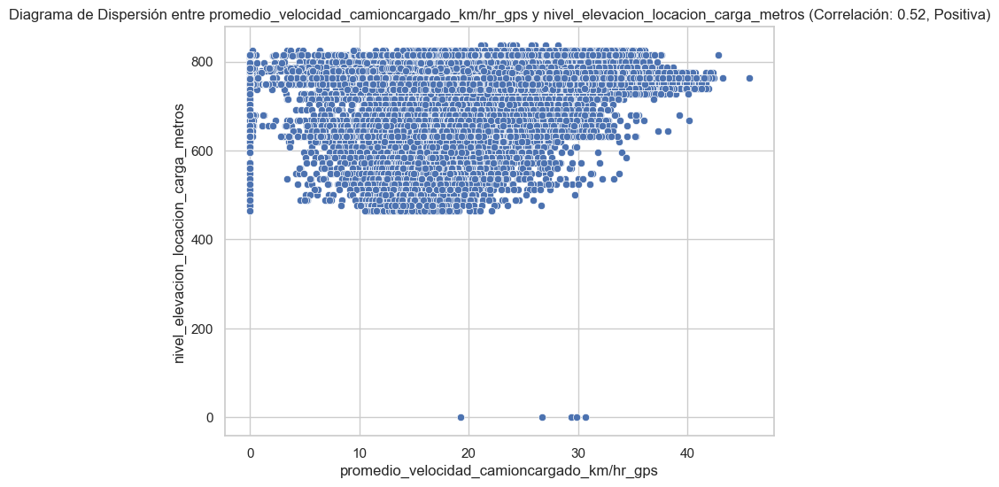

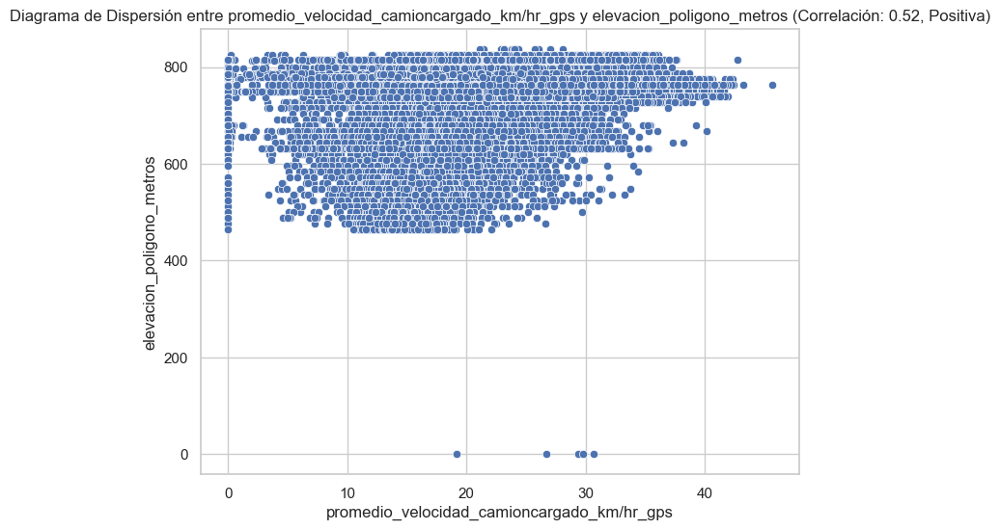

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



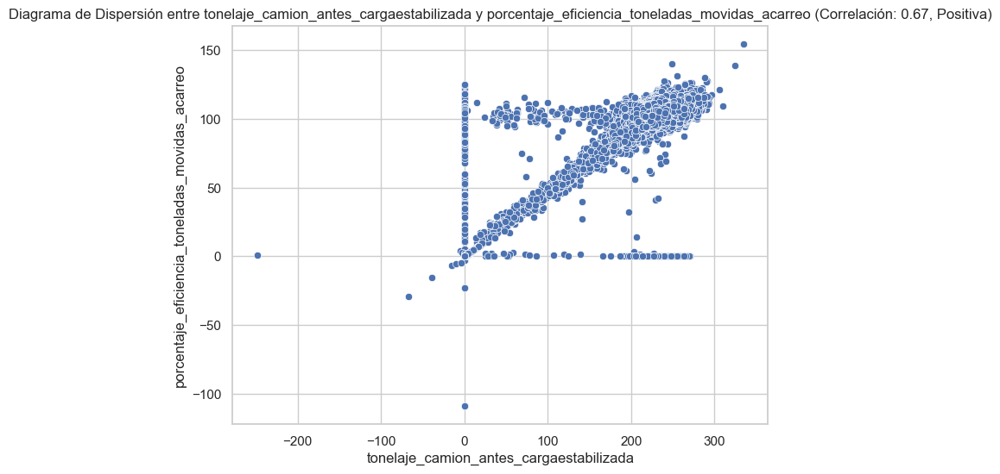

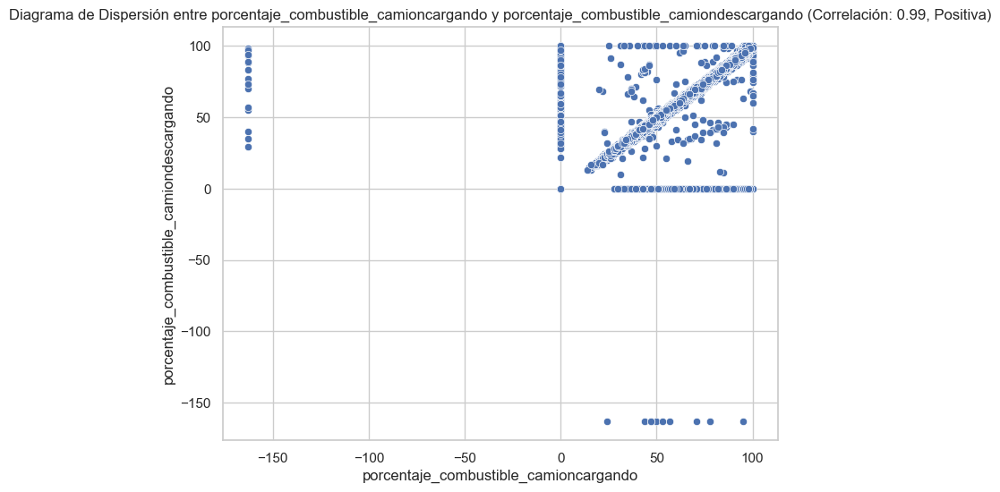

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



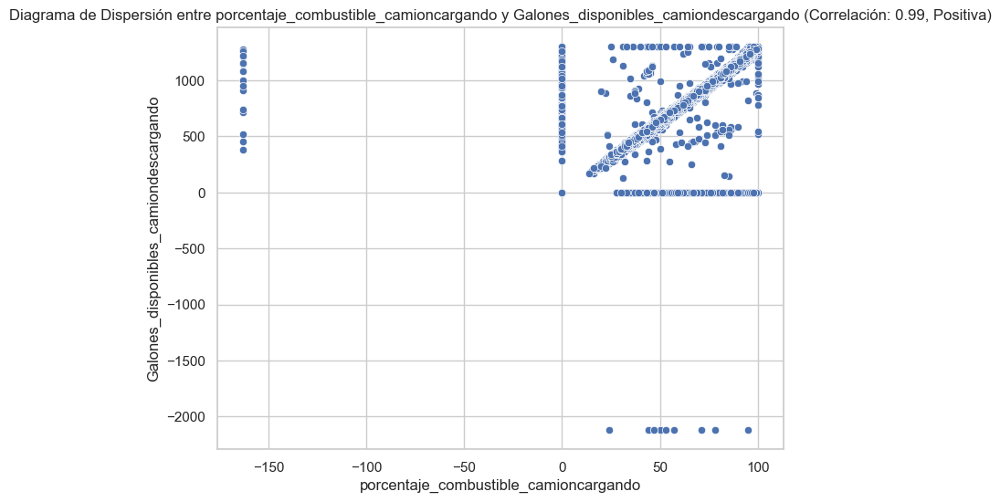

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



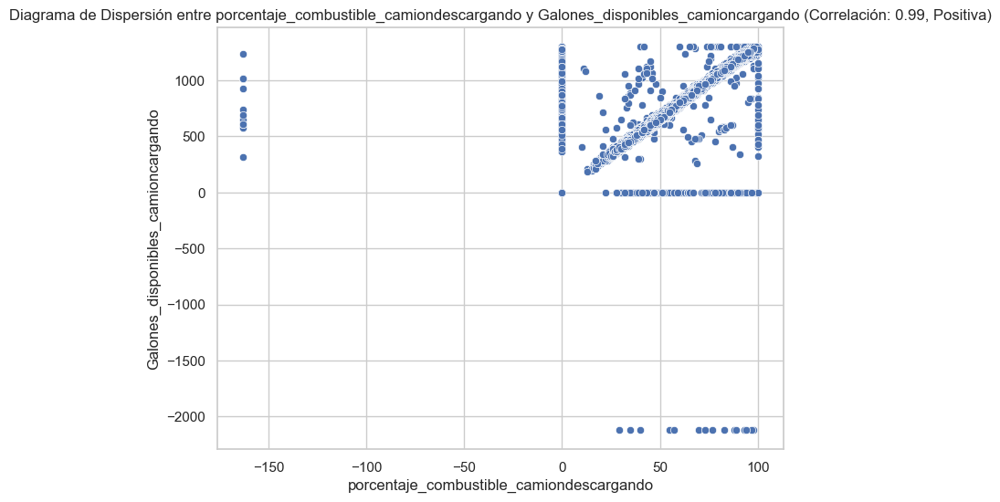

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



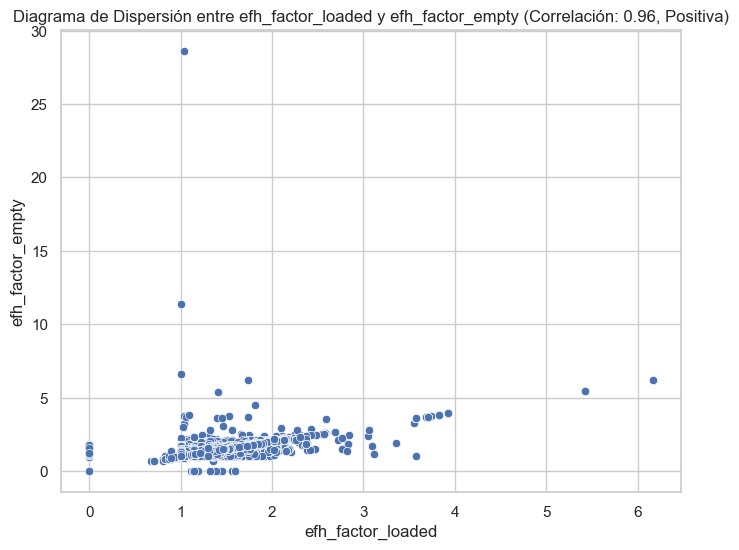

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



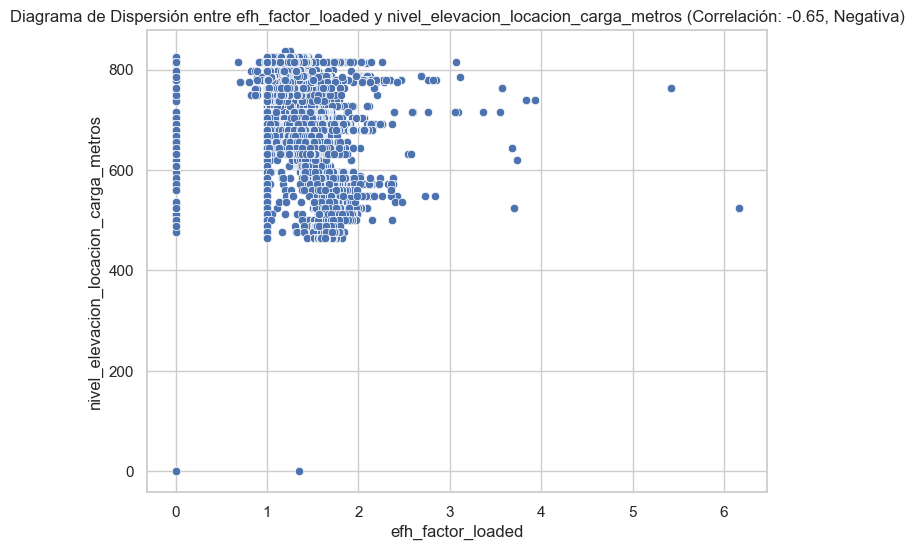

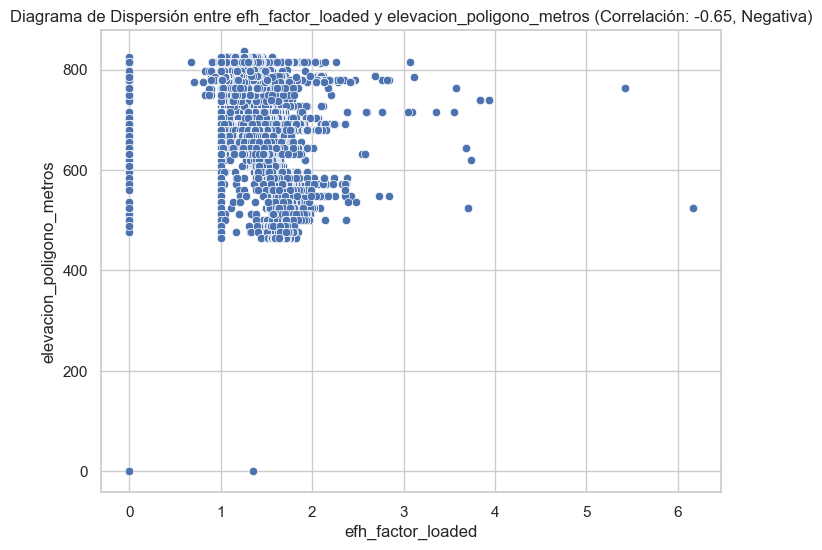

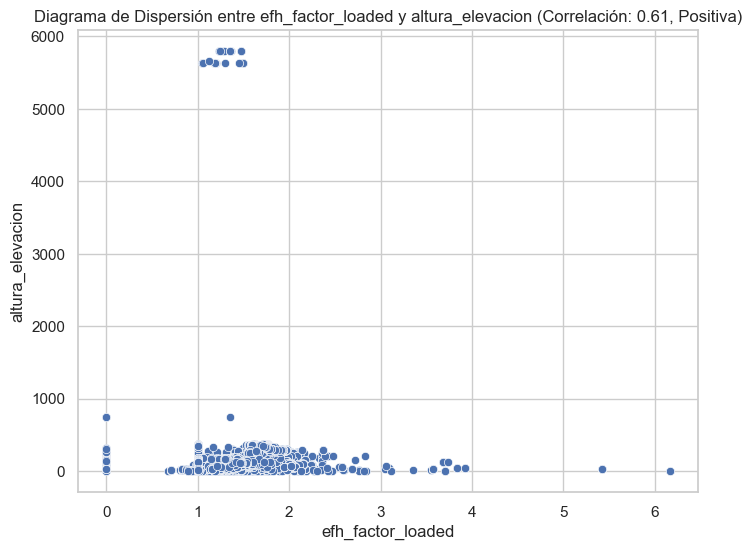

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



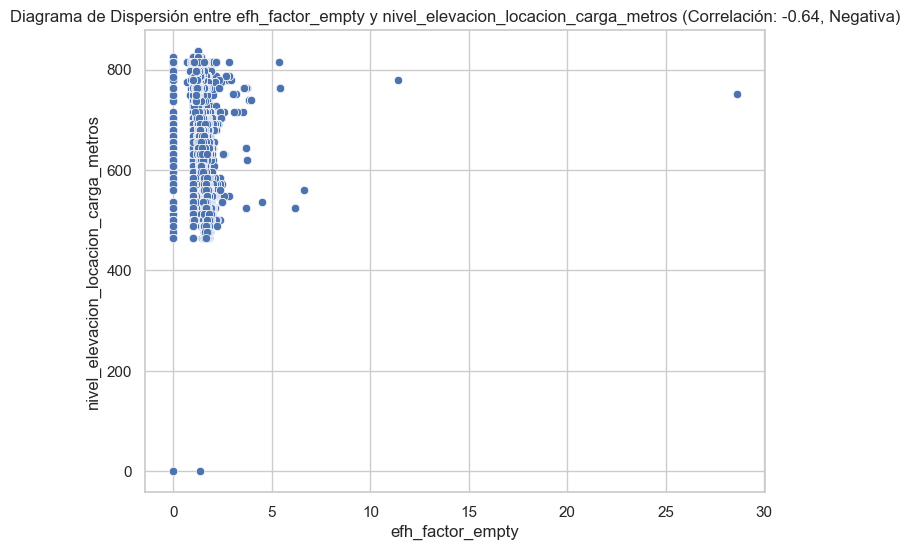

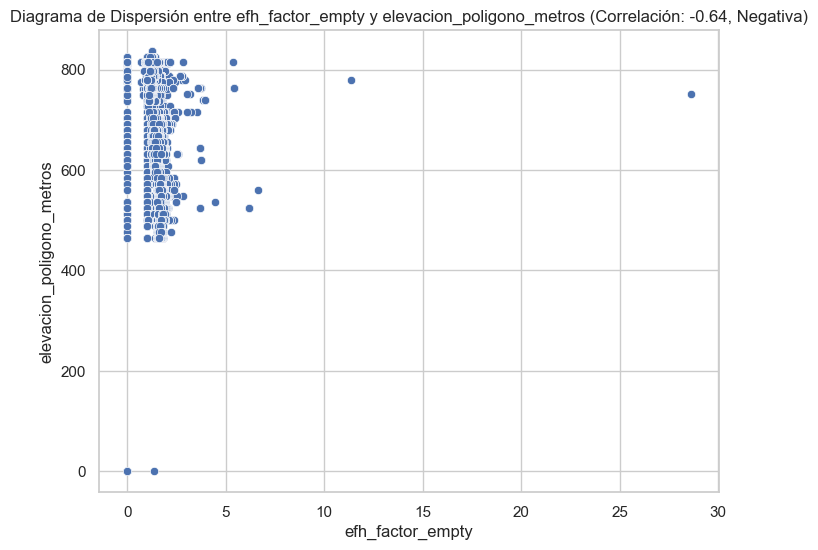

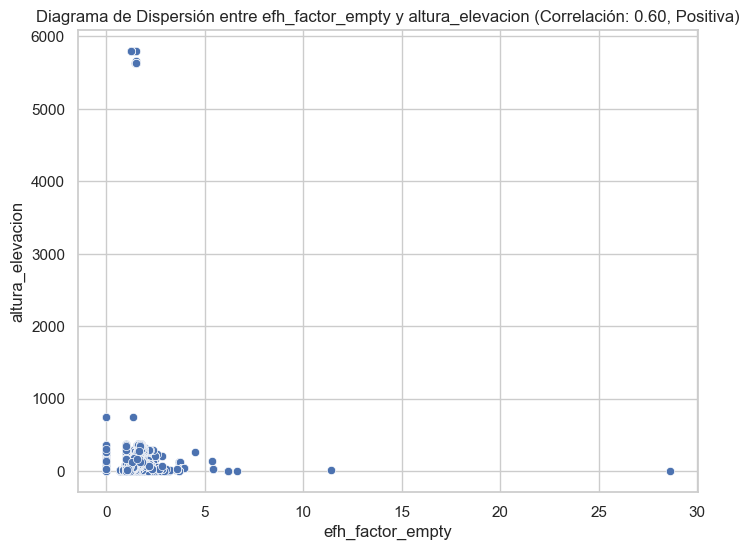

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide



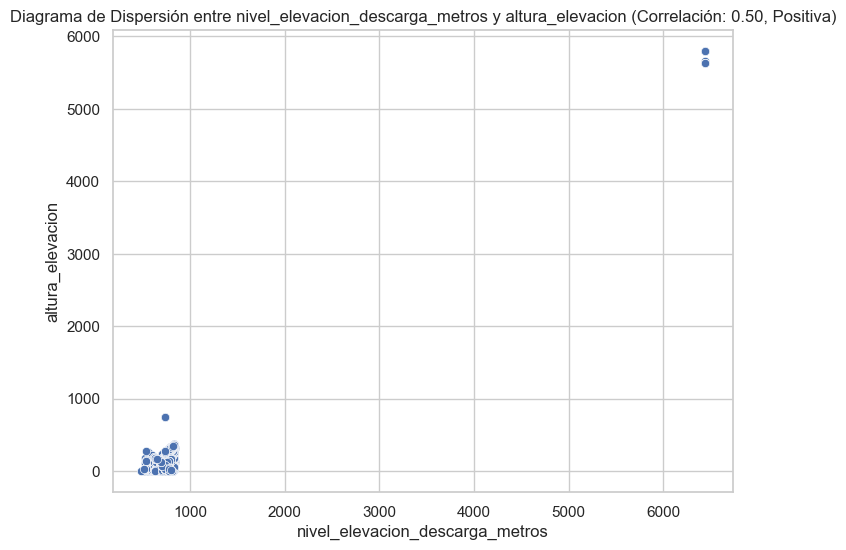

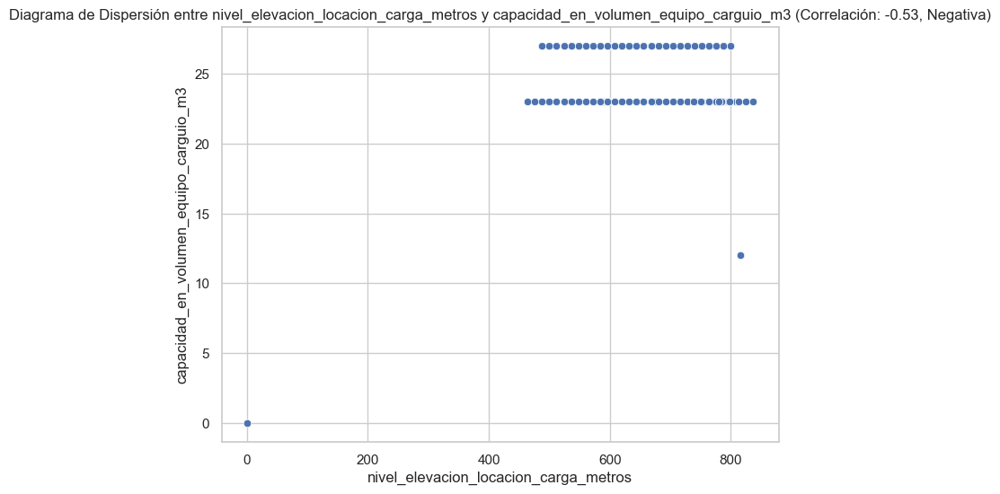

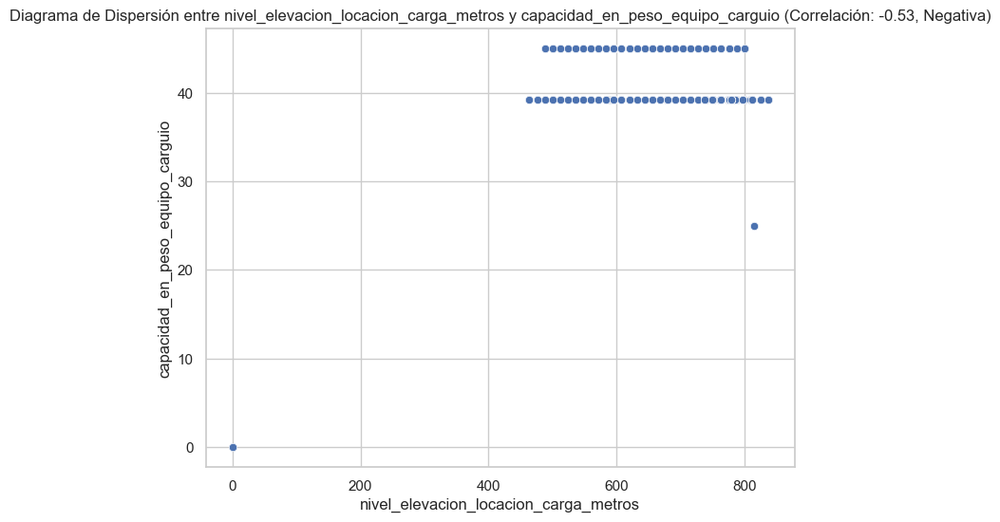

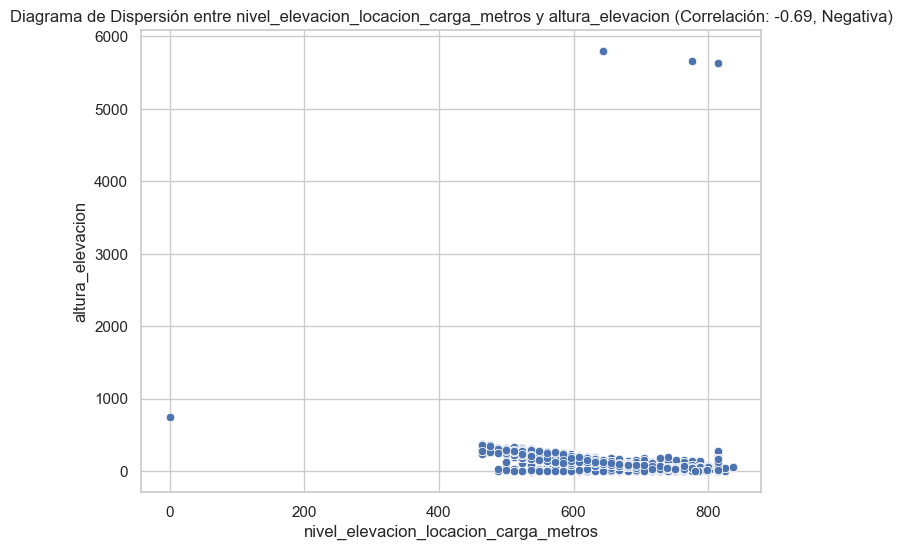

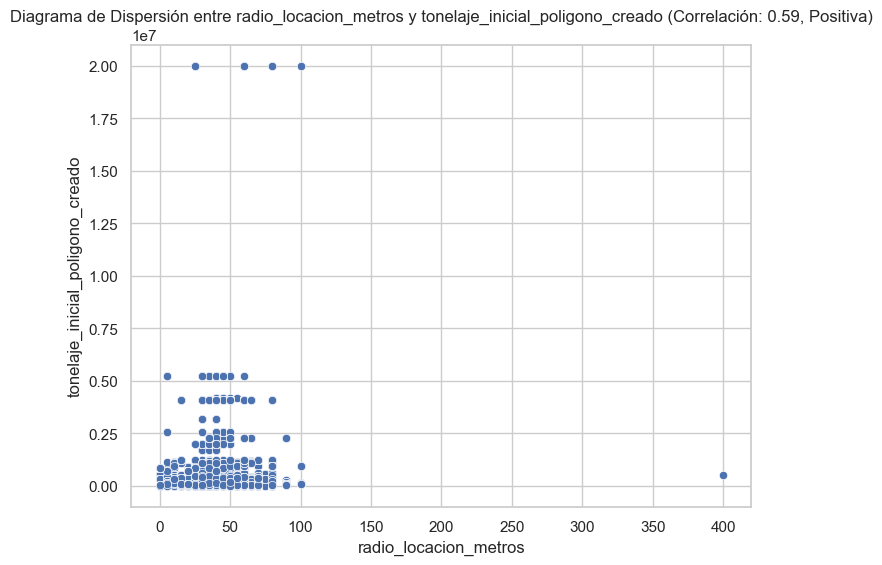

...

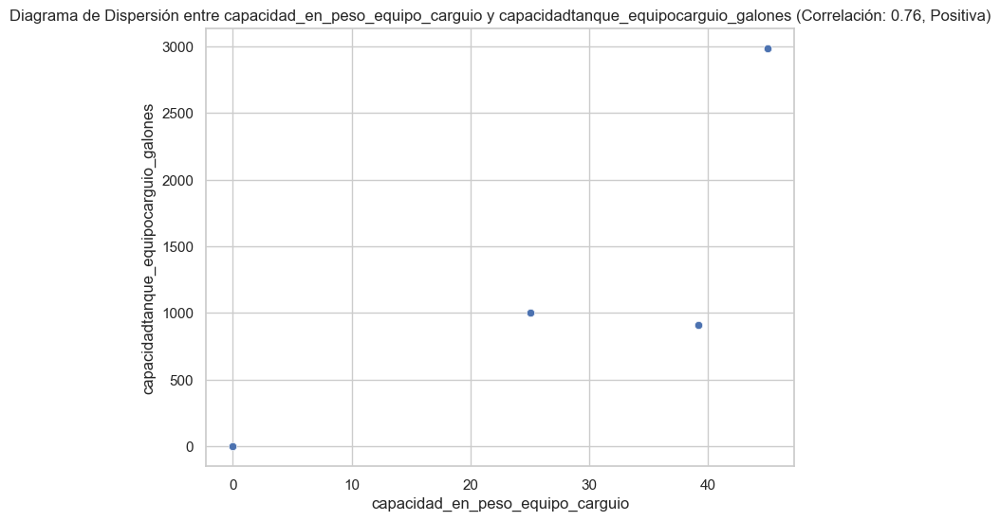

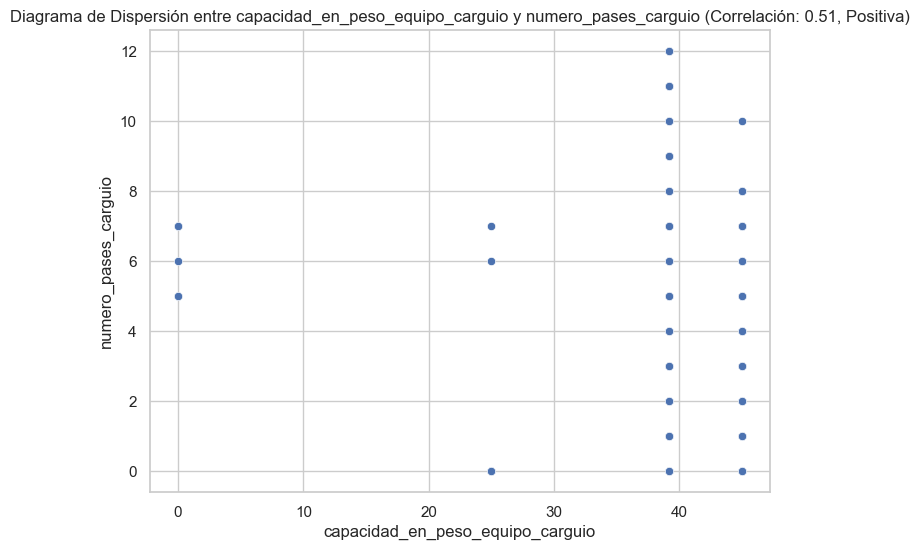

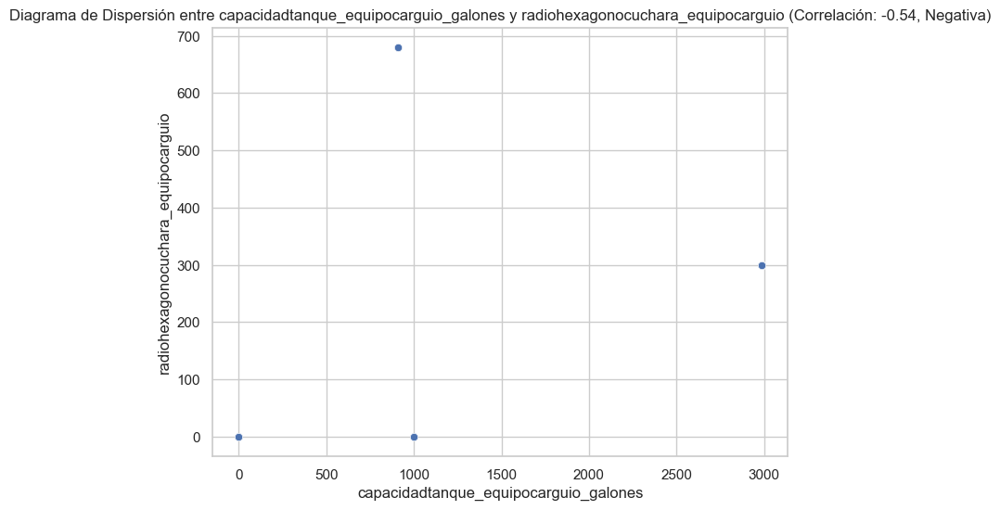

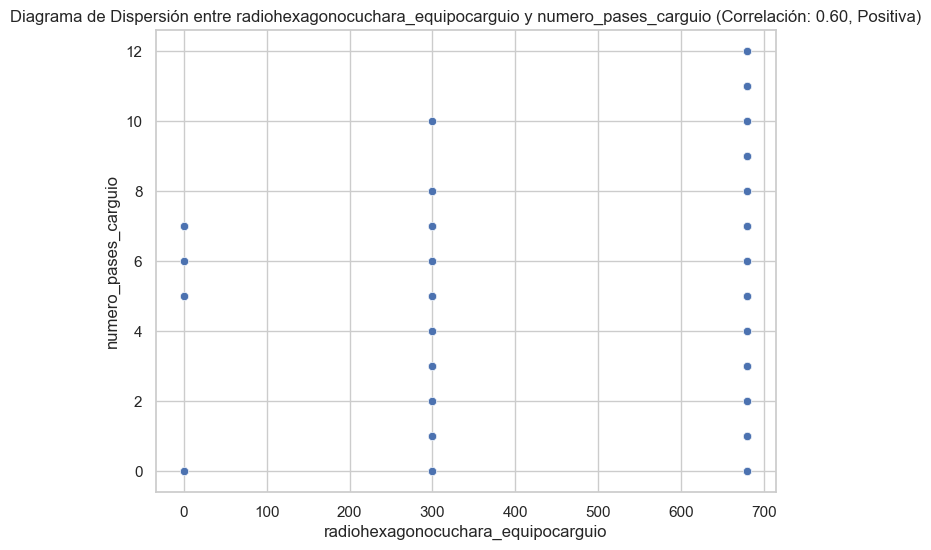

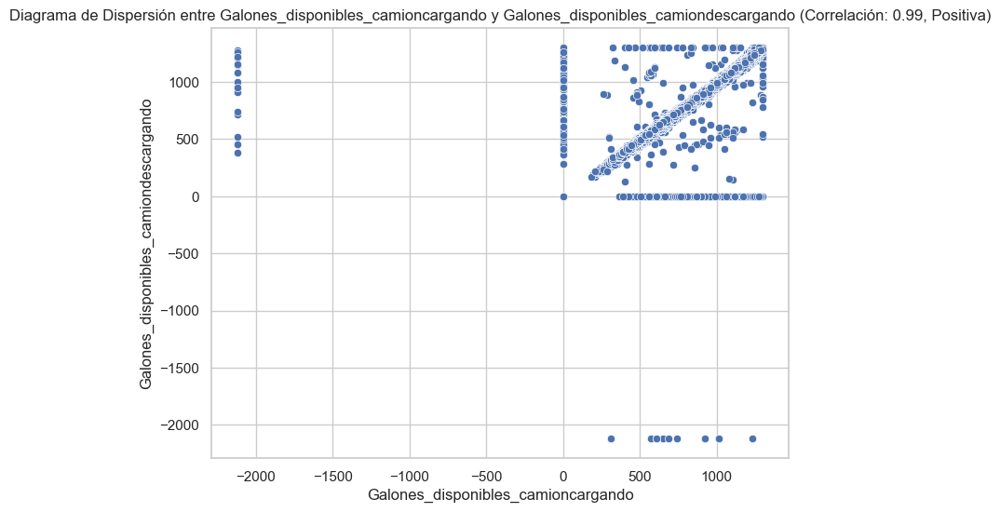

In [335]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'datos'

# Identificar las columnas numéricas y categóricas
columnas_numericas = datos.select_dtypes(include=['int', 'float']).columns

# Excluir las columnas que comienzan con 'id'
columnas_a_excluir = [col for col in datos.columns if col.startswith('id')]

# Filtrar las columnas numéricas que no están en columnas_a_excluir
columnas_a_incluir = [col for col in columnas_numericas if col not in columnas_a_excluir]

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Definir un umbral de correlación (ajusta según tus necesidades)
umbral_correlacion_min = 0.5
umbral_correlacion_max = 0.99

# Crear diagramas de dispersión solo para pares con correlación en el rango especificado
for i in range(len(columnas_a_incluir)):
    for j in range(i + 1, len(columnas_a_incluir)):
        col1 = columnas_a_incluir[i]
        col2 = columnas_a_incluir[j]

        correlacion = datos[col1].corr(datos[col2])
        direccion = "Positiva" if correlacion >= 0 else "Negativa"

        if umbral_correlacion_min <= abs(correlacion) < umbral_correlacion_max:
            plt.figure(figsize=(8, 6))
            sns.scatterplot(data=datos, x=col1, y=col2)
            plt.title(f'Diagrama de Dispersión entre {col1} y {col2} (Correlación: {correlacion:.2f}, {direccion})')
            plt.xlabel(col1)
            plt.ylabel(col2)
            plt.show()

### 5.1 Realizamos los diagramas de dispersion con las variables que nos indican algun patron

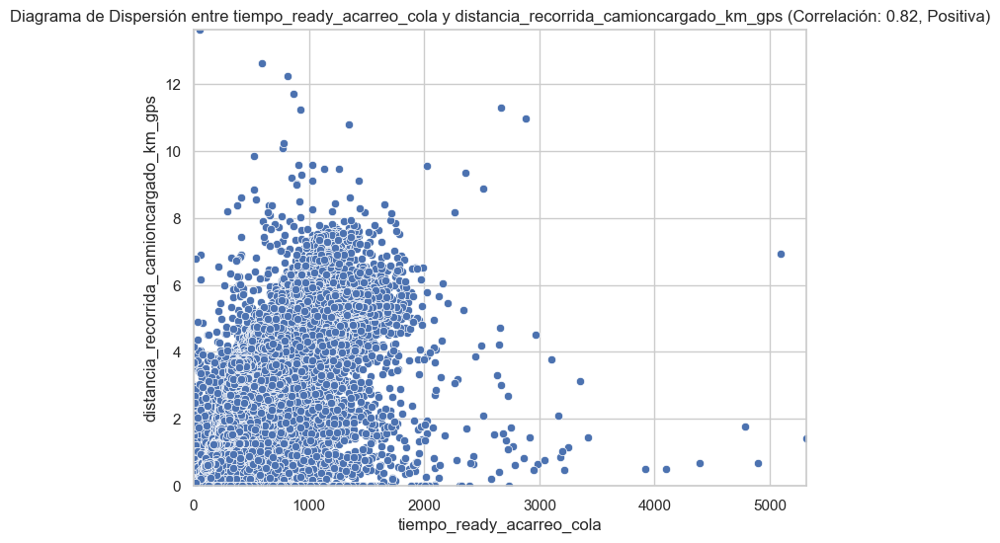

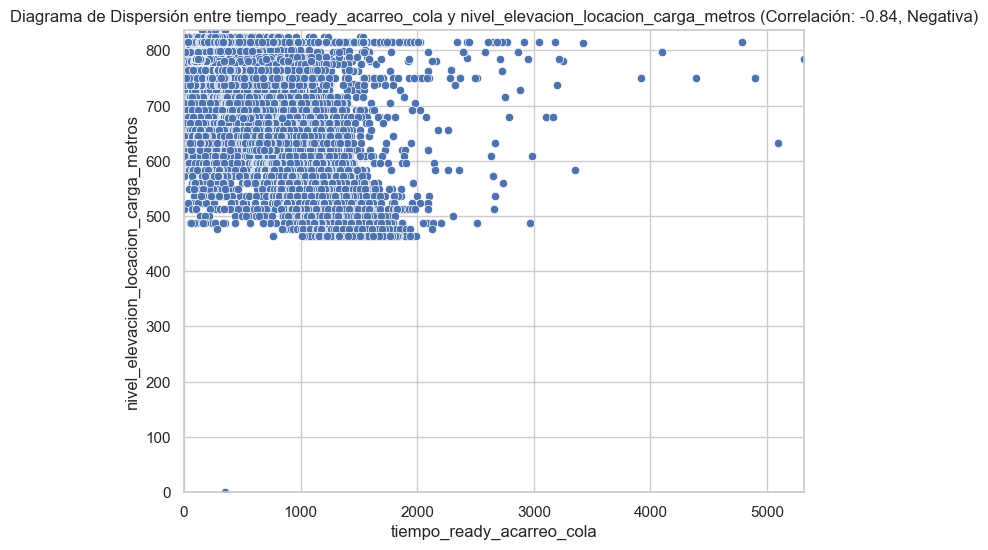

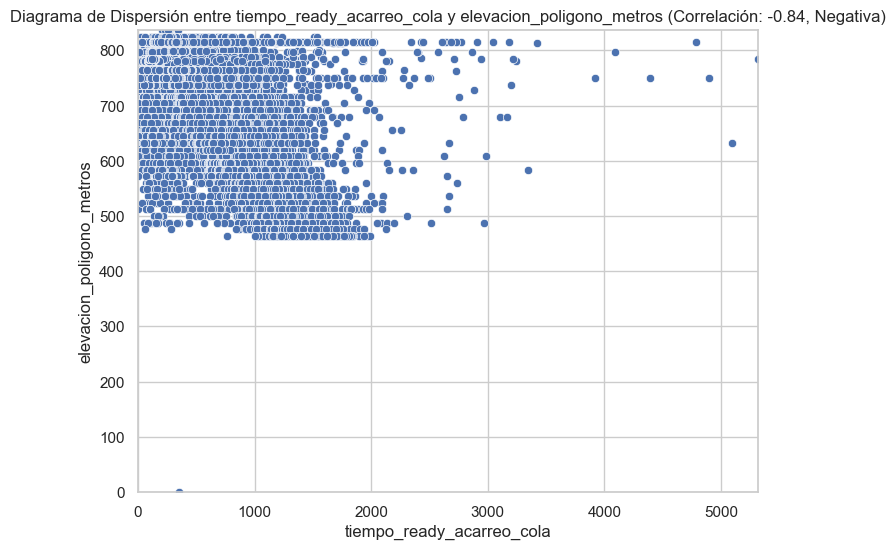

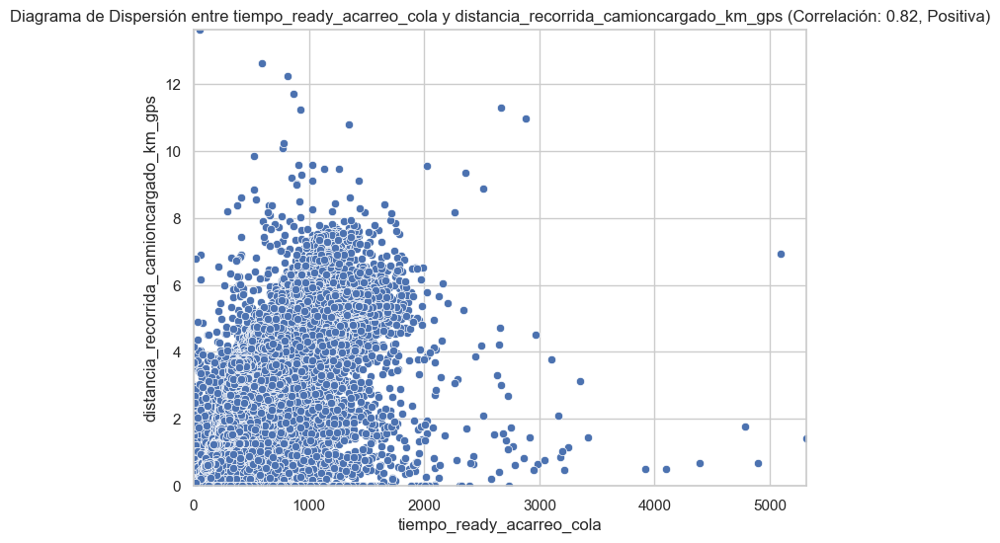

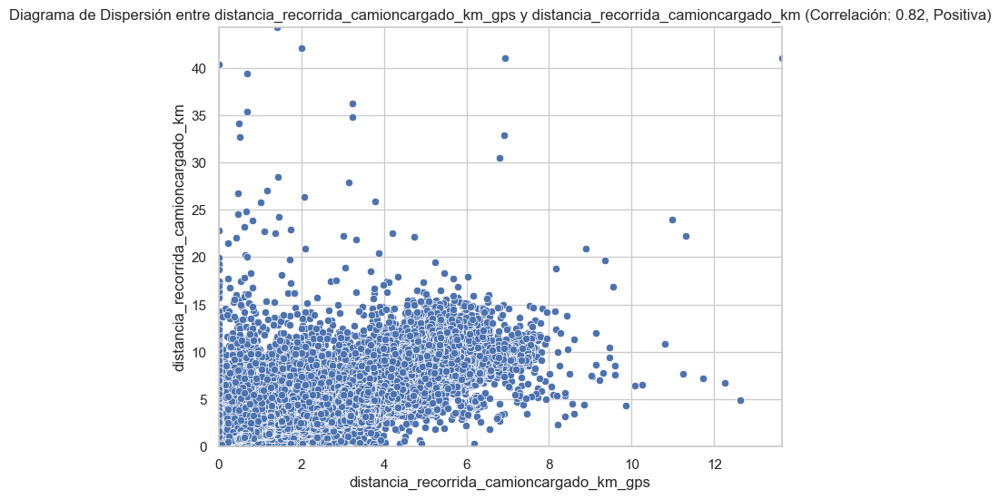

...

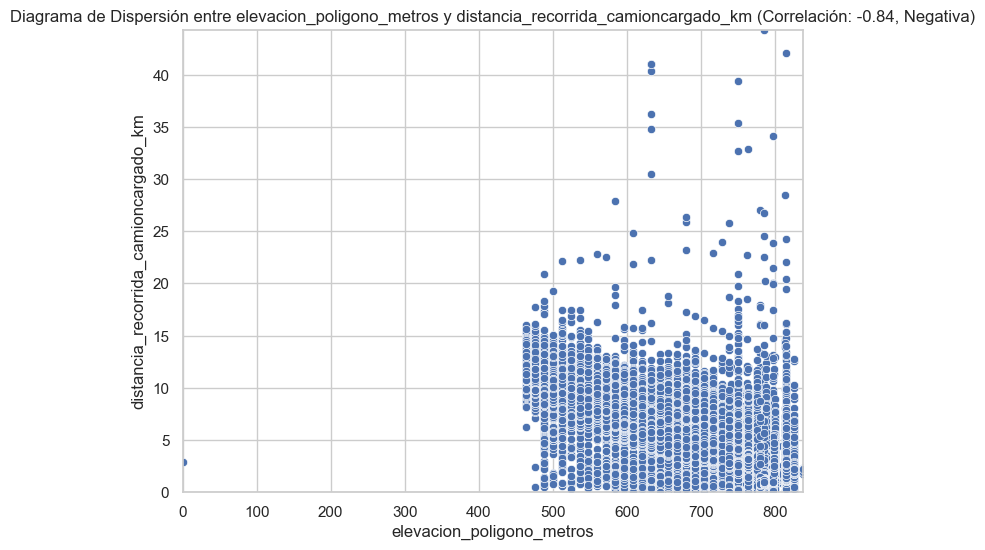

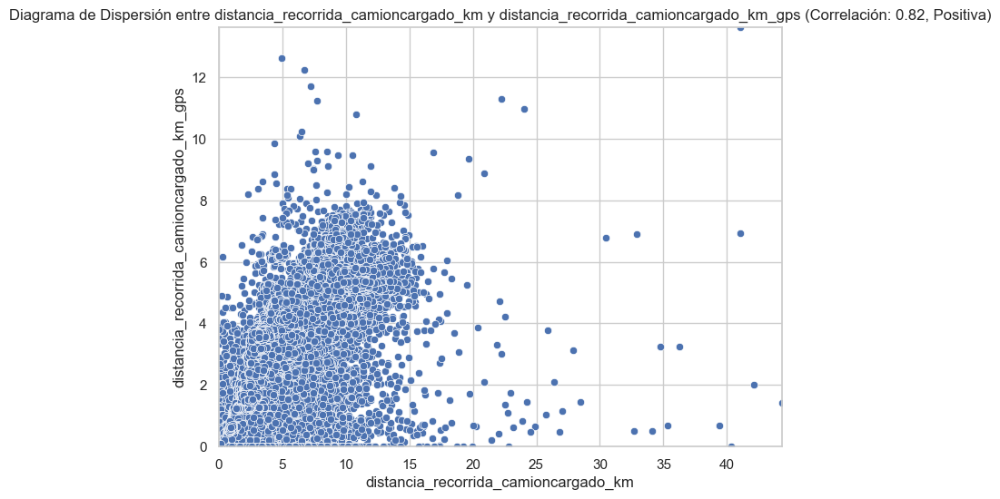

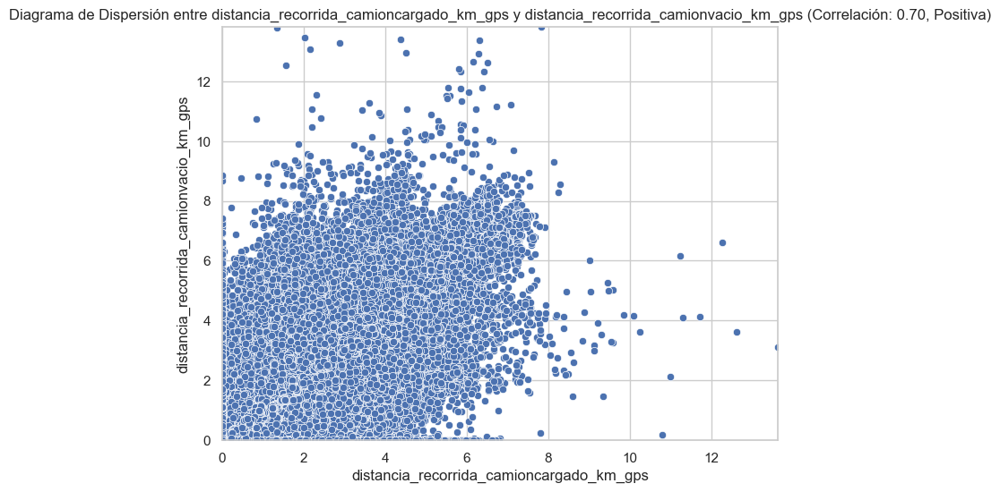

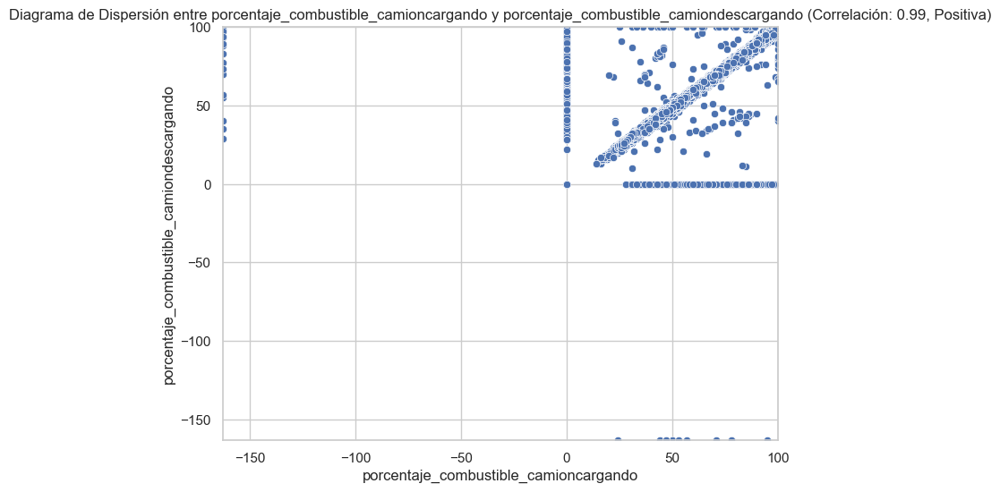

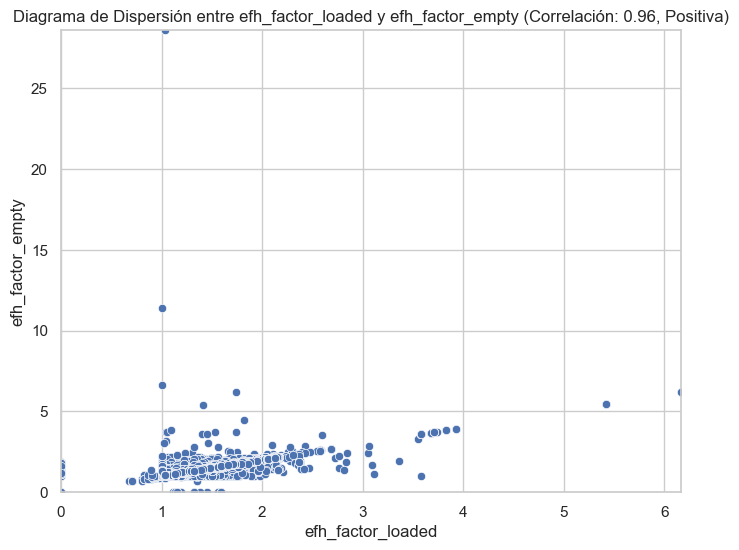

In [52]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que tienes un DataFrame llamado 'datos'
# y una lista de las variables que deseas graficar
variables_ingresadas = ['tiempo_ready_acarreo_cola', 'distancia_recorrida_camioncargado_km_gps',
                        'nivel_elevacion_locacion_carga_metros', 'elevacion_poligono_metros',
                        'distancia_recorrida_camioncargado_km', 'distancia_recorrida_camioncargado_km_gps',
                        'distancia_recorrida_camionvacio_km_gps', 'porcentaje_combustible_camioncargando',
                        'porcentaje_combustible_camiondescargando','efh_factor_loaded', 'efh_factor_empty']

# Filtrar las columnas numéricas que están en la lista variables_ingresadas
columnas_a_incluir = [col for col in variables_ingresadas if col in datos.columns]

# Definir un umbral de correlación (ajusta según tus necesidades)
umbral_correlacion_min = 0.7
umbral_correlacion_max = 0.99

# Crear diagramas de dispersión solo para pares con correlación en el rango especificado
for i in range(len(columnas_a_incluir)):
    for j in range(i + 1, len(columnas_a_incluir)):
        col1 = columnas_a_incluir[i]
        col2 = columnas_a_incluir[j]

        correlacion = datos[col1].corr(datos[col2])
        direccion = "Positiva" if correlacion >= 0 else "Negativa"

        if umbral_correlacion_min <= abs(correlacion) < umbral_correlacion_max:
            plt.figure(figsize=(8, 6))
            sns.scatterplot(data=datos, x=col1, y=col2)
            plt.title(f'Diagrama de Dispersión entre {col1} y {col2} (Correlación: {correlacion:.2f}, {direccion})')
            plt.xlabel(col1)
            plt.ylabel(col2)
            
            # Ajustar límites de ejes manualmente
            plt.xlim(datos[col1].min(), datos[col1].max())
            plt.ylim(datos[col2].min(), datos[col2].max())

            plt.show()

            # Puedes agregar una celda de código aquí para ingresar insights específicos para este par de variables

In [345]:
datos.head(3)

,id_ciclo_acarreo,id_cargadescarga_ciclo,id_palas,id_equipo_camion,id_ciclo_carguio,id_equipo_carguio,id_trabajador_pala,id_guardia_realiza_carga_al_camion,id_locacion_hace_carga,id_poligono_se_obtiene_material,tiempo_inicio_carga_carguio,tiempo_esperando_carguio,tiempo_ready_cargando_pala,tiempo_ready_esperando_pala,tiempo_previous_esperando_pala,al_termino_cargar_en_espera_cuadrado_cuadrandose,cambio_estado_operatividad_carguio,cantidad_equipos_espera_al_termino_carga_pala,id_estados_camion,id_equipo_table_estados_camion,id_detal_estado_camion,tiempo_inicio_cambio_estado_camion,tiempo_estimado_duracion_estado_camion,en_campo_o_taller_mantenimiento_camion,id_tipo_estad_camion,estado_detalle_camion,estado_secundario_camion,estado_primario_camion,id_estados_pala,id_equipo_table_estados_pala,id_detal_estado_pala,tiempo_inicio_cambio_estado_pala,tiempo_estimado_duracion_estado_pala,en_campo_o_taller_mantenimiento_pala,id_tipo_estad_pala,estado_detalle_pala,estado_secundario_pala,estado_primario_pala,id_zona_hace_descarga,id_factor,id_poligono,tiempo_llegada_camion,tiempo_esperando_camion_en_locacion,tiempo_cuadra_camion,tiempo_cuadrado_camion,tiempo_cargar_al_camion,tiempo_acarreo_camion,tiempo_cola_camion_en_zonadescarga,tiempo_retroceso_para_descargar,tiempo_listo_para_descargar,tiempo_descarga_camion,tiempo_viajando_vacio_locacion,tiempo_ready_llegada_esperando,tiempo_ready_esperando_cuadra,tiempo_ready_cuadra_cuadrado,tiempo_ready_cuadrado_cargado,tiempo_ready_carga_acarreo,tiempo_ready_acarreo_cola,tiempo_ready_cola_retro,tiempo_ready_retro_listo,tiempo_ready_listo_descarga,tiempo_ready_descarga_viajandovacio,id_trabajador_camion,id_palanext,tonelaje_nominal,tonelaje_segun_computadora,cambios_estado_en_ciclo,id_guardia_hizocarga,id_guardia_hizodescarga,id_zona_aplicafactor,id_zona_pertenece_poligono,factor,toneladas_secas,productividad_operativa_acarreo_tn_h,productividad_operativa_carguio_tn_h,efhcargado_mts,efhvacio_mts,distancia_recorrida_camioncargado_km_gps_mts,distancia_recorrida_camionvacio_km_gps_mts,coordenada_x_descarga_km,coordenada_y_descarga_km,coordenada_z_descarga_km,tipo_descarga_efectuado,tonelaje_camion_viajevacio_cicloanterior_vims,tonelaje_camion_viajevacio_cicloactual_vims,promedio_velocidad_camioncargado_km/hr_compu,promedio_velocidad_camionvacio_km/hr_compu,promedio_velocidad_camioncargado_km/hr_gps,promedio_velocidad_camionvacio_km/hr_gps,tonelaje_camion_antes_cargaestabilizada,porcentaje_combustible_camioncargando,porcentaje_combustible_camiondescargando,volumen_nominal,aplica_factor_volumen_o_tonelaje,nivel_descarga_metros,efh_factor_loaded,efh_factor_empty,nombre_equipo_acarreo,id_flota_secundaria,nombre_flota_secundaria,id_flota_principal,nombre_flota_principal,capacidad_en_volumen_equipo_acarreo_m3,capacidad_en_peso_equipo_acarreo,capacidadtanque_equipoacarreo_galones,peso_bruto_equipo_acarreo,si_no_equipo_altaprecision,ancho_equipo_metros,largo_equipo_metros,numeroejes_equipo,id_turnos_turnocarga,nombre_turnocarga,horaini_turnocarga,horafin_turnocarga,id_turnos_turnodescarga,nombre_turnodescarga,horaini_turnodescarga,horafin_turnodescarga,id_secundario_descarga,id_zona_encuentra_descarga,id_nodo_carga,id_nodo_descarga,id_mezcla_asignada_a_descargarse,nivel_elevacion_descarga_metros,nombre_zona_descarga,nombre_locacion_carga,nivel_elevacion_locacion_carga_metros,radio_locacion_metros,ids_poligonos_en_locacion_carga,id_material_dominante_en_poligono,nombre_poligono,elevacion_poligono_metros,lista_leyes,densidad_inicial_poligono_creado_tn/m3,tonelaje_inicial_poligono_creado,id_pases,id_palas_pases,coord_x_pases,coord_y_pases,coord_z_pases,angulo_giro_pases,tonelaje_pases,duracion_excavacion_pases,angulo_giro_promedio_pases,has_block_pases,nombre_equipo_carguio,capacidad_en_volumen_equipo_carguio_m3,capacidad_en_peso_equipo_carguio,capacidadtanque_equipocarguio_galones,radiohexagonocuchara_equipocarguio,id_guardia_acarreocarga,nombre_guardia_acarreocarga,id_guardia_acarreodescarga,nombre_guardia_aca

In [344]:
datos['Galones_consumidos_entre_cargando_descargando_acarreo'].unique()

array([    0.,    13.,    13.,    39.,    26.,    13.,    26.,   -13.,
          26.,   -26.,    13.,    39.,    26.,    26.,    26.,    13.,
          52.,  1300.,   -13.,   -13.,    39.,   -13.,    13.,   806.,
        -754.,    39.,   780.,  1248.,   455.,   -13.,    39.,   -39.,
        -416.,  -585.,  -741.,  -767.,  1196., -1001.,  -494.,  -988.,
        -481.,   962.,  -286.,  -611.,   481.,   975.,    52.,  -247.,
        1079.,  -650.,   -52., -1040.,   416.,    78.,   819.,  1235.,
        1144.,  -949.,   156.,  1027.,   559.,  -637.,  -104.,   728.,
         325.,  -429., -1248.,   702., -3029.,   117.,   208.,  1287.,
          52.,   -26.,   689., -1209.,    52.,  -442.,   676., -1183.,
         832.,  -390.,   793.,   715.,  -689.,  1209.,   429.,    91.,
         -65.,   624.,    65.,  1157.,  -182.,  -806.,   572.,   910.,
        -845.,   585.,   390.,   520.,   494.,  -936.,  1222.,  -819.,
        -507.,   507.,  -598.,   611.,   234., -2639.,   208.,   182.,
      

### *5.2 Diagramas de Dispersion comparando con Variable Categorica*

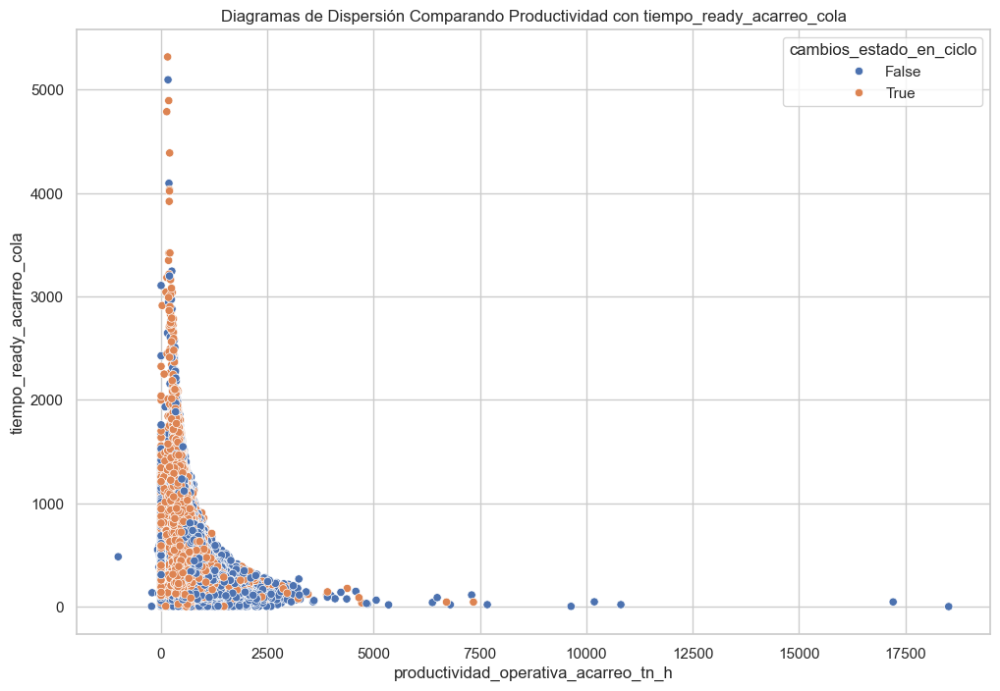

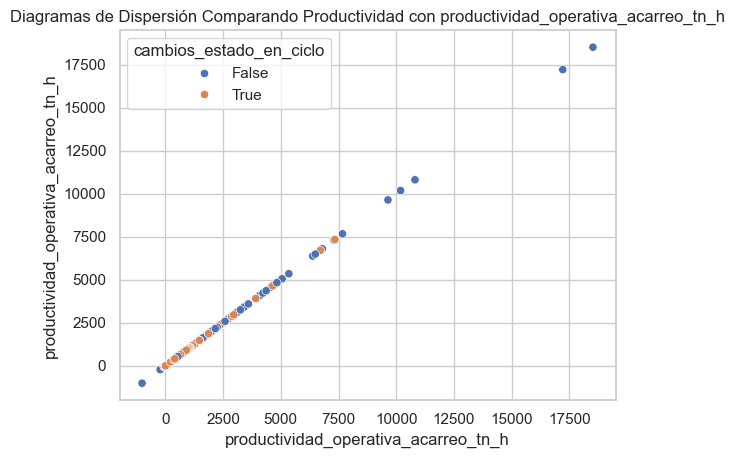

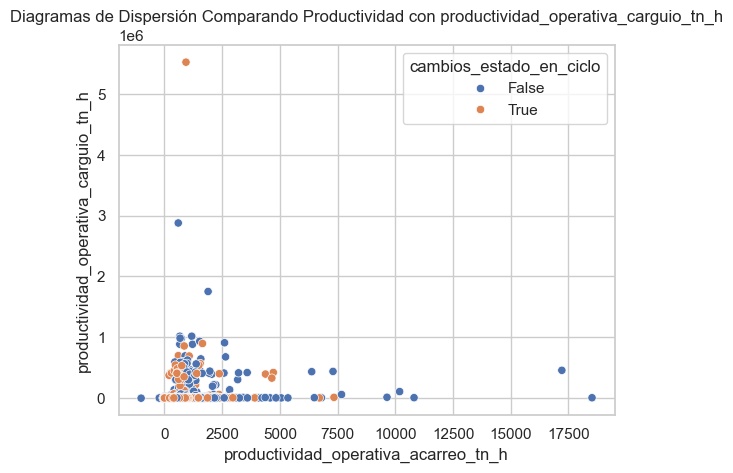

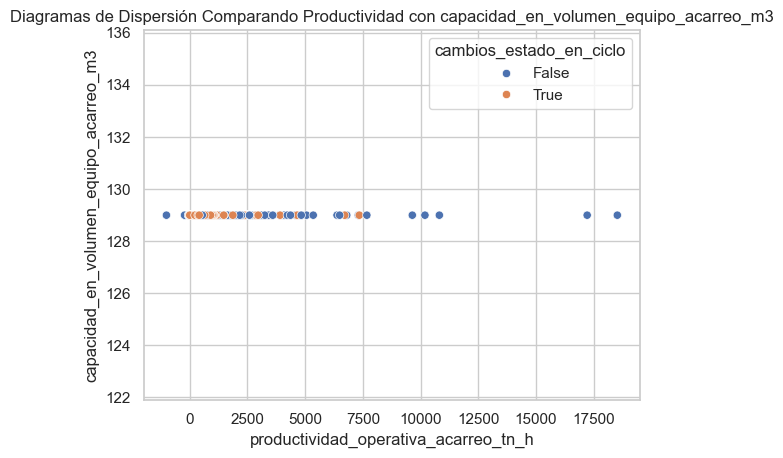

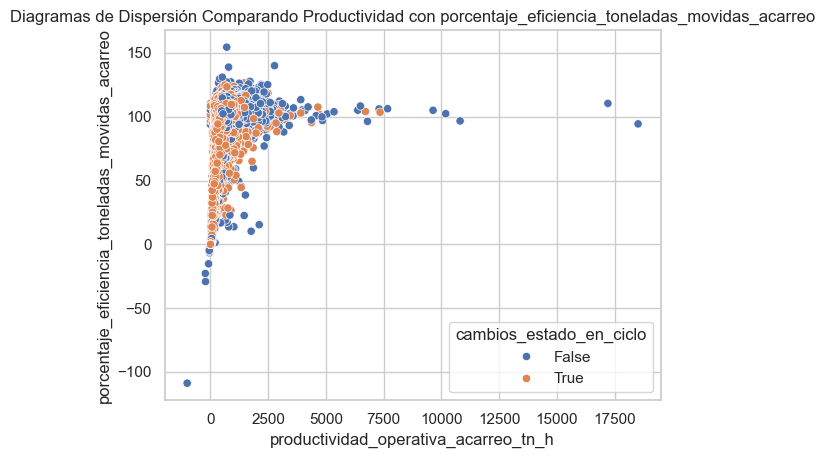

...

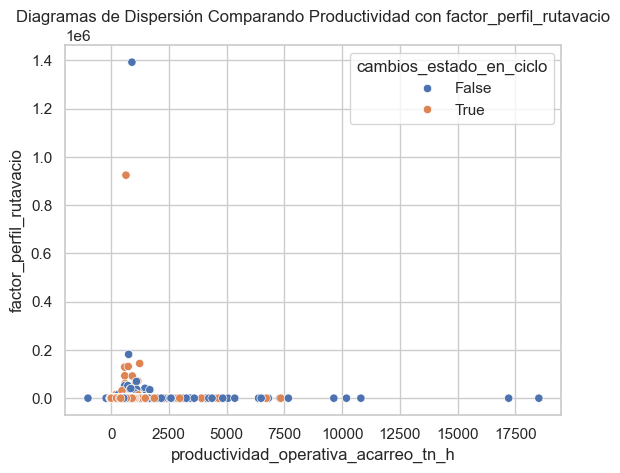

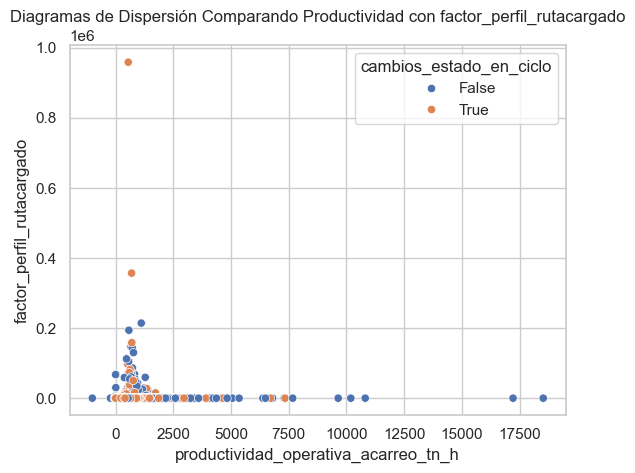

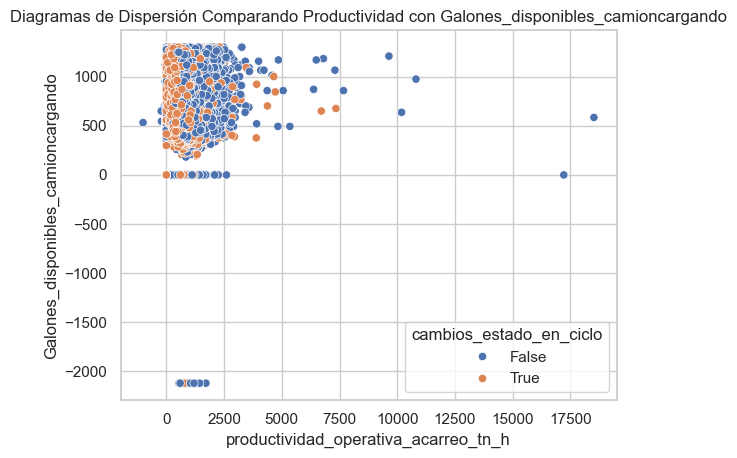

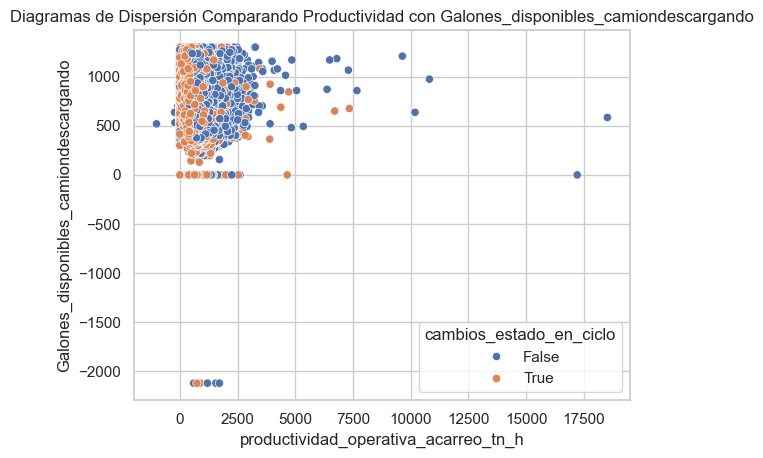

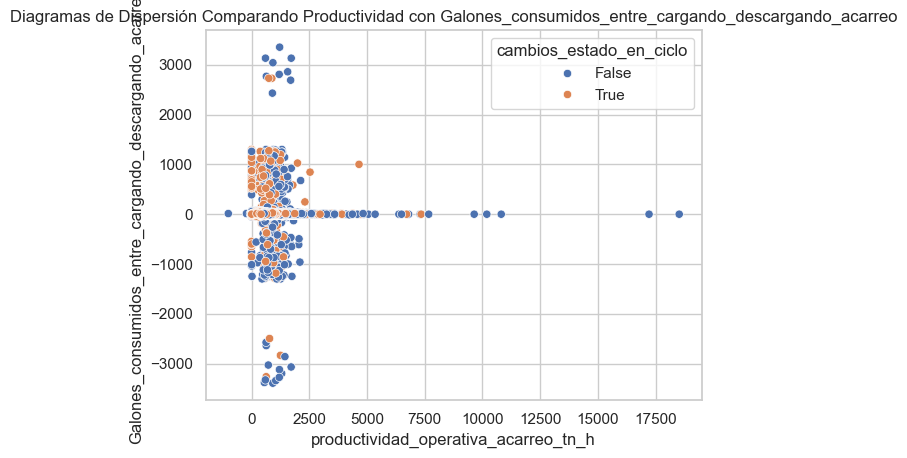

In [339]:
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'variable1', 'variable2', ..., 'variable5' son las otras variables que quieres comparar

variables_a_comparar = ['porcentaje_eficiencia_toneladas_movidas_acarreo', 'altura_elevacion', 
                     'promedio_velocidad_camioncargado_km/hr_gps','promedio_velocidad_camionvacio_km/hr_gps','densidad_inicial_poligono_creado_tn/m3',
                     'Galones_consumidos_entre_cargando_descargando_acarreo']
hue_variable = 'cambios_estado_en_ciclo'

# Configura el tamaño del gráfico
plt.figure(figsize=(12, 8))

# Itera sobre las variables y crea un gráfico de dispersión para cada una
for variable in variables_a_comparar:
    sns.scatterplot(data=datos, x='productividad_operativa_acarreo_tn_h', y=variable, hue=hue_variable)

    # Agrega leyendas y título
    plt.legend(title=hue_variable)
    plt.title(f'Diagramas de Dispersión Comparando Productividad con {variable}')

    # Muestra el gráfico
    plt.show()

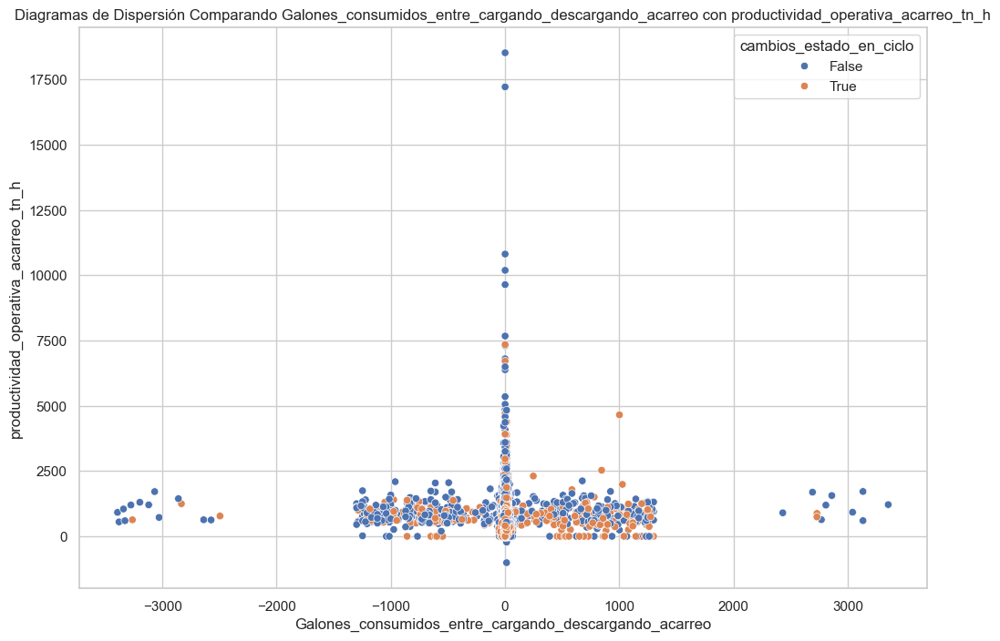

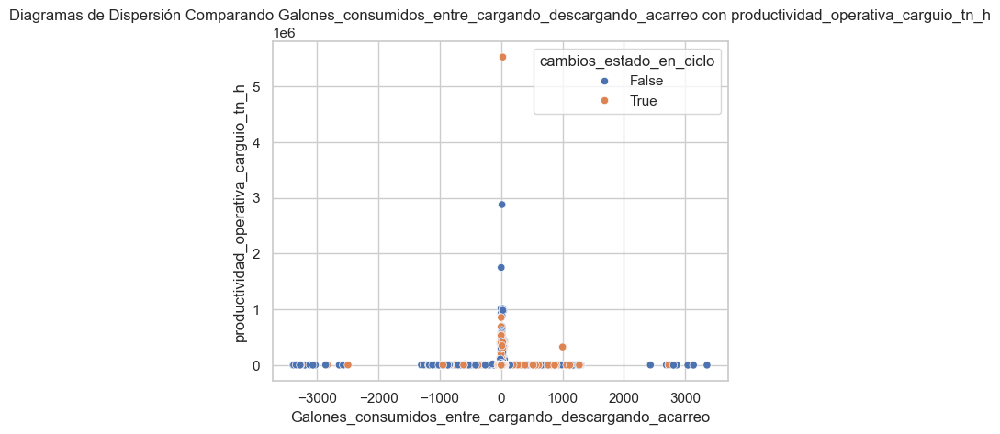

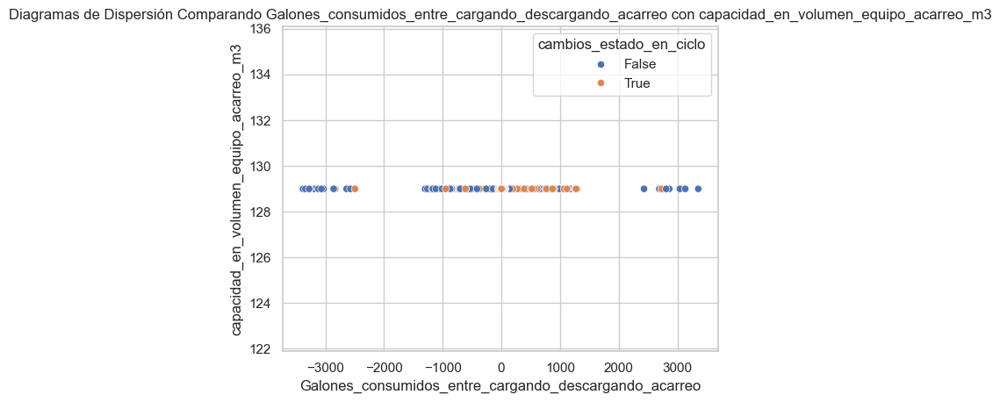

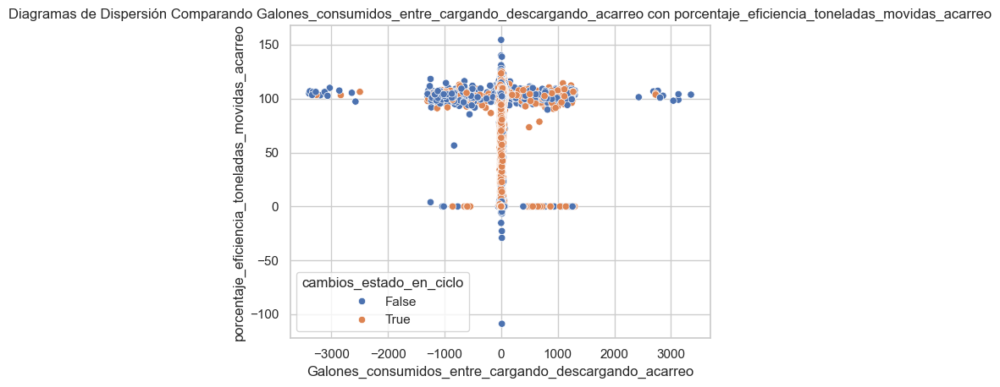

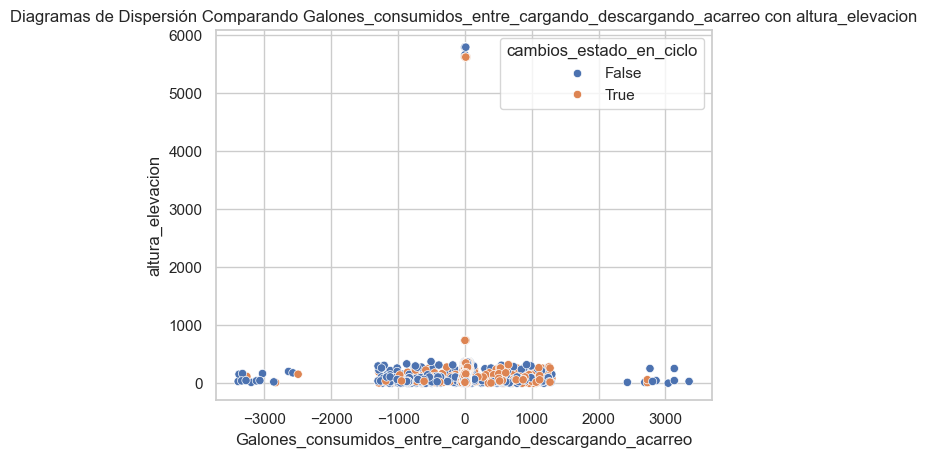

...

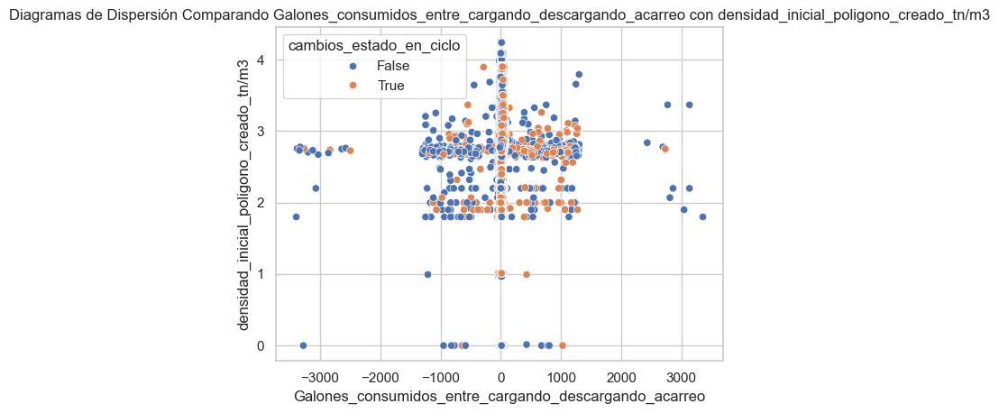

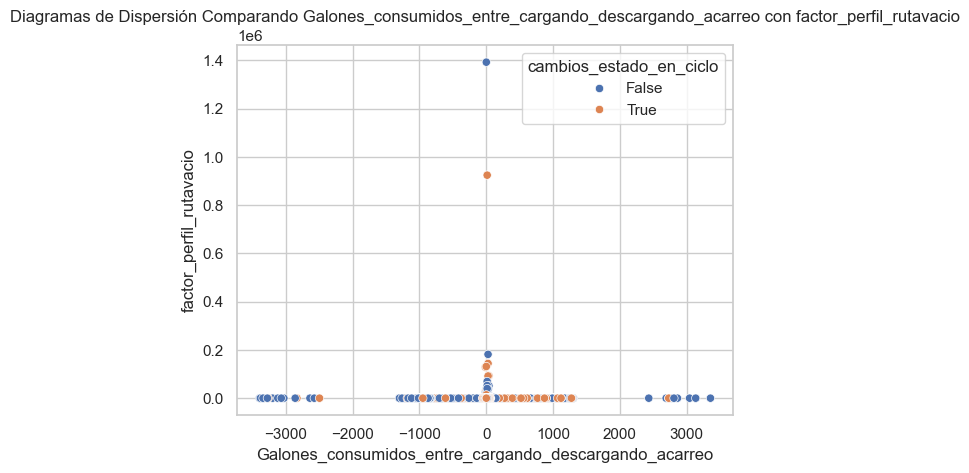

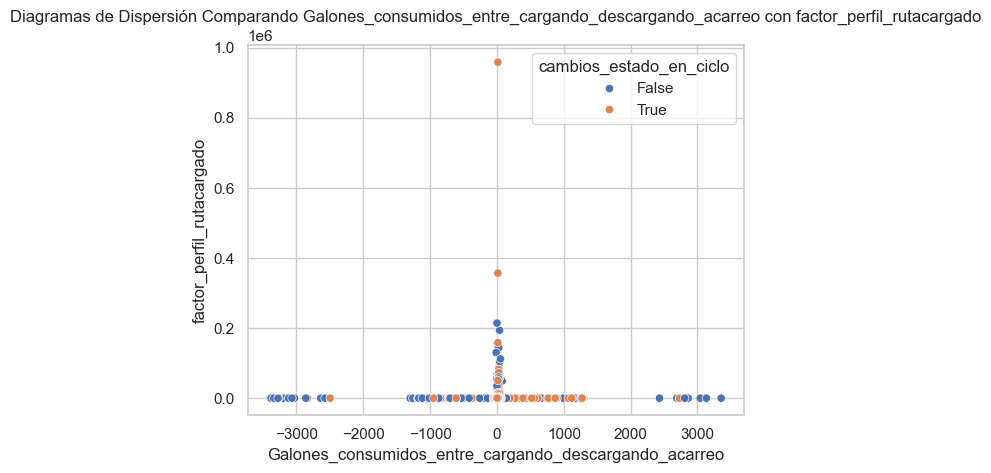

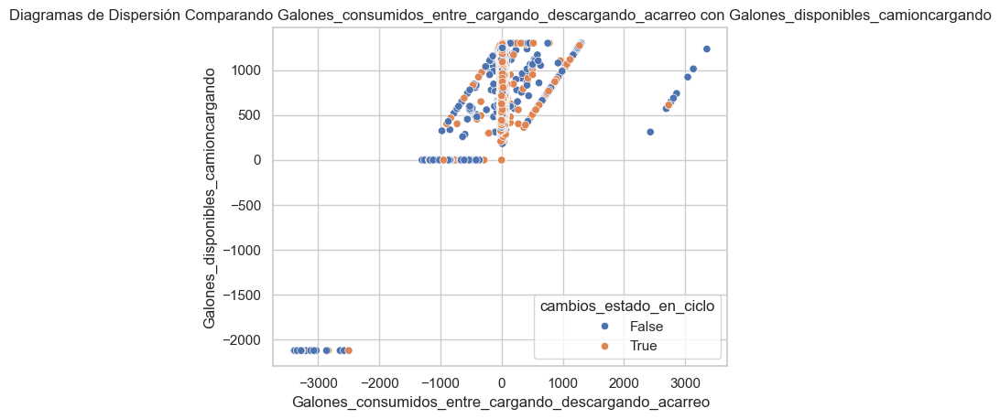

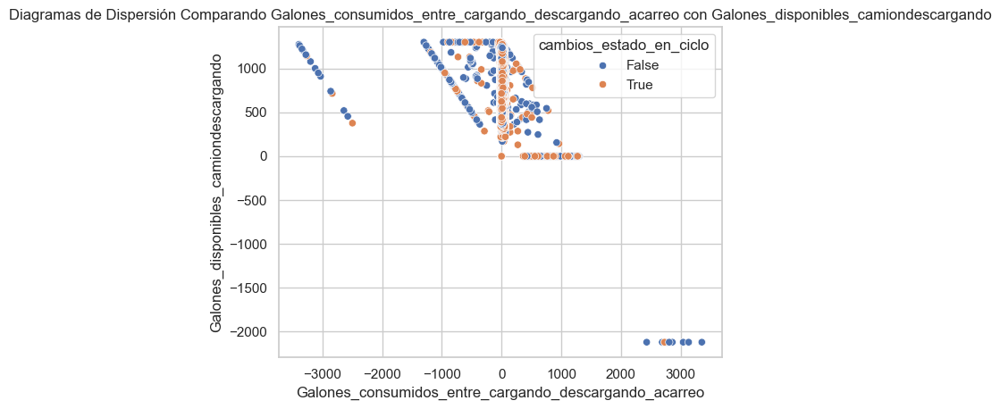

In [342]:
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'variable1', 'variable2', ..., 'variable5' son las otras variables que quieres comparar

variables_a_comparar = ['productividad_operativa_acarreo_tn_h', 'productividad_operativa_carguio_tn_h',
                     'capacidad_en_volumen_equipo_acarreo_m3','porcentaje_eficiencia_toneladas_movidas_acarreo', 'altura_elevacion', 
                     'promedio_velocidad_camioncargado_km/hr_gps','promedio_velocidad_camionvacio_km/hr_gps','densidad_inicial_poligono_creado_tn/m3', 'factor_perfil_rutavacio',
                     'factor_perfil_rutacargado', 'Galones_disponibles_camioncargando', 'Galones_disponibles_camiondescargando']
hue_variable = 'cambios_estado_en_ciclo'

# Configura el tamaño del gráfico
plt.figure(figsize=(12, 8))

# Itera sobre las variables y crea un gráfico de dispersión para cada una
for variable in variables_a_comparar:
    sns.scatterplot(data=datos, x='Galones_consumidos_entre_cargando_descargando_acarreo', y=variable, hue=hue_variable)

    # Agrega leyendas y título
    plt.legend(title=hue_variable)
    plt.title(f'Diagramas de Dispersión Comparando Galones_consumidos_entre_cargando_descargando_acarreo con {variable}')

    # Muestra el gráfico
    plt.show()

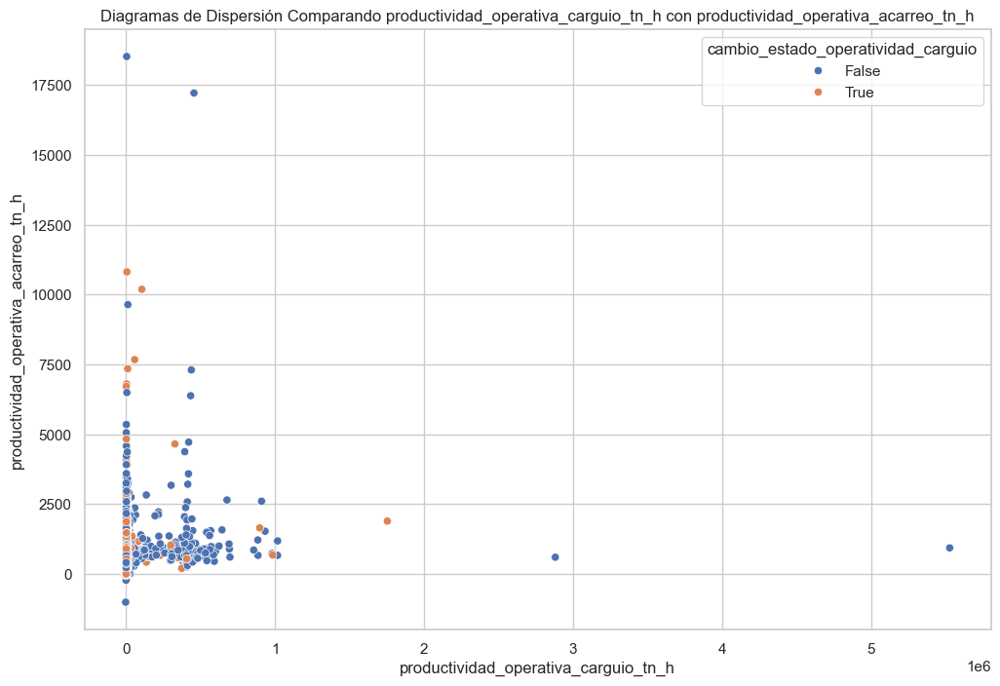

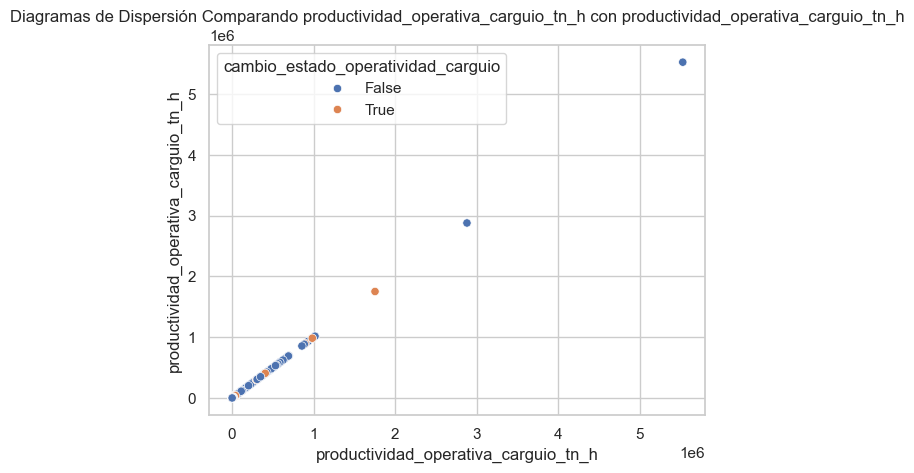

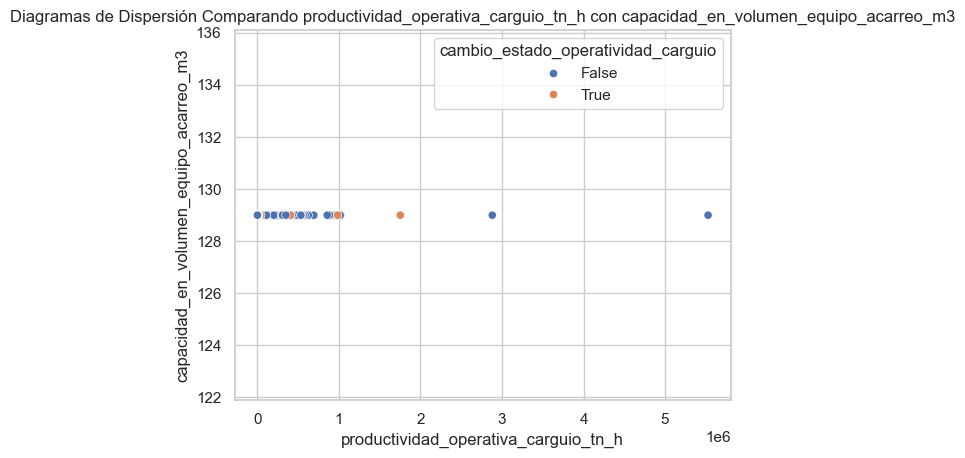

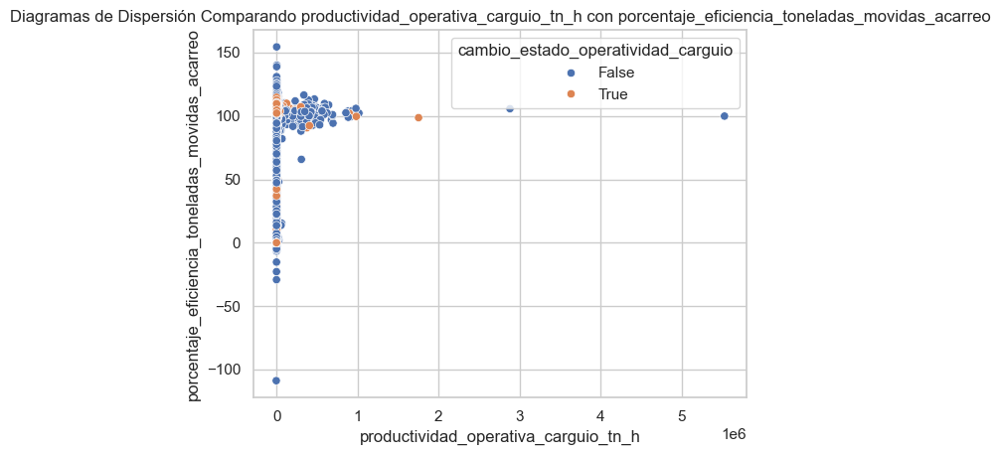

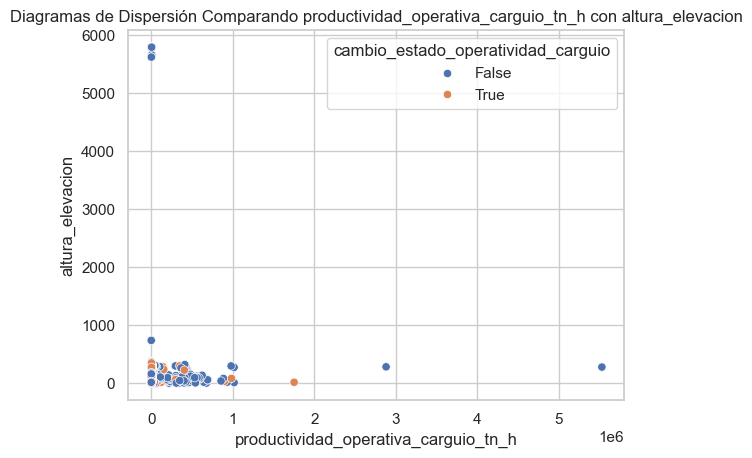

...

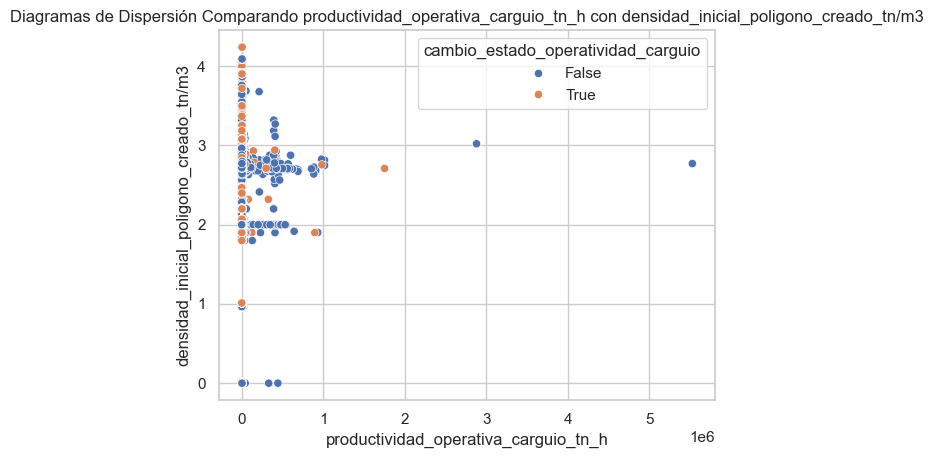

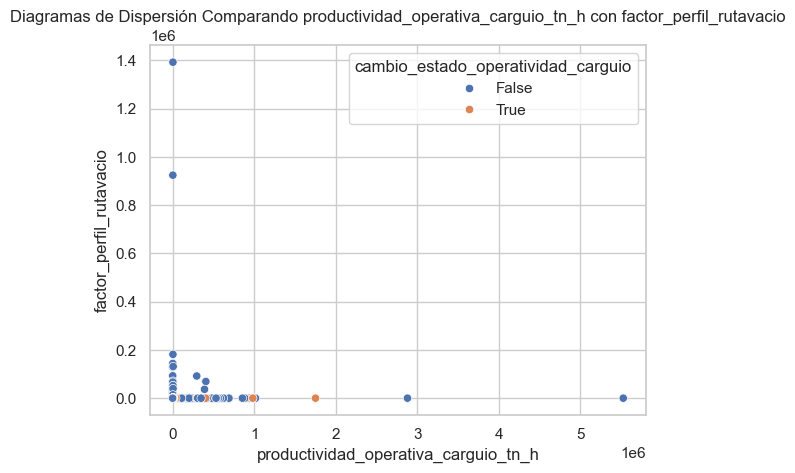

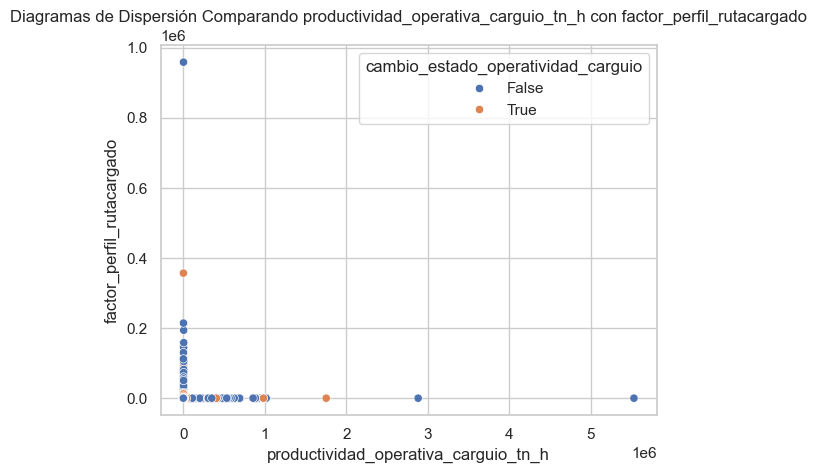

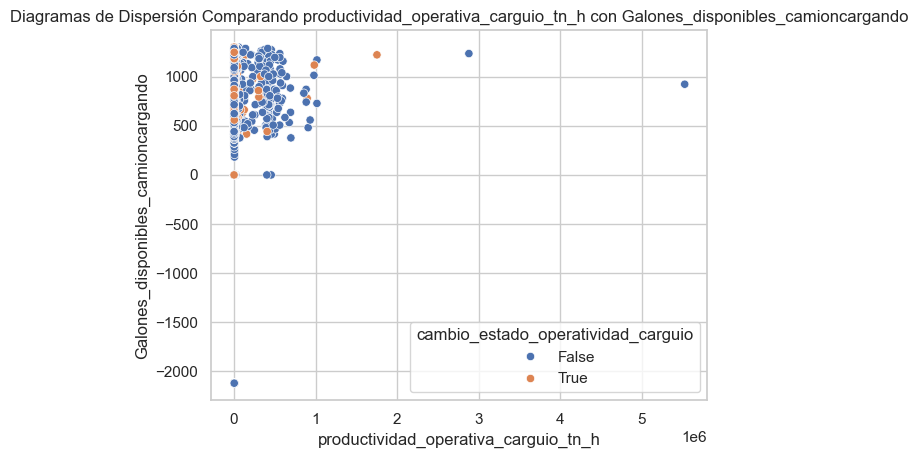

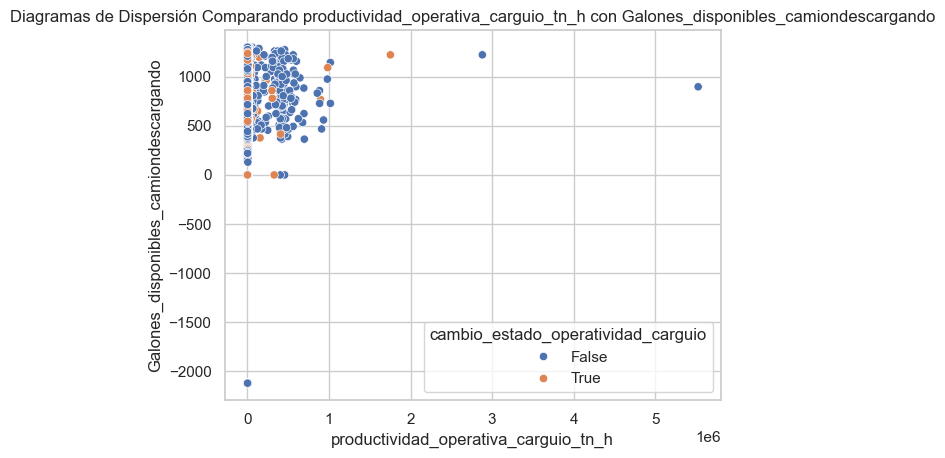

In [346]:
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'variable1', 'variable2', ..., 'variable5' son las otras variables que quieres comparar

variables_a_comparar = ['productividad_operativa_acarreo_tn_h', 'productividad_operativa_carguio_tn_h',
                     'capacidad_en_volumen_equipo_acarreo_m3','porcentaje_eficiencia_toneladas_movidas_acarreo', 'altura_elevacion', 
                     'promedio_velocidad_camioncargado_km/hr_gps','promedio_velocidad_camionvacio_km/hr_gps','densidad_inicial_poligono_creado_tn/m3', 'factor_perfil_rutavacio',
                     'factor_perfil_rutacargado', 'Galones_disponibles_camioncargando', 'Galones_disponibles_camiondescargando']
hue_variable = 'cambio_estado_operatividad_carguio'

# Configura el tamaño del gráfico
plt.figure(figsize=(12, 8))

# Itera sobre las variables y crea un gráfico de dispersión para cada una
for variable in variables_a_comparar:
    sns.scatterplot(data=datos, x='productividad_operativa_carguio_tn_h', y=variable, hue=hue_variable)

    # Agrega leyendas y título
    plt.legend(title=hue_variable)
    plt.title(f'Diagramas de Dispersión Comparando productividad_operativa_carguio_tn_h con {variable}')

    # Muestra el gráfico
    plt.show()

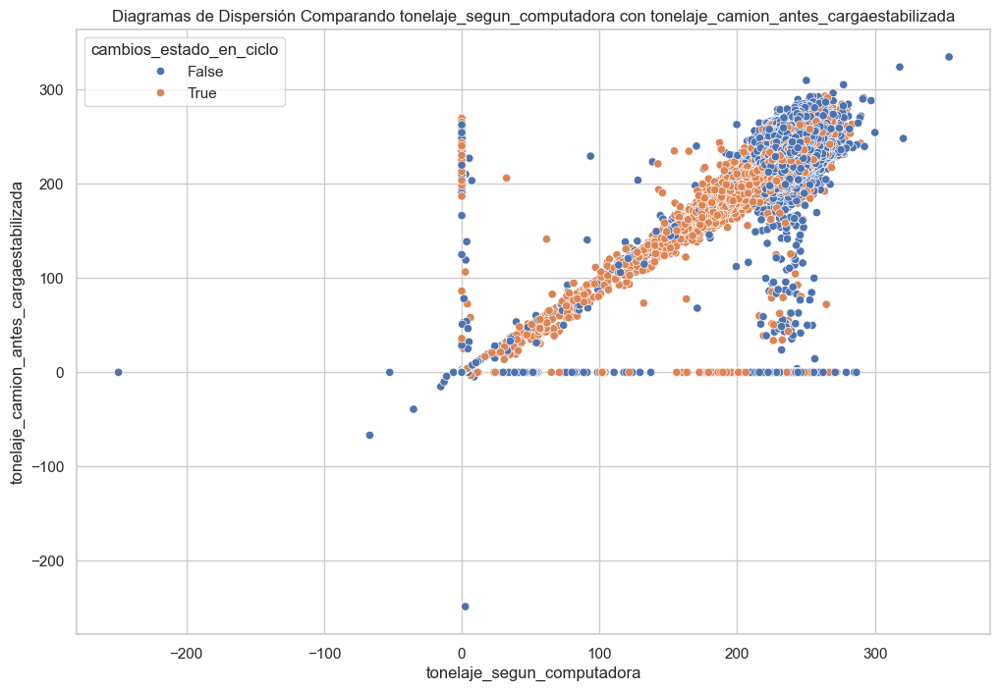

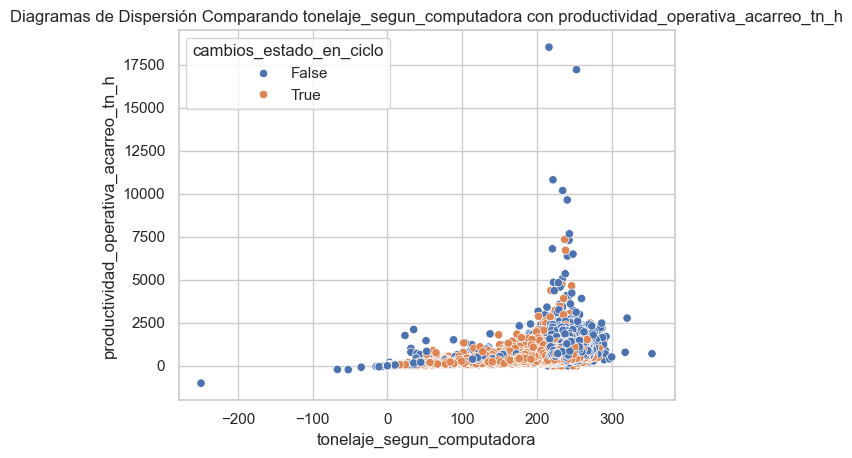

In [56]:
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'variable1', 'variable2', ..., 'variable5' son las otras variables que quieres comparar

variables_a_comparar = ['tonelaje_camion_antes_cargaestabilizada','productividad_operativa_acarreo_tn_h']
hue_variable = 'cambios_estado_en_ciclo'

# Configura el tamaño del gráfico
plt.figure(figsize=(12, 8))

# Itera sobre las variables y crea un gráfico de dispersión para cada una
for variable in variables_a_comparar:
    sns.scatterplot(data=datos, x='tonelaje_segun_computadora', y=variable, hue=hue_variable)

    # Agrega leyendas y título
    plt.legend(title=hue_variable)
    plt.title(f'Diagramas de Dispersión Comparando tonelaje_segun_computadora con {variable}')

    # Muestra el gráfico
    plt.show()

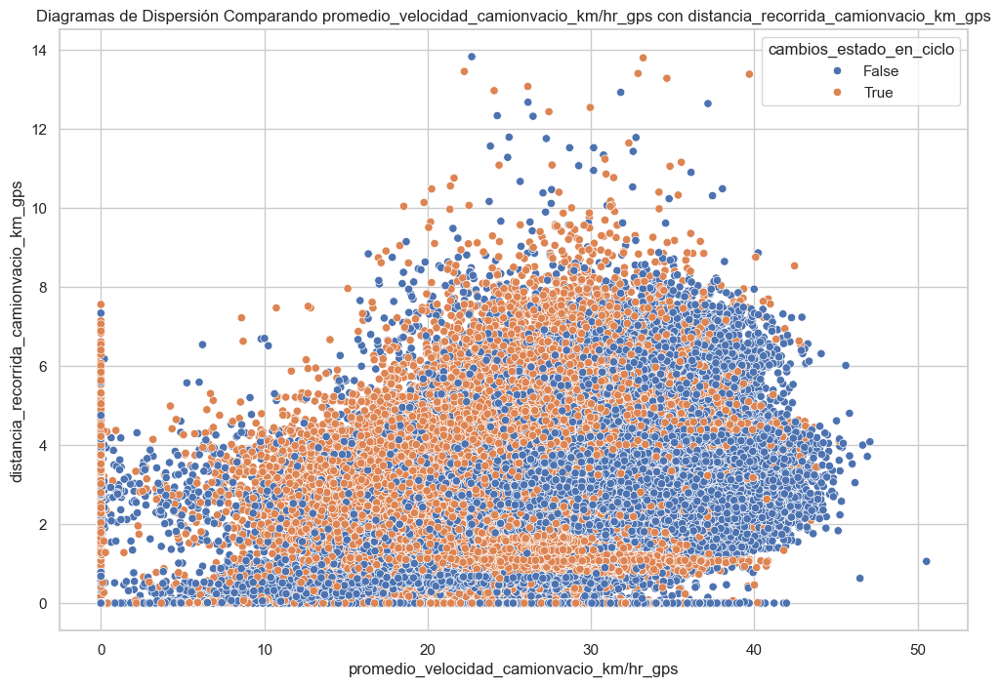

c:\Users\BryanInche-MS4M\Proyecto_MS4M_D4M\Plan_Trabajo_OptimizadorEstrategico_DS\Fase 2 - Comprension de Datos\envbryan\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


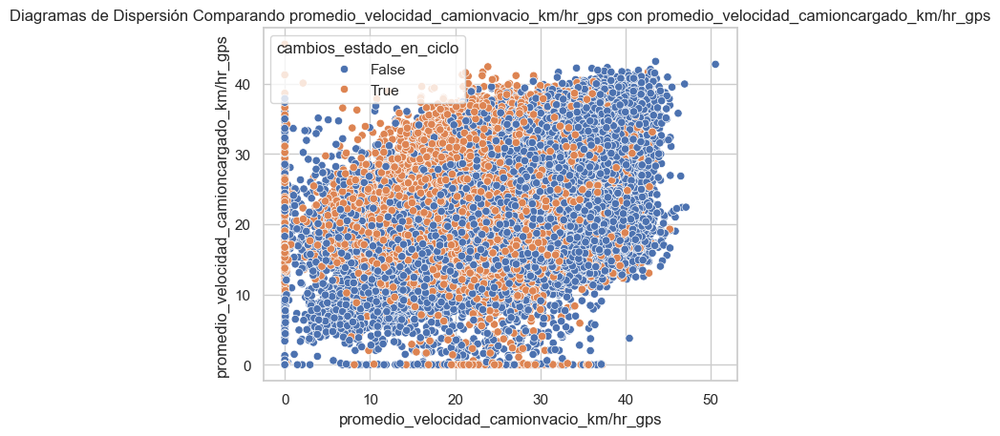

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'variable1', 'variable2', ..., 'variable5' son las otras variables que quieres comparar

variables_a_comparar = ['distancia_recorrida_camionvacio_km_gps', 'promedio_velocidad_camioncargado_km/hr_gps']
hue_variable = 'cambios_estado_en_ciclo'

# Configura el tamaño del gráfico
plt.figure(figsize=(12, 8))

# Itera sobre las variables y crea un gráfico de dispersión para cada una
for variable in variables_a_comparar:
    sns.scatterplot(data=datos, x='promedio_velocidad_camionvacio_km/hr_gps', y=variable, hue=hue_variable)

    # Agrega leyendas y título
    plt.legend(title=hue_variable)
    plt.title(f'Diagramas de Dispersión Comparando promedio_velocidad_camionvacio_km/hr_gps con {variable}')

    # Muestra el gráfico
    plt.show()

### *5.3 Coeficiente de Correlacion entre "Variable categorica" y Numericas*

In [84]:
from scipy.stats import pointbiserialr

# Obtén las columnas numéricas excluyendo aquellas que comienzan con 'id'
columnas_numericas = [col for col in datos.columns if col.startswith('id') is False and datos[col].dtype in ['int64', 'float64']]

# Almacena las correlaciones en un diccionario
correlaciones = {}

# Itera sobre las columnas numéricas y calcula la correlación punto biserial
for variable_numerica in columnas_numericas:
    if variable_numerica != 'cambios_estado_en_ciclo':  # Excluye la variable categórica de la comparación
        correlation, _ = pointbiserialr(datos['cambios_estado_en_ciclo'], datos[variable_numerica])
        correlaciones[variable_numerica] = correlation

# Crea una columna adicional con el valor absoluto de las correlaciones
datos['abs_correlacion'] = datos['cambios_estado_en_ciclo'].map(abs)

# Selecciona las 7 variables con los valores absolutos de las correlaciones más altos
top_7_variables = sorted(correlaciones, key=lambda x: abs(correlaciones[x]), reverse=True)[:7]

# Imprime las correlaciones de las 7 variables seleccionadas
for variable in top_7_variables:
    correlacion = correlaciones[variable]
    if pd.notna(correlacion):  # Omitir correlaciones nulas o nan
        print(f"Coeficiente de Correlación Punto Biserial para {variable}: {correlacion} (Valor absoluto: {abs(correlacion)})")

Coeficiente de Correlación Punto Biserial para distancia_recorrida_camionvacio_km: 0.3601488691980519 (Valor absoluto: 0.3601488691980519)
Coeficiente de Correlación Punto Biserial para promedio_velocidad_camionvacio_km/hr_gps: -0.23164981133113924 (Valor absoluto: 0.23164981133113924)
Coeficiente de Correlación Punto Biserial para productividad_operativa_acarreo_tn_h: -0.17889879304375736 (Valor absoluto: 0.17889879304375736)
Coeficiente de Correlación Punto Biserial para tiempo_ready_esperando_cuadra: 0.16396188252869937 (Valor absoluto: 0.16396188252869937)
Coeficiente de Correlación Punto Biserial para tiempo_ready_llegada_esperando: 0.14955442685963985 (Valor absoluto: 0.14955442685963985)
Coeficiente de Correlación Punto Biserial para distancia_recorrida_camionvacio_km_gps: 0.11949760899731436 (Valor absoluto: 0.11949760899731436)


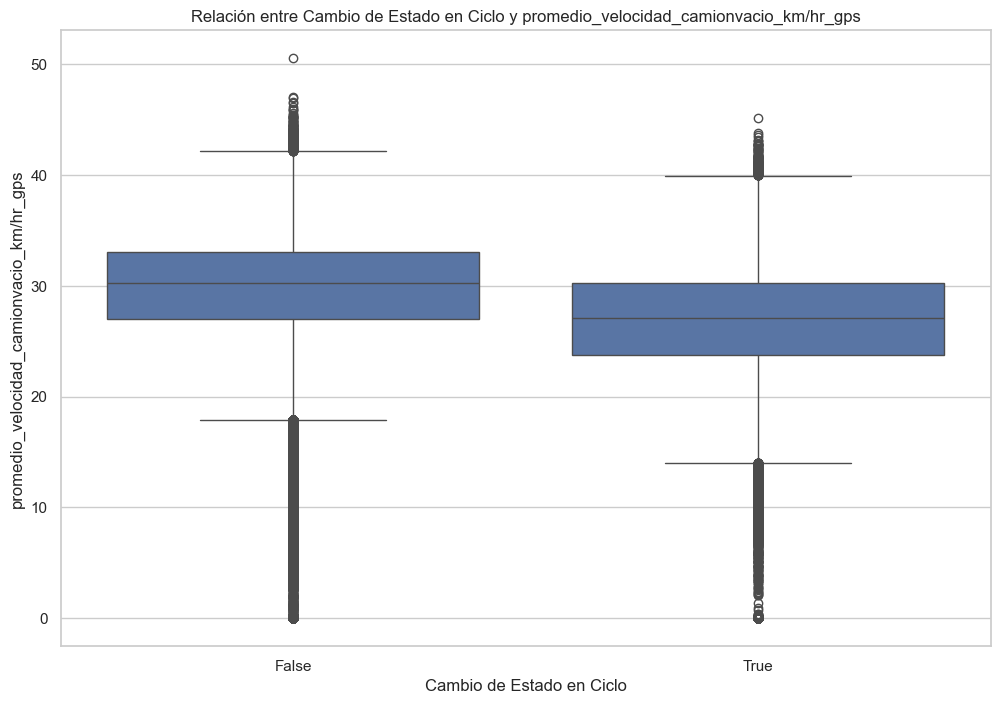

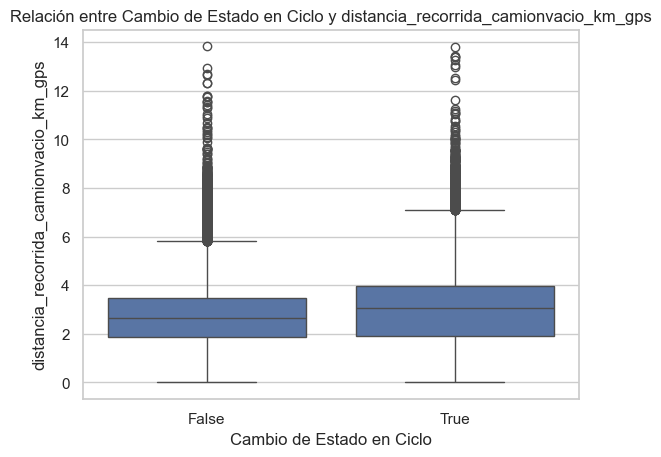

In [80]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de variables numéricas que deseas comparar
variables_numericas = ['promedio_velocidad_camionvacio_km/hr_gps', 'distancia_recorrida_camionvacio_km_gps']

# Configura el tamaño del gráfico
plt.figure(figsize=(12, 8))

# Itera sobre las variables y crea un gráfico de caja para cada una
for variable_numerica in variables_numericas:
    sns.boxplot(x='cambios_estado_en_ciclo', y=variable_numerica, data=datos)
    plt.xlabel('Cambio de Estado en Ciclo')
    plt.ylabel(variable_numerica)
    plt.title(f'Relación entre Cambio de Estado en Ciclo y {variable_numerica}')

    # Muestra el gráfico
    plt.show()

### *6. Seleccion de Variables con Analisis Estadistico*

*6.1. Seleccion Basada en Analisis de Varianza*

In [27]:
import pandas as pd

# Identificar las columnas numéricas y categóricas
columnas_numericas = datos.select_dtypes(include=['int', 'float']).columns

# Excluir las columnas que comienzan con 'id'
columnas_a_excluir = [col for col in datos.columns if col.startswith('id')]

# Filtrar las columnas numéricas que no están en columnas_a_excluir
columnas_a_incluir = [col for col in columnas_numericas if col not in columnas_a_excluir]

# Filtrar el DataFrame para incluir solo las columnas seleccionadas
datos_filtrados = datos[columnas_a_incluir]

# Calcular la desviación estándar de cada variable
desviaciones_estandar = datos_filtrados.std()

# Crear un DataFrame con los resultados y restablecer el índice
resultados = pd.DataFrame({'Variable': desviaciones_estandar.index, 'Desviación Estándar': desviaciones_estandar}).reset_index(drop=True)

# Ordenar el DataFrame por desviación estándar en orden descendente
resultados = resultados.sort_values(by='Desviación Estándar', ascending=False)

# Imprimir las variables y sus desviaciones estándar
print(resultados)

                                            Variable  Desviación Estándar
7                           coordenada_y_descarga_cm     104946538.470874
3                 distancia_recorrida_camionvacio_cm      88975708.560333
6                           coordenada_x_descarga_cm       6194564.760189
2               distancia_recorrida_camioncargado_cm        211567.310243
5             distancia_recorrida_camionvacio_cm_gps        109424.922826
4           distancia_recorrida_camioncargado_cm_gps        108133.857673
13    promedio_velocidad_camionvacio_km/hrx1000_comp         13519.797056
8                           coordenada_z_descarga_cm         10053.219704
20                                 nivel_descarga_cm          8130.667543
15     promedio_velocidad_camionvacio_km/hrx1000_gps          7798.648111
12  promedio_velocidad_camioncargado_km/hrx1000_comp          5848.017878
14   promedio_velocidad_camioncargado_km/hrx1000_gps          5767.730006
16           tonelaje_camion_antes_car